# SimCLR with Finetuning Classification Benchmarks

This notebook is part of the field boundary detection project. The goal is to evaluate the algorithm using 2D time series of the same h3 hex AND semi-supervised contrastive learning with Graph-based segmentation.

## Summary
[1. Data Processing](#data_processing)

[2. Model Training](#model_training)

[3. Report Generation](#report)

## Load required libraries

In [1]:
import sys

# Install packages required only once
install_packages = False

if install_packages:
    !{sys.executable} -m pip install sklearn
    !{sys.executable} -m pip install seaborn
    !{sys.executable} -m pip install utm
    !{sys.executable} -m pip install selenium

In [2]:
import math
import matplotlib.pyplot as plt
from matplotlib import pyplot

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from tensorflow.keras import layers

from sklearn.preprocessing import StandardScaler

import seaborn.objects as so
import seaborn as sns

import pandas as pd
import numpy as np

import folium
import h3
import uuid

import os

## Hyper-parameters and other constants

In [3]:
temporal_samples = 16
band_features = ['B01', 'B02', 'B03', 'B04', 'B05', 'B06', 'B07', 'B08', 'B8A', 'B09', 'B11', 'B12']
#band_features = ['B02', 'B03', 'B04'] #RGB
number_of_bands = len(band_features)

# Common Hyperparameters
width = 15
AUTOTUNE = tf.data.AUTOTUNE
shuffle_buffer = 50
num_epochs = 200
queue_size = 10000
kernel_size = 3
strides = 1


# SimCLR Hyperparameters
contrastive_augmentation = {"jitter": 0.3}
classification_augmentation = {"jitter": 0.1}
temperature = 0.1 # empirical temperature value
steps_per_epoch = 10


# Sample creation parameters
sampling_method = 'season' # 'shuffle', 'season' 
fills_sample_whentimeseries_navailable = False
train_only_on_accurate_samples = True

visualization_level = 3
# vl = 0 : No visuals at all
# vl = 1 : Just visuals that are proportional to results
# vl = 2 : Visuals that show results and maps
# vl = 3 : All visuals

generate_paper_info = True

folder = f'report_simclr_{width}_{temperature}_{sampling_method}\\'

try:
    os.mkdir(folder)
except Exception as e:
    print(e)
    print('Folder already exists')

<a id='data_processing'></a>

# 1. Data Processing

<div>
<img border="5px" src="../res/dataprocessing.png" width="1000"/>
</div>

## 1.1 Configure the train and test datasets

In [4]:
from pathlib import Path

positive_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\positive_samples\\hex_index_L3=8348b3fffffffff')
negative_samples_folder = Path('D:\\173_seeding_harvest_joined_USCA.parquet\\negative_samples\\hex_index_L3=8348b3fffffffff')

## 1.2 Load all parquet files from the configured folder

In [5]:
# load positive hexes
df_positive = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in positive_samples_folder.rglob('*.parquet')
         )

# load negative hexes
df_negative = pd.concat(
            pd.read_parquet(parquet_file)
            for parquet_file in negative_samples_folder.rglob('*.parquet'))

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

df_positive = df_positive.drop_duplicates()
df_negative = df_negative.drop_duplicates()

# create timestamp columns based on scene_id
df_positive['timestamp'] = df_positive.scene_id.str[11:26]
df_negative['timestamp'] = df_negative.scene_id.str[11:26]

print('The shape of loaded positive dataframe before dropping duplicates is:', df_positive.shape)
print('The shape of loaded negative dataframe before dropping duplicates is:', df_negative.shape)

display(df_positive.head(5))
display(df_negative.head(5))


The shape of loaded positive dataframe before dropping duplicates is: (98148, 19)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 19)
The shape of loaded positive dataframe before dropping duplicates is: (98148, 20)
The shape of loaded negative dataframe before dropping duplicates is: (74163, 20)


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c13ff,4,14RPQ,521.0,536.0,1036.0,634.0,1486.0,3316.0,3837.0,3984.0,4040.0,3963.0,2649.0,1518.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c17ff,4,14RPQ,521.0,537.0,1036.0,638.0,1504.0,3390.0,3843.0,3842.0,4074.0,3963.0,2607.0,1495.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c23ff,4,14RPQ,527.0,565.0,849.0,753.0,1390.0,2555.0,2796.0,2536.0,3128.0,3746.0,2583.0,1605.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c27ff,4,14RPQ,556.0,509.0,979.0,736.0,1462.0,2922.0,3187.0,3292.0,3500.0,3856.0,2598.0,1540.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c31ff,4,14RPQ,527.0,536.0,1011.0,660.0,1512.0,3284.0,3733.0,3654.0,3985.0,3746.0,2603.0,1538.0,20181029T170421


,start_date,end_date,FIELD_OPERATION_GUID,scene_id,hex,SCL_val,s2_tile,B01,B02,B03,B04,B05,B06,B07,B08,B8A,B09,B11,B12,timestamp
0,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c01ff,5,14RPQ,888.0,1034.0,1458.0,1546.0,1956.0,3277.0,3696.0,4004.0,3844.0,3662.0,3317.0,2241.0,20181029T170421
1,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c03ff,4,14RPQ,888.0,934.0,1272.0,1340.0,1669.0,2765.0,3081.0,2800.0,3364.0,3662.0,2883.0,1914.0,20181029T170421
2,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c05ff,4,14RPQ,888.0,1042.0,1458.0,1552.0,1903.0,3050.0,3344.0,3124.0,3636.0,3662.0,3379.0,2425.0,20181029T170421
3,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c07ff,4,14RPQ,888.0,956.0,1256.0,1370.0,1643.0,2492.0,2738.0,2832.0,3076.0,3662.0,2916.0,2007.0,20181029T170421
4,2018-10-27T00:00:00+00:00,2019-08-13T00:00:00+00:00,1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24,S2A_MSIL2A_20181029T170421_N0001_R069_T14RPQ_2...,8c48b3c444c0bff,4,14RPQ,760.0,916.0,1368.0,1090.0,1844.0,3406.0,3768.0,4232.0,4069.0,3958.0,3155.0,1978.0,20181029T170421


## 1.3 Unique fields in the dataset

In [6]:
print('The number of unique fields is: ', df_positive.FIELD_OPERATION_GUID.nunique())
print(df_positive.FIELD_OPERATION_GUID.unique())

The number of unique fields is:  17
<StringArray>
['1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24',
 '19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17',
 '48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16',
 '492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14',
 '8300721c-a085-4fc0-8520-763f1db45406 2019-02-23',
 '92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16',
 'ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16',
 'c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25',
 'c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25',
 'c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17',
 'ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24',
 'f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16',
 '2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24',
 '76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24',
 'a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02',
 '06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02',
 'a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02']
Length: 17, dtype: string


## 1.4 Remove hexes that are represented in both positive and negative datasets

In [7]:
# I could also just set it to "field" samples, since we know machine was in the 
# position but let's remove for the sake of class balacing

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

positive_l12_hexes = df_positive.hex.unique()
negative_l12_hexes = df_negative.hex.unique()

ambiguous_l12_hexes = set(positive_l12_hexes).intersection(negative_l12_hexes)
print('There are ', len(ambiguous_l12_hexes), ' hexes labeled both as positive and negative')

df_positive = df_positive[~df_positive['hex'].isin(ambiguous_l12_hexes)]
df_negative = df_negative[~df_negative['hex'].isin(ambiguous_l12_hexes)]

print('In this dataset there are ', df_positive.hex.unique().size, ' different positive hexes')
print('In this dataset there are ', df_negative.hex.unique().size, ' different negative hexes')

print('Total number of hexes:', df_positive.hex.unique().size + df_negative.hex.unique().size)

In this dataset there are  4939  different positive hexes
In this dataset there are  3772  different negative hexes
There are  184  hexes labeled both as positive and negative
In this dataset there are  4755  different positive hexes
In this dataset there are  3588  different negative hexes
Total number of hexes: 8343


There are hexes with temporal samples from 16 to 37


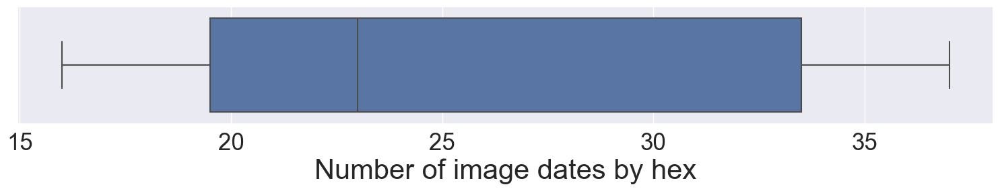

In [8]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(18.7,2.27)})

    temporal_samples_count = df_positive.groupby(['hex'])['hex'].count()

    print('There are hexes with temporal samples from', temporal_samples_count.min(), 'to', temporal_samples_count.max())

    hist = pd.DataFrame(temporal_samples_count) \
            .rename(columns={'hex': 'count'}) \
            .reset_index(level=0) \
            .groupby(['count'])['count'].count()

    hist_df = pd.DataFrame(hist) \
              .rename(columns={'count': 'frequency'}) \
              .reset_index(level=0)

    #so.Plot(hist_df["count"], hist_df["frequency"]) \
    #    .add(so.Bar()) \
    #    .scale(x=so.Continuous().tick(every=2)) \
    #    .layout(size=(10, 4))

    ax = sns.boxplot(x=hist_df["count"])

    ax.set_xlabel("Number of image dates by hex",fontsize=30)
    ax.tick_params(labelsize=25)

## Sentinel 2 bands
These are the 12 bands contained in the parque files and their respective meanings

<div>
<img src="../res/sentinel2-bands.png" width="500"/>
</div>

## 1.5 Show some of the L12 hexes loaded in the folium map

In [9]:
if train_only_on_accurate_samples:
    # Drop hexes from non-conclusive areas
    drop_list = np.loadtxt('drop_list.csv', delimiter=',', dtype='str')

    df_negative = df_negative[~df_negative['hex'].isin(drop_list)]
    df_positive = df_positive[~df_positive['hex'].isin(drop_list)]
    
    # Treat false negatives
    false_negatives = np.loadtxt('false_negatives.csv', delimiter=',', dtype='str')

    df_negative = df_negative.assign(label=0)
    df_positive = df_positive.assign(label=1)
    
    df_negative = df_negative.reset_index()
    df_positive = df_positive.reset_index()
    
    # Assign to negatives recognized as false the label 1
    df_negative.loc[df_negative['hex'].isin(false_negatives), 'label'] = 1

    df_positive = pd.concat([df_positive, df_negative[df_negative.label==1]])
    
    df_negative = df_negative.drop(df_negative[df_negative.label == 1].index)
    print('Training dataset on manually curated samples.')

Training dataset on manually curated samples.


In [10]:
if generate_paper_info:
    for index, f in enumerate(df_positive.FIELD_OPERATION_GUID.unique()):
        print('F{:02d}'.format(index+1) +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.nunique():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.nunique()}' +
              '&'+
              f'{df_positive[df_positive.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              f'{df_negative[df_negative.FIELD_OPERATION_GUID == f].hex.count():,}' +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().mean()) +
              '&'+
              '{:.2f}'.format(df_positive[df_positive.FIELD_OPERATION_GUID == f].groupby("hex").hex.count().std()) +
              '\\\\'
             )


F01&558&210&9,860&3,539&17.67&0.48\\
F02&734&151&14,242&2,863&19.40&0.74\\
F03&59&85&1,075&1,528&18.22&0.65\\
F04&350&150&8,326&3,518&23.79&0.48\\
F05&75&134&1,815&3,001&24.20&0.90\\
F06&288&60&4,999&1,044&17.36&0.68\\
F07&418&140&9,409&2,950&22.51&0.70\\
F08&425&154&8,584&3,084&20.20&0.82\\
F09&147&127&2,993&2,563&20.36&0.71\\
F10&369&176&6,973&3,194&18.90&0.40\\
F11&228&57&4,813&1,172&21.11&0.59\\
F12&91&96&1,701&1,738&18.69&0.53\\
F13&151&86&3,271&1,840&21.66&0.49\\
F14&275&216&4,871&3,825&17.71&0.46\\
F15&370&198&7,369&3,913&19.92&0.66\\
F16&271&25&5,030&413&18.56&0.69\\
F17&281&17&5,099&297&18.15&0.97\\


## 1.6 Display hexes in the map

In [11]:
import io
from PIL import Image

def display_hexes_map(df, hexes_to_print=5000, filename=None):

    h3_hex = h3.h3_to_parent(df.iloc[0]['hex'], 3)

    df = df.drop_duplicates(subset='hex', keep="first").head(hexes_to_print)
    
    min_lat, min_long = 9999999,9999999
    max_lat, max_long = -9999999,-9999999
    
    
    for h in df.hex:
        p = h3.h3_to_geo(h)
        
        if p[0] < min_lat:
            min_lat = p[0]
            
        if p[0] > max_lat:
            max_lat = p[0]
            
        if p[1] < min_long:
            min_long = p[1]
            
        if p[1] > max_long:
            max_long = p[1]
            
    bounds = [[min_lat, min_long], [max_lat, max_long]]
    print(bounds)

    m = folium.Map(
                    tiles = 'https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                    attr = 'Esri',
                    name = 'Esri Satellite',
                    zoom_start=11,
                    fit_bounds=[[-97.7198928194847,26.236073089251086],[-97.66473848550342,26.243580591892144]],
                    overlay = False,
                    control = True)

    # Print h3 hex
    geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=h3_hex,geo_json=True)]}
    geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'white', 'color': 'white', 'weight': 0.5})
    geo_j.add_to(m)

    # Print positive samples
    for index, row in df.iterrows():
        geometry = { "type" : "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row['hex'],geo_json=True)]}
        if row['label'] == 1:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'yellow', 'color': 'green', 'weight': 0.5})
        elif row['label'] == 0:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'red', 'color': 'black', 'weight': 0.5})
        else:
            geo_j = folium.GeoJson(data=geometry, style_function=lambda x: {'fillColor': 'black', 'color': 'black', 'weight': 0.5})
        folium.Popup(str(row['FIELD_OPERATION_GUID']) + ' ' + str(row['hex'])).add_to(geo_j)
        geo_j.add_to(m)


    m.fit_bounds(bounds)
    
    display(m)
    
    if filename is not None:
        img_data = m._to_png(5)
        img = Image.open(io.BytesIO(img_data))
        img.save(filename)

# 1.7 Visualize the samples in the space reduced to 2 dimensions

In [12]:
def generate_samples_season(dfp, dfn):

    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df['datetime'] = pd.to_datetime(df['timestamp'], format="%Y%m%dT%H%M%S")

    print('Number of total rows:' +  str(len(df.index)))
    print('Number of rows in positive dataset:' +  str(len(dfp.index)))
    print('Number of rows in negative dataset:' +  str(len(dfp.index)))
    print('Number of unique positive hexes:' +  str(dfp.hex.nunique()))
    print('Number of unique negative hexes:' +  str(dfn.hex.nunique()))


    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    band_values_tmp = np.zeros((temporal_samples*10, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    display(df.shape)

    
    for h in df.hex.unique():
        pct_complete = count/df.hex.nunique() * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1
        
        hexdf = df[df.hex == h]
        
        #display(hexdf)
        
        for index, row in hexdf.iterrows():
            # fill the band values in a temporal row
            for idx,b in enumerate(band_features):
                band_values_tmp[sub_index][idx] = row[b]    

            timestamp_sample.append(row.timestamp)

            # increment row number 
            sub_index = sub_index + 1


        try:
            debug = 'winter'
            timestamp_sample_aux = []
            winter_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 1 and int(s[4:6]) <= 3]
            winter_samples = np.random.choice(winter_samples, size=4)
            winter_array = np.array(band_values_tmp)[winter_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in winter_samples])

            debug = 'spring'
            spring_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 4 and int(s[4:6]) <= 6]
            spring_samples = np.random.choice(spring_samples, size=4)
            spring_array = np.array(band_values_tmp)[spring_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in spring_samples])

            debug = 'summer'
            summer_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 7 and int(s[4:6]) <= 9]
            summer_samples = np.random.choice(summer_samples, size=4)
            summer_array = np.array(band_values_tmp)[summer_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in summer_samples])

            debug = 'fall'
            fall_samples = [i for i, s in enumerate(timestamp_sample) if int(s[4:6]) >= 10 and int(s[4:6]) <= 12]
            fall_samples = np.random.choice(fall_samples, size=4)
            fall_array = np.array(band_values_tmp)[fall_samples]
            timestamp_sample_aux.extend([timestamp_sample[i] for i in fall_samples])

            timestamp_sample = timestamp_sample_aux

            sample = np.concatenate((winter_array, spring_array, summer_array, fall_array), axis=0)
        except Exception as e:
            print(debug, str(e))
            pass

        X_array = np.append(X_array, [sample], axis=0)
        labels.append(row.label)
        hexes.append(row.hex)
        fop.append(row.FIELD_OPERATION_GUID)
        timestamp_tracking.append(timestamp_sample.copy())            

        timestamp_sample.clear()
        sub_index = 0


    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])

    return df, X_array, labels, hexes, fop, timestamp_tracking


def generate_samples_shuffle(dfp, dfn):
    dfp = dfp.sort_values(by=['hex'])
    dfp = dfp.groupby('hex').head(temporal_samples)

    dfn = dfn.sort_values(by=['hex'])
    dfn = dfn.groupby('hex').head(temporal_samples)
    
    # Associate labels picked manually
    dfn = dfn.assign(label=0)
    dfp = dfp.assign(label=1)
    df = pd.concat([dfp, dfn], axis=0)

    df = df.reset_index()

    df[band_features] = StandardScaler().fit_transform(df[band_features])

    # Organize the 2D samples in numpy arrays
    sample = np.zeros((temporal_samples, number_of_bands), dtype=np.float64)
    X_array = np.empty((0, temporal_samples, number_of_bands),  dtype=np.float64)

    labels = []
    hexes = []
    fop = []
    timestamp_tracking = []
    timestamp_sample = []

    sub_index = 0
    count = 0;
    
    for index, row in df.iterrows():
        pct_complete = count/df.shape[0] * 100
        print('Sampling {0:.2f}'.format(pct_complete) + '%', end='\r')
        count = count + 1

        # fill the band values in a temporal row
        for idx,b in enumerate(band_features):
            sample[sub_index][idx] = row[b]

        timestamp_sample.append(row.timestamp)

        # increment row number 
        sub_index = sub_index + 1

        # if reached last row of temporal samples, increment to next sample
        if sub_index == temporal_samples:
            shuffler = np.random.permutation(sample.shape[0])
            sample = sample[shuffler]
            timestamp_sample = list(np.array(timestamp_sample)[shuffler])
                
            X_array = np.append(X_array, [sample], axis=0)
            labels.append(row.label)
            hexes.append(row.hex)
            fop.append(row.FIELD_OPERATION_GUID)
            timestamp_tracking.append(timestamp_sample.copy())            

            timestamp_sample.clear()
            sub_index = 0
            
    sorted_indices = np.argsort(hexes)
    hexes = np.array(hexes)[sorted_indices]
    labels = np.array(labels)[sorted_indices]
    X_array = X_array[sorted_indices]
    fop = np.array(fop)[sorted_indices]
    timestamp_tracking = np.array(timestamp_tracking)[sorted_indices]
    df = df.sort_values(by=['hex'])
    
    return df, X_array, labels, hexes, fop, timestamp_tracking


if sampling_method == 'season':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_season(df_positive, df_negative)
elif sampling_method == 'shuffle':
    df, X_array, labels, hexes, fop, timestamp_tracking = generate_samples_shuffle(df_positive, df_negative)
else:
    raise Exception('You need to select a sampling method')
    
print(X_array.shape)
print(len(labels))
print(len(hexes))

Number of total rows:140912
Number of rows in positive dataset:100430
Number of rows in negative dataset:100430
Number of unique positive hexes:5066
Number of unique negative hexes:2050


(140912, 24)

(7116, 16, 12)%
7116
7116


In [13]:
df_total = df.groupby(['FIELD_OPERATION_GUID'])['FIELD_OPERATION_GUID'].count()
df_unique = df.groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_nunique = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()
df_punique = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].nunique()

df_ncount = df[df.label==0].groupby(['FIELD_OPERATION_GUID'])['hex'].count()
df_pcount = df[df.label==1].groupby(['FIELD_OPERATION_GUID'])['hex'].count()

for i in range(0,17):
    print('F{:02d}&'.format(i+1) + '{:,}'.format(df_total[i]) + '&' + '{:,}'.format(df_pcount[i]) + '&' + 
          '{:,}'.format(df_ncount[i]) + '&' + '{:,}'.format(df_punique[i]) + '&' + '{:,}'.format(df_nunique[i]) +
          '&' + '{:.2f}'.format(df_total[i]/df_unique[i]) + '\\\\')

F01&5,443&5,030&413&271&25&18.39\\
F02&13,399&9,860&3,539&558&210&17.45\\
F03&17,105&14,242&2,863&734&151&19.33\\
F04&5,111&3,271&1,840&151&86&21.57\\
F05&2,603&1,075&1,528&59&85&18.08\\
F06&11,844&8,326&3,518&350&150&23.69\\
F07&8,696&4,871&3,825&275&216&17.71\\
F08&4,816&1,815&3,001&75&134&23.04\\
F09&6,043&4,999&1,044&288&60&17.36\\
F10&11,282&7,369&3,913&370&198&19.86\\
F11&5,396&5,099&297&281&17&18.11\\
F12&12,359&9,409&2,950&418&140&22.15\\
F13&11,668&8,584&3,084&425&154&20.15\\
F14&5,556&2,993&2,563&147&127&20.28\\
F15&10,167&6,973&3,194&369&176&18.66\\
F16&5,985&4,813&1,172&228&57&21.00\\
F17&3,439&1,701&1,738&91&96&18.39\\


## 1.8 TSNE Visualization BEFORE encoding

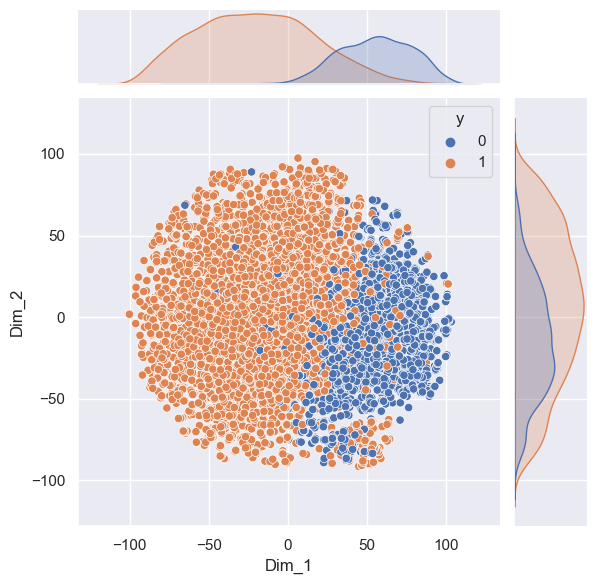

In [14]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings

if visualization_level > 2:
    warnings.filterwarnings('ignore')
    model = TSNE(n_components=2, perplexity=4, random_state=0)
    tsne_data = model.fit_transform(X_array.reshape(X_array.shape[0], number_of_bands * temporal_samples))
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))
    tsne_data = pd.concat([tsne_df, pd.DataFrame(labels, columns=['y'])], axis=1)
    tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2", "y"))

    sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
    plt.show()
    warnings.filterwarnings('default')

## 1.9 Sample visualization

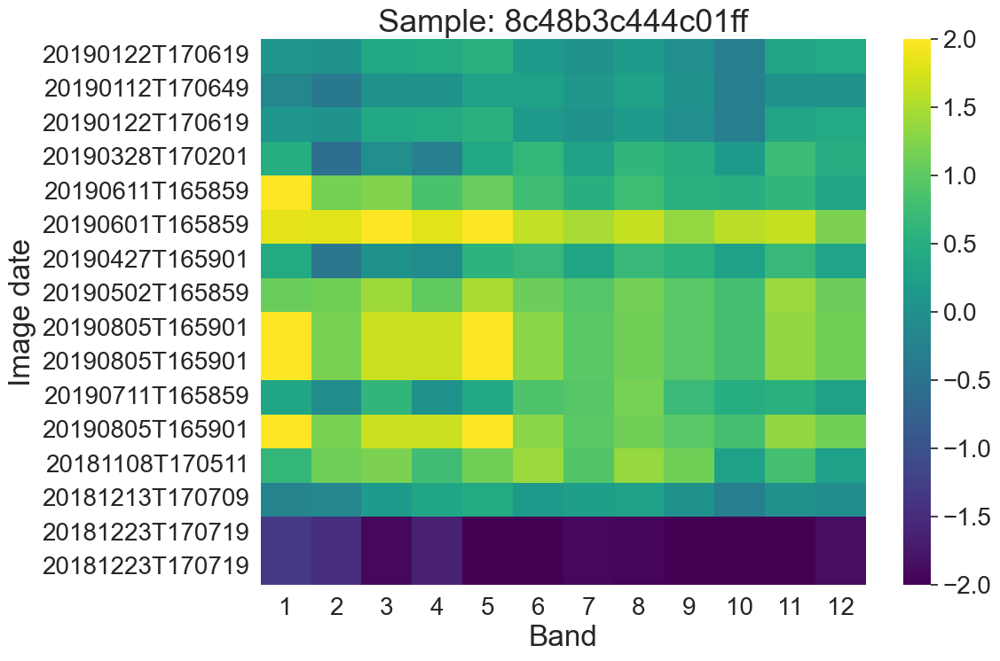

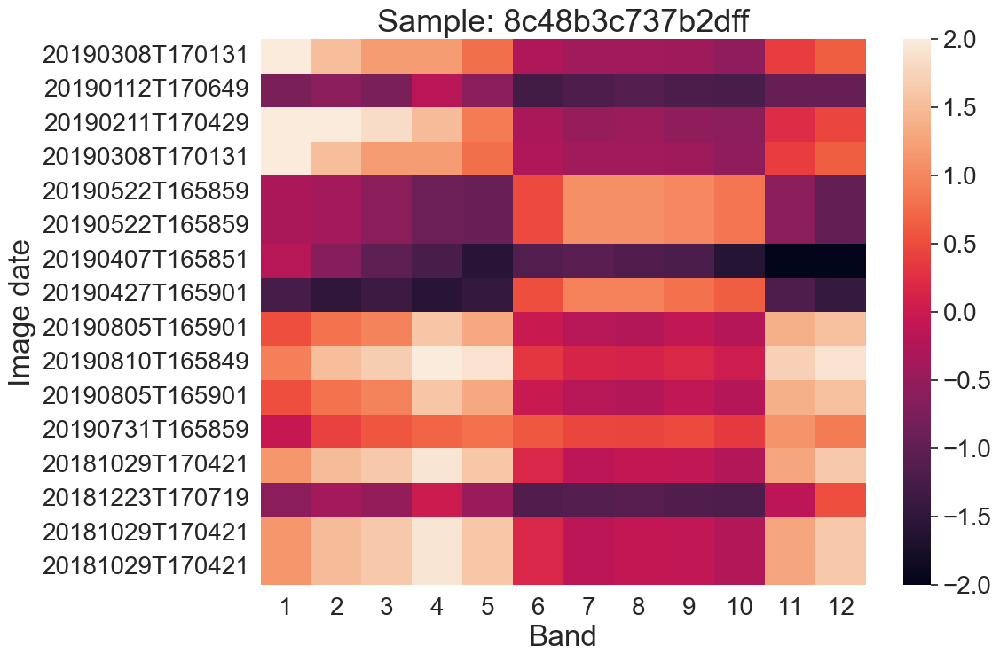

In [15]:
if visualization_level > 2:
    sns.set(rc={'figure.figsize':(11,8)})

    for i in range(0,1):
        # This is what a positive sample looks like
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="viridis", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":24}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()



    for i in range(-2,-1):
        xticklabels = range(1,13)
        yticklabels = range(1,16)
        yticklabels = timestamp_tracking[i]
        ax = sns.heatmap(X_array[i], annot=False, cmap="rocket", vmin=-2, vmax=2, 
                         xticklabels=xticklabels, yticklabels=yticklabels, 
                         fmt='g', annot_kws={"fontsize":20}, cbar=True)
        ax.set_xlabel("Band",fontsize=24)
        ax.set_ylabel("Image date",fontsize=24)
        ax.set_title('Sample: ' + hexes[i], fontsize=26)
        ax.tick_params(labelsize=20)

        cbar = ax.collections[0].colorbar
        cbar.ax.tick_params(labelsize=20)
        plt.show()

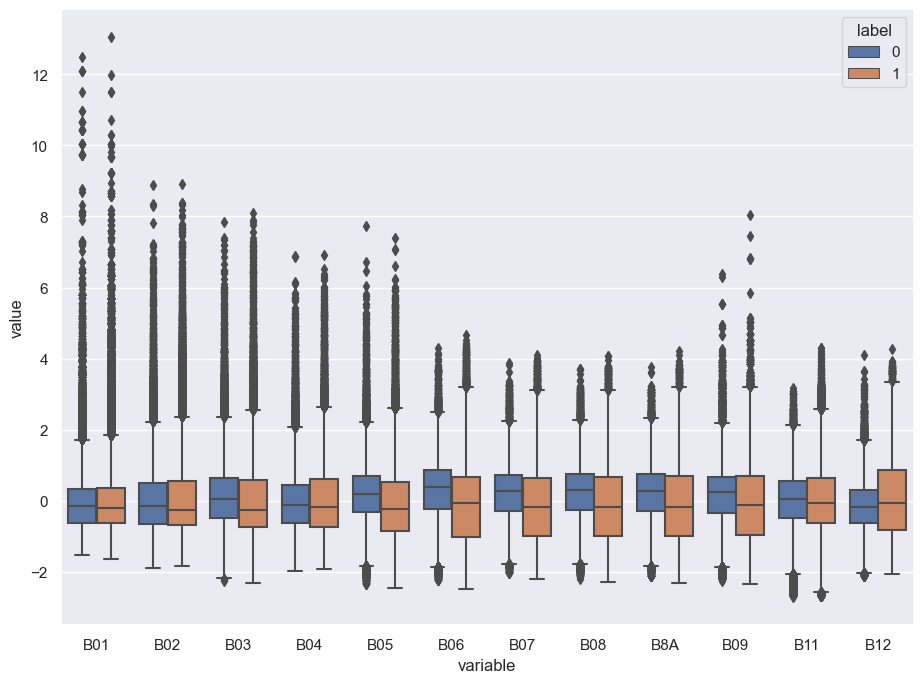

In [16]:
import pandas as pd
import seaborn as sns

if visualization_level > 2:
    value_vars = [i for i in df.columns if i.startswith('B')]
    id_vars = ['label']
    data = pd.melt(df, id_vars=id_vars, value_vars=value_vars)

    sns.set(rc={'figure.figsize':(11,8)})
    sns.boxplot(x="variable", y="value", hue='label', data=data)

# 1.10 Check correlation among bands

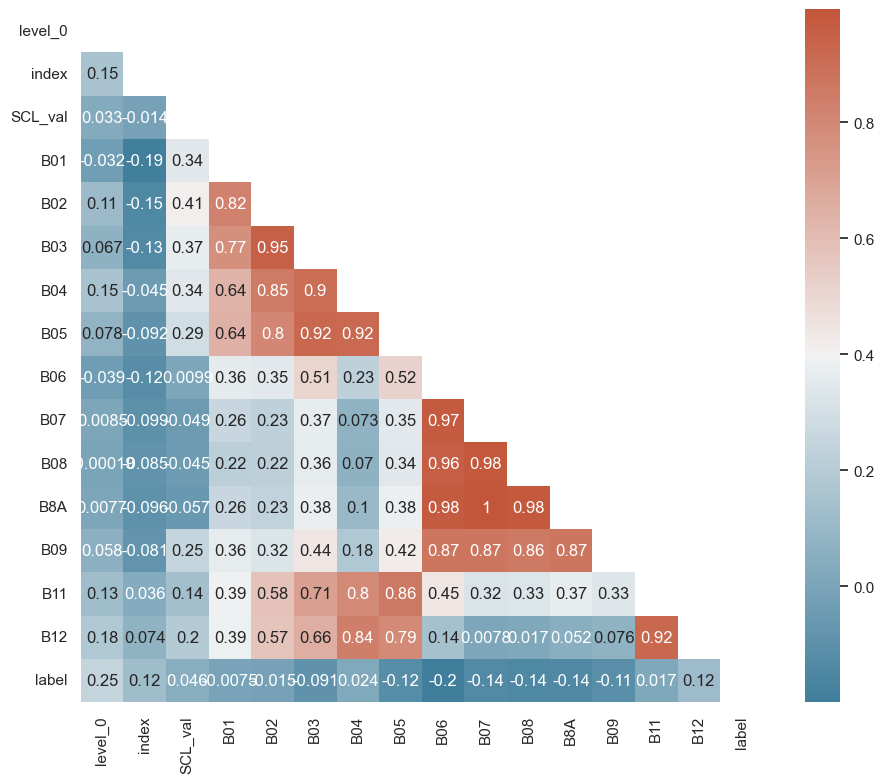

In [17]:
if visualization_level > 2:
    sns.set_theme(style="white")
    # Compute the correlation matrix
    corr = df.corr()

    # Generate a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(11, 9))

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(230, 20, as_cmap=True)
    sns.heatmap(corr,mask=mask,cmap=cmap, annot=True )

<a id='model_training'></a>

# 2. Contrastive Learning Model Training

<div>
<img border="5px" src="../res/modeltraining.png" width="1000"/>
</div>

## 2.1 Prepare the Dataset

In [18]:
#labels_and_hexes = np.vstack((hexes, labels)).T



#def prepare_training_dataset(test_index, val_index):
#
#    X_train = X_array[~(test_index + val_index)]
#   yl_train = labels_and_hexes[~(test_index + val_index)]
#    fop_train = fop[~(test_index + val_index)]
#    
#
#    X_test = X_array[test_index]
#    yl_test = labels_and_hexes[test_index]
#    fop_test = fop[test_index]

#    X_val = X_array[val_index]
#    yl_val = labels_and_hexes[val_index]
#    fop_val = fop[val_index]

#    hexes_train, y_train = np.hsplit(yl_train, 2)
#    hexes_test, y_test = np.hsplit(yl_test, 2)
#    hexes_val, y_val = np.hsplit(yl_val, 2)

#    y_val = np.array(y_val).T[0]
#    y_test = np.array(y_test).T[0]
#    y_train = np.array(y_train).T[0]
#    hexes_val = np.array(hexes_val).T[0]
#    hexes_test = np.array(hexes_test).T[0]
#    hexes_train = np.array(hexes_train).T[0]

#    y_train = y_train.astype(np.int)
#    y_test = y_test.astype(np.int)
#    y_val = y_val.astype(np.int)

#    print(X_train.shape, X_test.shape, X_val.shape)
#    return X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val
    
#X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val = prepare_training_dataset(test_index, val_index)



In [19]:
def prepare_dataset(test_index, val_index):   
    X_train = X_array[~(test_index + val_index)]
    y_train = labels[~(test_index + val_index)]
    hexes_train = hexes[~(test_index + val_index)]
    fop_train = fop[~(test_index + val_index)]
    
    X_test = X_array[test_index]
    y_test = labels[test_index]
    hexes_test = hexes[test_index]
    fop_test = fop[test_index]

    X_val = X_array[val_index]
    y_val = labels[val_index]
    hexes_val = hexes[val_index]
    fop_val = fop[val_index] 

    #y_train = y_train.astype(np.int)
    #y_test = y_test.astype(np.int)
    #y_val = y_val.astype(np.int)
    
    labeled_train_samples = X_train.shape[0]
    
    labeled_batch_size = labeled_train_samples // steps_per_epoch
    batch_size = labeled_batch_size
 
    train_dataset = tf.data.Dataset\
        .from_tensor_slices((X_train, y_train))\
        .shuffle(buffer_size=10 * labeled_batch_size)\
        .batch(labeled_batch_size)
    
    test_dataset = tf.data.Dataset\
        .from_tensor_slices((X_test, y_test))\
        .batch(batch_size)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    
    validation_dataset = tf.data.Dataset\
        .from_tensor_slices((X_val, y_val))\
        .batch(5)\
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    


    return batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test

    
field_index = 0
test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
    
test_index = np.array(fop) == test_field
val_index = np.array(fop) == val_field

batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test = prepare_dataset(test_index, val_index)

In [20]:
# Distorts the color distibutions of images
class RandomAugmentSatelliteBands(layers.Layer):
    def __init__(self, jitter=0, **kwargs):
        super().__init__(**kwargs)

        self.jitter = jitter

    def get_config(self):
        config = super().get_config()
        config.update({"jitter": self.jitter})
        return config

    def call(self, images, training=True):
        if training:
            batch_size = tf.shape(images)[0]
            
            
            # jitter colors
            jitter_matrices = tf.random.uniform(
                (batch_size, temporal_samples, 1), minval=1 - self.jitter, maxval=1 + self.jitter
            )
            
            jitter_matrices = tf.concat([jitter_matrices]*number_of_bands, axis=2)
            
            
            
            images = tf.round(images * jitter_matrices)
            
            # shuffle dates
            #images = tf.random.shuffle(tf.transpose(images, [1, 0, 2]))
            #images = tf.transpose(images, [1, 0, 2])
            
            
        return images

# Define the encoder architecture
def get_encoder():
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Conv1D(width, kernel_size=kernel_size, strides=strides, activation="relu"),
            layers.Flatten(),
            layers.Dense(width, activation="relu"),
        ],
        name="encoder",
    )

# Image augmentation module
def get_augmenter(jitter):
    return keras.Sequential(
        [
            keras.Input(shape=(temporal_samples, number_of_bands)),
            RandomAugmentSatelliteBands(jitter),
        ]
    )


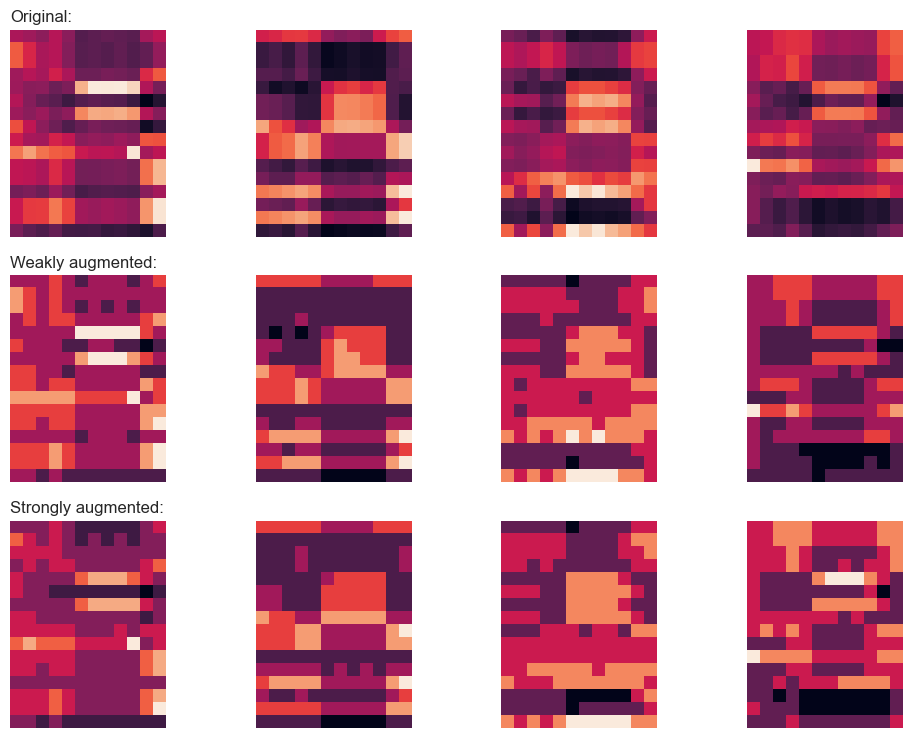

In [21]:
def visualize_augmentations(num_images):
    # Sample a batch from a dataset
    images = next(iter(train_dataset))[0][:num_images]

    # Apply augmentations
    augmented_images = zip(
        images,
        get_augmenter(**classification_augmentation)(images),
        get_augmenter(**contrastive_augmentation)(images),
    )
    row_titles = [
        "Original:",
        "Weakly augmented:",
        "Strongly augmented:",
    ]
    plt.figure(figsize=(num_images * 2.5, 4 * 2.5), dpi=100)
    for column, image_row in enumerate(augmented_images):
        for row, image in enumerate(image_row):
            plt.subplot(4, num_images, row * num_images + column + 1)
            plt.imshow(image)
            if column == 0:
                plt.title(row_titles[row], loc="left")
            plt.axis("off")
    plt.tight_layout()


visualize_augmentations(num_images=4)

In [22]:
# Baseline supervised training with random initialization
baseline_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        get_encoder(),
        layers.Dense(1, activation='sigmoid'),
    ],
    name="baseline_model",
)
baseline_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

baseline_history = baseline_model.fit(
    train_dataset, epochs=num_epochs, validation_data=validation_dataset
)

print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

Epoch 1/200
11/11 [==============================] - 1s 44ms/step - loss: 0.7423 - acc: 0.4627 - val_loss: 0.5697 - val_acc: 0.8734
Epoch 2/200
11/11 [==============================] - 0s 24ms/step - loss: 0.5590 - acc: 0.7099 - val_loss: 0.3495 - val_acc: 0.8520
Epoch 3/200
11/11 [==============================] - 0s 25ms/step - loss: 0.4348 - acc: 0.7150 - val_loss: 0.2272 - val_acc: 0.8881
Epoch 4/200
11/11 [==============================] - 0s 23ms/step - loss: 0.3298 - acc: 0.8468 - val_loss: 0.1591 - val_acc: 0.9288
Epoch 5/200
11/11 [==============================] - 0s 23ms/step - loss: 0.2736 - acc: 0.8971 - val_loss: 0.1302 - val_acc: 0.9458
Epoch 6/200
11/11 [==============================] - 0s 27ms/step - loss: 0.2427 - acc: 0.9035 - val_loss: 0.1189 - val_acc: 0.9638
Epoch 7/200
11/11 [==============================] - 0s 32ms/step - loss: 0.2041 - acc: 0.9200 - val_loss: 0.1201 - val_acc: 0.9661
Epoch 8/200
11/11 [==============================] - 0s 28ms/step - loss: 0.

11/11 [==============================] - 0s 26ms/step - loss: 0.0581 - acc: 0.9804 - val_loss: 0.1363 - val_acc: 0.9458
Epoch 63/200
11/11 [==============================] - 0s 28ms/step - loss: 0.0539 - acc: 0.9815 - val_loss: 0.1369 - val_acc: 0.9480
Epoch 64/200
11/11 [==============================] - 0s 26ms/step - loss: 0.0515 - acc: 0.9828 - val_loss: 0.1296 - val_acc: 0.9492
Epoch 65/200
11/11 [==============================] - 0s 27ms/step - loss: 0.0471 - acc: 0.9852 - val_loss: 0.1268 - val_acc: 0.9525
Epoch 66/200
11/11 [==============================] - 0s 27ms/step - loss: 0.0467 - acc: 0.9846 - val_loss: 0.1267 - val_acc: 0.9537
Epoch 67/200
11/11 [==============================] - 0s 26ms/step - loss: 0.0490 - acc: 0.9832 - val_loss: 0.1274 - val_acc: 0.9525
Epoch 68/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0462 - acc: 0.9852 - val_loss: 0.1257 - val_acc: 0.9548
Epoch 69/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0465 

11/11 [==============================] - 0s 22ms/step - loss: 0.0566 - acc: 0.9806 - val_loss: 0.1207 - val_acc: 0.9605
Epoch 124/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0506 - acc: 0.9830 - val_loss: 0.2102 - val_acc: 0.9401
Epoch 125/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0440 - acc: 0.9861 - val_loss: 0.1509 - val_acc: 0.9559
Epoch 126/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0403 - acc: 0.9865 - val_loss: 0.1395 - val_acc: 0.9582
Epoch 127/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0354 - acc: 0.9897 - val_loss: 0.1388 - val_acc: 0.9593
Epoch 128/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0339 - acc: 0.9892 - val_loss: 0.1389 - val_acc: 0.9582
Epoch 129/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0339 - acc: 0.9890 - val_loss: 0.1444 - val_acc: 0.9571
Epoch 130/200
11/11 [==============================] - 0s 18ms/step - loss: 

11/11 [==============================] - 0s 28ms/step - loss: 0.0363 - acc: 0.9868 - val_loss: 0.1271 - val_acc: 0.9729
Epoch 185/200
11/11 [==============================] - 0s 37ms/step - loss: 0.0258 - acc: 0.9916 - val_loss: 0.1961 - val_acc: 0.9446
Epoch 186/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0245 - acc: 0.9927 - val_loss: 0.1456 - val_acc: 0.9638
Epoch 187/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0217 - acc: 0.9936 - val_loss: 0.1616 - val_acc: 0.9514
Epoch 188/200
11/11 [==============================] - 0s 26ms/step - loss: 0.0216 - acc: 0.9938 - val_loss: 0.1413 - val_acc: 0.9650
Epoch 189/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0181 - acc: 0.9963 - val_loss: 0.1547 - val_acc: 0.9616
Epoch 190/200
11/11 [==============================] - 0s 30ms/step - loss: 0.0174 - acc: 0.9956 - val_loss: 0.1540 - val_acc: 0.9593
Epoch 191/200
11/11 [==============================] - 0s 27ms/step - loss: 

In [23]:
# Define the contrastive model with model-subclassing

class ContrastiveModel(keras.Model):
    def __init__(self):
        super().__init__()

        self.temperature = temperature
        self.contrastive_augmenter = get_augmenter(**contrastive_augmentation)
        self.classification_augmenter = get_augmenter(**classification_augmentation)
        self.encoder = get_encoder()

        
        # Non-linear MLP as projection head
        self.projection_head = keras.Sequential(
            [
                keras.Input(shape=(width,)),
                layers.Dense(width, activation="relu"),
                layers.Dense(width),
            ],
            name="projection_head",
        )
        # Single dense layer for linear probing
        self.linear_probe = keras.Sequential(
            [layers.Input(shape=(width,)), layers.Dense(1, activation='sigmoid')], name="linear_probe"
        )

        self.encoder.summary()
        self.projection_head.summary()
        self.linear_probe.summary()

    def compile(self, contrastive_optimizer, probe_optimizer, **kwargs):
        super().compile(**kwargs)

        self.contrastive_optimizer = contrastive_optimizer
        self.probe_optimizer = probe_optimizer

        # self.contrastive_loss will be defined as a method
        self.probe_loss = keras.losses.BinaryCrossentropy(from_logits=False)
        self.contrastive_loss_tracker = keras.metrics.Mean(name="c_loss")
        self.contrastive_accuracy = keras.metrics.BinaryAccuracy(name="c_acc")
        self.probe_loss_tracker = keras.metrics.Mean(name="p_loss")
        self.probe_accuracy = keras.metrics.BinaryAccuracy(name="p_acc")

    @property
    def metrics(self):
        return [
            self.contrastive_loss_tracker,
            self.contrastive_accuracy,
            self.probe_loss_tracker,
            self.probe_accuracy,
        ]

    def contrastive_loss(self, projections_1, projections_2):
        # InfoNCE loss (information noise-contrastive estimation)
        # NT-Xent loss (normalized temperature-scaled cross entropy)

        # Cosine similarity: the dot product of the l2-normalized feature vectors
        projections_1 = tf.math.l2_normalize(projections_1, axis=1)
        projections_2 = tf.math.l2_normalize(projections_2, axis=1)
        
        
        similarities = (
            tf.matmul(projections_1, projections_2, transpose_b=True) / self.temperature
        )        

        # The similarity between the representations of two augmented views of the
        # same hex should be higher than their similarity with other views
        batch_size = tf.shape(projections_1)[0]
    
        contrastive_labels = tf.range(batch_size)
        self.contrastive_accuracy.update_state(contrastive_labels, similarities)
        self.contrastive_accuracy.update_state(contrastive_labels, tf.transpose(similarities))

        # The temperature-scaled similarities are used as logits for cross-entropy
        # a symmetrized version of the loss is used here
        loss_1_2 = keras.losses.binary_crossentropy(
            contrastive_labels, similarities, from_logits=False
        )
        
        loss_2_1 = keras.losses.binary_crossentropy(
            contrastive_labels, tf.transpose(similarities), from_logits=False
        )
        
        
        return (loss_1_2 + loss_2_1) / 2

    def train_step(self, data):
        (labeled_images, labels) = data

        # Both labeled and unlabeled images are used, without labels
        images = labeled_images
        
        # Each image is augmented twice, differently
        augmented_images_1 = self.contrastive_augmenter(images, training=True)
        augmented_images_2 = self.contrastive_augmenter(images, training=True)
        
        with tf.GradientTape() as tape:
            features_1 = self.encoder(augmented_images_1, training=True)
            features_2 = self.encoder(augmented_images_2, training=True)
            # The representations are passed through a projection mlp
            projections_1 = self.projection_head(features_1, training=True)
            projections_2 = self.projection_head(features_2, training=True)
            contrastive_loss = self.contrastive_loss(projections_1, projections_2)
        gradients = tape.gradient(
            contrastive_loss,
            self.encoder.trainable_weights + self.projection_head.trainable_weights,
        )
        self.contrastive_optimizer.apply_gradients(
            zip(
                gradients,
                self.encoder.trainable_weights + self.projection_head.trainable_weights,
            )
        )
        self.contrastive_loss_tracker.update_state(contrastive_loss)

        # Labels are only used in evalutation for an on-the-fly logistic regression
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=True
        )
        with tf.GradientTape() as tape:
            # the encoder is used in inference mode here to avoid regularization
            # and updating the batch normalization paramers if they are used
            features = self.encoder(preprocessed_images, training=False)
            class_logits = self.linear_probe(features, training=True)
            probe_loss = self.probe_loss(labels, class_logits)
        gradients = tape.gradient(probe_loss, self.linear_probe.trainable_weights)
        self.probe_optimizer.apply_gradients(
            zip(gradients, self.linear_probe.trainable_weights)
        )
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        return {m.name: m.result() for m in self.metrics}

    def test_step(self, data):
        labeled_images, labels = data

        # For testing the components are used with a training=False flag
        preprocessed_images = self.classification_augmenter(
            labeled_images, training=False
        )
        features = self.encoder(preprocessed_images, training=False)
        class_logits = self.linear_probe(features, training=False)
        probe_loss = self.probe_loss(labels, class_logits)
        self.probe_loss_tracker.update_state(probe_loss)
        self.probe_accuracy.update_state(labels, class_logits)

        # Only the probe metrics are logged at test time
        return {m.name: m.result() for m in self.metrics[2:]}


# Contrastive pretraining
pretraining_model = ContrastiveModel()

pretraining_model.compile(
    contrastive_optimizer=keras.optimizers.Adam(),
    probe_optimizer=keras.optimizers.Adam(),
    run_eagerly=True
)

pretraining_history = pretraining_model.fit(
    train_dataset, epochs=num_epochs, validation_data=validation_dataset
)


print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_4 (Conv1D)            (None, 14, 15)            555       
_________________________________________________________________
conv1d_5 (Conv1D)            (None, 12, 15)            690       
_________________________________________________________________
conv1d_6 (Conv1D)            (None, 10, 15)            690       
_________________________________________________________________
conv1d_7 (Conv1D)            (None, 8, 15)             690       
_________________________________________________________________
flatten_1 (Flatten)          (None, 120)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 15)                1815      
Total params: 4,440
Trainable params: 4,440
Non-trainable params: 0
_________________________________________________________

11/11 [==============================] - 2s 177ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6253 - p_acc: 0.6883 - val_p_loss: 0.5172 - val_p_acc: 0.8294
Epoch 35/200
11/11 [==============================] - 2s 187ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6275 - p_acc: 0.6883 - val_p_loss: 0.5145 - val_p_acc: 0.8294
Epoch 36/200
11/11 [==============================] - 2s 223ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5950 - p_acc: 0.7184 - val_p_loss: 0.5119 - val_p_acc: 0.8294
Epoch 37/200
11/11 [==============================] - 3s 318ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6492 - p_acc: 0.6583 - val_p_loss: 0.5089 - val_p_acc: 0.8294
Epoch 38/200
11/11 [==============================] - 4s 347ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6407 - p_acc: 0.6583 - val_p_loss: 0.5081 - val_p_acc: 0.8294
Epoch 39/200
11/11 [==============================] - 3s 309ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6

Epoch 80/200
11/11 [==============================] - 4s 338ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.6051 - p_acc: 0.6590 - val_p_loss: 0.4516 - val_p_acc: 0.8294
Epoch 81/200
11/11 [==============================] - 3s 315ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5579 - p_acc: 0.7193 - val_p_loss: 0.4519 - val_p_acc: 0.8294
Epoch 82/200
11/11 [==============================] - 3s 318ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5991 - p_acc: 0.6886 - val_p_loss: 0.4501 - val_p_acc: 0.8294
Epoch 83/200
11/11 [==============================] - 4s 340ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5601 - p_acc: 0.7193 - val_p_loss: 0.4484 - val_p_acc: 0.8294
Epoch 84/200
11/11 [==============================] - 3s 313ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5669 - p_acc: 0.7193 - val_p_loss: 0.4460 - val_p_acc: 0.8294
Epoch 85/200
11/11 [==============================] - 4s 358ms/step - c_loss: -4160.6855 - c_acc: 0.0020 

11/11 [==============================] - 3s 318ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5355 - p_acc: 0.7228 - val_p_loss: 0.4056 - val_p_acc: 0.8350
Epoch 126/200
11/11 [==============================] - 4s 349ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5582 - p_acc: 0.6943 - val_p_loss: 0.4037 - val_p_acc: 0.8350
Epoch 127/200
11/11 [==============================] - 4s 339ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5508 - p_acc: 0.7236 - val_p_loss: 0.4022 - val_p_acc: 0.8350
Epoch 128/200
11/11 [==============================] - 2s 215ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5603 - p_acc: 0.6925 - val_p_loss: 0.4006 - val_p_acc: 0.8339
Epoch 129/200
11/11 [==============================] - 2s 210ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5259 - p_acc: 0.7239 - val_p_loss: 0.3995 - val_p_acc: 0.8350
Epoch 130/200
11/11 [==============================] - 2s 220ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss

11/11 [==============================] - 3s 257ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5176 - p_acc: 0.7339 - val_p_loss: 0.3690 - val_p_acc: 0.8497
Epoch 171/200
11/11 [==============================] - 2s 180ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5138 - p_acc: 0.7344 - val_p_loss: 0.3676 - val_p_acc: 0.8497
Epoch 172/200
11/11 [==============================] - 2s 190ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5602 - p_acc: 0.6735 - val_p_loss: 0.3665 - val_p_acc: 0.8497
Epoch 173/200
11/11 [==============================] - 2s 210ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5326 - p_acc: 0.7028 - val_p_loss: 0.3665 - val_p_acc: 0.8508
Epoch 174/200
11/11 [==============================] - 3s 242ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss: 0.5107 - p_acc: 0.7368 - val_p_loss: 0.3661 - val_p_acc: 0.8542
Epoch 175/200
11/11 [==============================] - 3s 294ms/step - c_loss: -4160.6855 - c_acc: 0.0020 - p_loss

# Encoding a few samples

In [24]:
# Encoder for validation
encoder_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
    ],
    name="encoder_model",
)

encoded_vectors = encoder_model.predict(X_test)

print(encoded_vectors.shape)


(768, 15)


# Visualization of the encoded samples in the XY space

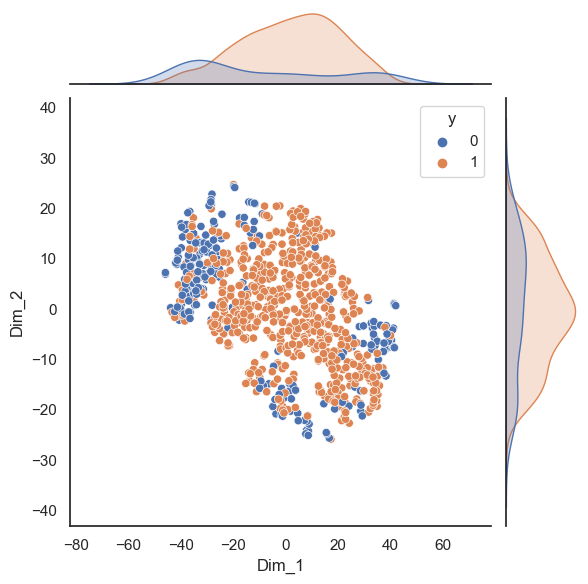

In [25]:
from sklearn.manifold import TSNE
import seaborn as sns
import warnings


warnings.filterwarnings('ignore')
model = TSNE(n_components=2, random_state=0)
tsne_data = model.fit_transform(encoded_vectors)
tsne_df = pd.DataFrame(data=tsne_data, columns=("Dim_1", "Dim_2"))

tsne_df = pd.concat([tsne_df, pd.DataFrame(y_test, columns=['y'])], axis=1)

sns.jointplot(data=tsne_df, x="Dim_1", y="Dim_2", hue='y')
plt.show()
warnings.filterwarnings('default')

## Finetuning model

In [26]:
# Supervised finetuning of the pretrained encoder
finetuning_model = keras.Sequential(
    [
        layers.Input(shape=(temporal_samples, number_of_bands)),
        get_augmenter(**classification_augmentation),
        pretraining_model.encoder,
        layers.Dense(1, activation='sigmoid'),
    ],
    name="finetuning_model",
)
finetuning_model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)

finetuning_history = finetuning_model.fit(
    train_dataset, epochs=num_epochs, validation_data=test_dataset
)
print(
    "Maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)

Epoch 1/200
11/11 [==============================] - 1s 34ms/step - loss: 0.5437 - acc: 0.6910 - val_loss: 0.4148 - val_acc: 0.7279
Epoch 2/200
11/11 [==============================] - 0s 12ms/step - loss: 0.4152 - acc: 0.7410 - val_loss: 0.2817 - val_acc: 0.8594
Epoch 3/200
11/11 [==============================] - 0s 13ms/step - loss: 0.3036 - acc: 0.8817 - val_loss: 0.2150 - val_acc: 0.8893
Epoch 4/200
11/11 [==============================] - 0s 14ms/step - loss: 0.2550 - acc: 0.8918 - val_loss: 0.1965 - val_acc: 0.9167
Epoch 5/200
11/11 [==============================] - 0s 12ms/step - loss: 0.2278 - acc: 0.9145 - val_loss: 0.2282 - val_acc: 0.8945
Epoch 6/200
11/11 [==============================] - 0s 17ms/step - loss: 0.1952 - acc: 0.9286 - val_loss: 0.2300 - val_acc: 0.9023
Epoch 7/200
11/11 [==============================] - 0s 15ms/step - loss: 0.1728 - acc: 0.9319 - val_loss: 0.2318 - val_acc: 0.9049
Epoch 8/200
11/11 [==============================] - 0s 13ms/step - loss: 0.

Epoch 63/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0582 - acc: 0.9800 - val_loss: 0.1461 - val_acc: 0.9531
Epoch 64/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0616 - acc: 0.9793 - val_loss: 0.1540 - val_acc: 0.9505
Epoch 65/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0587 - acc: 0.9799 - val_loss: 0.1470 - val_acc: 0.9518
Epoch 66/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0555 - acc: 0.9806 - val_loss: 0.1474 - val_acc: 0.9531
Epoch 67/200
11/11 [==============================] - 0s 7ms/step - loss: 0.0556 - acc: 0.9811 - val_loss: 0.1408 - val_acc: 0.9570
Epoch 68/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0560 - acc: 0.9815 - val_loss: 0.1421 - val_acc: 0.9557
Epoch 69/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0540 - acc: 0.9833 - val_loss: 0.1449 - val_acc: 0.9544
Epoch 70/200
11/11 [==============================] - 0s 9ms/step - loss: 0.

Epoch 125/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0337 - acc: 0.9897 - val_loss: 0.1598 - val_acc: 0.9492
Epoch 126/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0339 - acc: 0.9907 - val_loss: 0.1630 - val_acc: 0.9505
Epoch 127/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0342 - acc: 0.9903 - val_loss: 0.1658 - val_acc: 0.9505
Epoch 128/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0325 - acc: 0.9905 - val_loss: 0.1690 - val_acc: 0.9505
Epoch 129/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0335 - acc: 0.9899 - val_loss: 0.1662 - val_acc: 0.9492
Epoch 130/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0334 - acc: 0.9894 - val_loss: 0.1652 - val_acc: 0.9518
Epoch 131/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0312 - acc: 0.9914 - val_loss: 0.1646 - val_acc: 0.9518
Epoch 132/200
11/11 [==============================] - 0s 9ms/step - 

11/11 [==============================] - 0s 9ms/step - loss: 0.0351 - acc: 0.9890 - val_loss: 0.2006 - val_acc: 0.9518
Epoch 187/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0325 - acc: 0.9894 - val_loss: 0.1937 - val_acc: 0.9531
Epoch 188/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0283 - acc: 0.9923 - val_loss: 0.1920 - val_acc: 0.9518
Epoch 189/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0269 - acc: 0.9927 - val_loss: 0.1901 - val_acc: 0.9505
Epoch 190/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0272 - acc: 0.9918 - val_loss: 0.1950 - val_acc: 0.9518
Epoch 191/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0272 - acc: 0.9912 - val_loss: 0.1880 - val_acc: 0.9492
Epoch 192/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0269 - acc: 0.9916 - val_loss: 0.1909 - val_acc: 0.9518
Epoch 193/200
11/11 [==============================] - 0s 9ms/step - loss: 0.0246 -

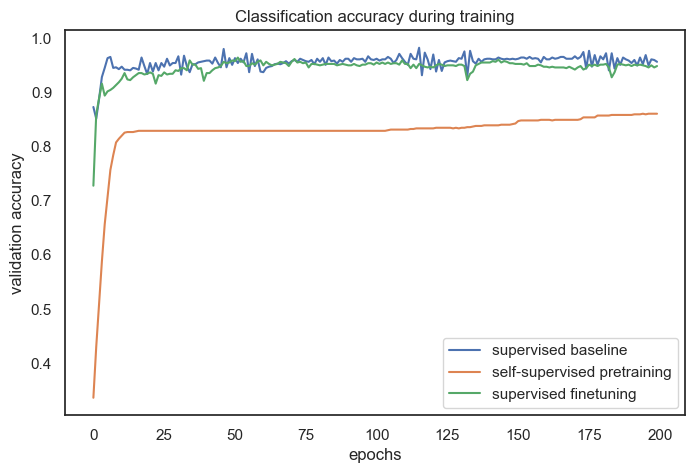

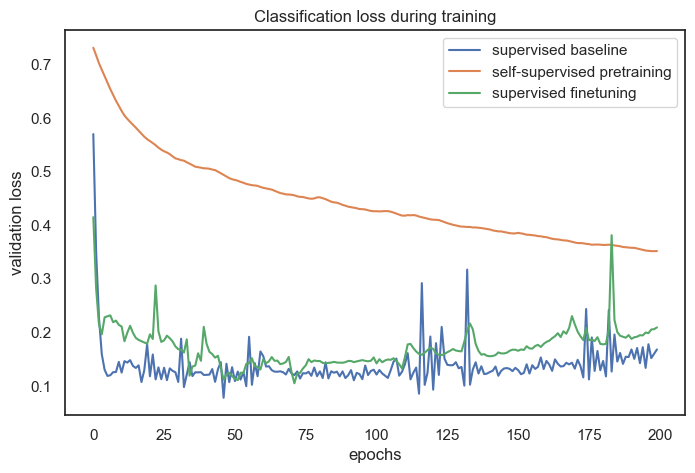

In [27]:
# The classification accuracies of the baseline and the pretraining + finetuning process:
def plot_training_curves(pretraining_history, finetuning_history, baseline_history):
    for metric_key, metric_name in zip(["acc", "loss"], ["accuracy", "loss"]):
        plt.figure(figsize=(8, 5), dpi=100)
        plt.plot(
            baseline_history.history[f"val_{metric_key}"], label="supervised baseline"
        )
        plt.plot(
            pretraining_history.history[f"val_p_{metric_key}"],
            label="self-supervised pretraining",
        )
        plt.plot(
            finetuning_history.history[f"val_{metric_key}"],
            label="supervised finetuning",
        )
        plt.legend()
        plt.title(f"Classification {metric_name} during training")
        plt.xlabel("epochs")
        plt.ylabel(f"validation {metric_name}")


plot_training_curves(pretraining_history, finetuning_history, baseline_history)

# Summary Results

In [28]:
from sklearn.metrics import accuracy_score, recall_score, precision_score,f1_score,matthews_corrcoef
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

print(
    "Baseline maximal validation accuracy: {:.2f}%".format(
        max(baseline_history.history["val_acc"]) * 100
    )
)

print(
    "Training maximal validation accuracy: {:.2f}%".format(
        max(pretraining_history.history["val_p_acc"]) * 100
    )
)

print(
    "Finetuning maximal validation accuracy: {:.2f}%".format(
        max(finetuning_history.history["val_acc"]) * 100
    )
)

print('---------------')


output = baseline_model.predict(test_dataset)
result_baseline = np.where(output > 0.5, 1, 0)
print('Baseline Accuracy: {:.2f}%'.format(accuracy_score(y_test, result_baseline) * 100))
print('Baseline Recall: {:.2f}%'.format(recall_score(y_test, result_baseline) * 100))
print('Baseline Precision: {:.2f}%'.format(precision_score(y_test, result_baseline) * 100))
print('Baseline F1: {:.2f}%'.format(f1_score(y_test, result_baseline) * 100))
m = confusion_matrix(y_test, result_baseline)
print('Baseline Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_test, result_baseline))
accuracy_list = (y_test==result_baseline.T[0])

print(
      '%.2f'  % (float(accuracy_score(y_test, result_baseline))*100) + '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result_baseline, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_test, result_baseline) + '\\\\',
     )

output = finetuning_model.predict(test_dataset)
result = np.where(output > 0.5, 1, 0)

print('Contrastive Accuracy: {:.2f}%'.format(accuracy_score(y_test, result) * 100))
print('Contrastive Recall: {:.2f}%'.format(recall_score(y_test, result) * 100))
print('Contrastive Precision: {:.2f}%'.format(precision_score(y_test, result) * 100))
print('Contrastive F1: {:.2f}%'.format(f1_score(y_test, result) * 100))
m = confusion_matrix(y_test, result)
print('Contrastive Acc by Class', (m.diagonal()/m.sum(axis=1)))
print(confusion_matrix(y_test, result))


print(
      '%.2f'  % (float(accuracy_score(y_test, result))*100) + '\\%&',
      '%.2f' % float(f1_score(y_test, result, average='weighted')*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result, average=None)[0]*100)+ '\\%&',
      '%.2f' % float(f1_score(y_test, result, average=None)[1]*100)+ '\\%&',
      '%.2f' % matthews_corrcoef(y_test, result) + '\\\\',
     )

Baseline maximal validation accuracy: 98.31%
Training maximal validation accuracy: 86.10%
Finetuning maximal validation accuracy: 96.48%
---------------
Baseline Accuracy: 94.14%
Baseline Recall: 95.34%
Baseline Precision: 96.55%
Baseline F1: 95.94%
Baseline Acc by Class [0.90952381 0.95340502]
[[191  19]
 [ 26 532]]
94.14\%& 94.17\%& 89.46\%& 95.94\%& 0.85\\
Contrastive Accuracy: 94.92%
Contrastive Recall: 96.24%
Contrastive Precision: 96.76%
Contrastive F1: 96.50%
Contrastive Acc by Class [0.91428571 0.96236559]
[[192  18]
 [ 21 537]]
94.92\%& 94.93\%& 90.78\%& 96.50\%& 0.87\\


In [29]:
# Test report
for i in range(0,len(df_positive.FIELD_OPERATION_GUID.unique())):
    
    tid = str(uuid.uuid4()).split('-')[0]
    
    description = 'Training with test on field ' + str(i) + ' and validation on field ' + str(i+1) + ' and test identifier ' + tid
    
    field_index = i
    test_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index]
    
    if field_index == (df_positive.FIELD_OPERATION_GUID.nunique()-1):
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[0]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + '0' + ' and test identifier ' + tid
    else:    
        val_field = df_positive.FIELD_OPERATION_GUID.unique()[field_index+1]
        description = 'Training with test on field ' + str(i) + ' and validation on field ' + str(i+1) + ' and test identifier ' + tid
            
    print('Test Field = ', test_field)
    print('Validation Field = ', val_field)
    
    test_index = np.array(fop) == test_field
    val_index = np.array(fop) == val_field
    print('The test field has number of hexes equals to ', sum(test_index))
    
    #X_train, y_train, hexes_train, fop_train, X_test, y_test, hexes_test, fop_test, X_val, y_val, hexes_val, fop_val = prepare_training_dataset(test_index, val_index)
    #labeled_train_samples = X_train.shape[0]
    
    batch_size, train_dataset, test_dataset, validation_dataset, X_test, y_test, hexes_test, fop_test = prepare_dataset(test_index, val_index)
    
    baseline_history = baseline_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    # Contrastive pretraining
    pretraining_model = ContrastiveModel()

    pretraining_model.compile(
        contrastive_optimizer=keras.optimizers.Adam(),
        probe_optimizer=keras.optimizers.Adam(),
        run_eagerly=False
    )

    pretraining_history = pretraining_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    finetuning_history = finetuning_model.fit(
        train_dataset, epochs=num_epochs, validation_data=validation_dataset
    )
    
    output = baseline_model.predict(test_dataset)
    result_baseline = np.where(output > 0.5, 1, 0)

    output = finetuning_model.predict(test_dataset)
    result = np.where(output > 0.5, 1, 0)
    m = confusion_matrix(y_test, result)
    
    # Generate actual image
    df_classes = pd.DataFrame(y_test, columns=['label'])
    df_hexes = pd.DataFrame(hexes_test, columns=['hex'])
    df_fop = pd.DataFrame(fop_test, columns=['FIELD_OPERATION_GUID'])

    df_actual = pd.concat([df_hexes,df_classes, df_fop], axis=1)

    display_hexes_map(df_actual, filename=folder + 'test_actual_' + tid + '.png')

    # Generate predicted simclr image
    df_classes = pd.DataFrame(result, columns=['label'])
    df_hexes = pd.DataFrame(hexes_test, columns=['hex'])
    df_fop = pd.DataFrame(fop_test, columns=['FIELD_OPERATION_GUID'])

    df_predict = pd.concat([df_hexes,df_classes, df_fop], axis=1)

    display_hexes_map(df_predict,filename=folder + 'test_predicted_' + tid + '.png')

    javascript = '<script> \
    function sortTable(n) { \
      var table, rows, switching, i, x, y, shouldSwitch, dir, switchcount = 0; \
      table = document.getElementById("myTable"); \
      switching = true; \
      dir = "asc"; \
      while (switching) { \
        switching = false; \
        rows = table.rows; \
        for (i = 2; i < (rows.length - 1); i++) { \
          shouldSwitch = false; \
          x = rows[i].getElementsByTagName("TD")[n]; \
          y = rows[i + 1].getElementsByTagName("TD")[n]; \
          if (dir == "asc") { \
            if (x.innerHTML.toLowerCase() > y.innerHTML.toLowerCase()) { \
              shouldSwitch = true; \
              break; \
            } \
    } else if (dir == "desc") { \
    if (x.innerHTML.toLowerCase() < y.innerHTML.toLowerCase()) { \
    shouldSwitch = true; \
              break; \
            } \
          } \
        } \
        if (shouldSwitch) { \
          rows[i].parentNode.insertBefore(rows[i + 1], rows[i]); \
          switching = true; \
          switchcount ++; \
        } else { \
          if (switchcount == 0 && dir == "asc") { \
            dir = "desc"; \
            switching = true; \
          } \
        } \
      } \
    } \
    function myFunction() { \
      var input, filter, table, tr, td, i, txtValue; \
      input = document.getElementById("myInput"); \
      filter = input.value.toUpperCase(); \
      table = document.getElementById("myTable"); \
      tr = table.getElementsByTagName("tr"); \
      var cols = document.getElementById("myTable").rows[1].cells.length;\
      var displayLine = 0; \
      strs = filter.split("|"); \
      for (row = 2; row < tr.length; row++) { \
        for (s = 0; s < strs.length; s++) { \
          for (c = 0; c < cols; c++) { \
            td = tr[row].getElementsByTagName("td")[c]; \
            if (td) { \
              txtValue = td.textContent || td.innerText; \
              console.log(strs[s]); \
              if (txtValue.toUpperCase().indexOf(strs[s]) > -1) { \
                displayLine = displayLine + 1; \
              } else { \
                displayLine = displayLine; \
              } \
            } \
          } \
        } \
        if(displayLine >= (strs.length)) { \
            tr[row].style.display = ""; \
          } \
          else { \
            tr[row].style.display = "none"; \
          } \
          displayLine = 0; \
      } \
    }\
    function zoom(e){\n\
      var zoomer = e.currentTarget;\n\
      e.offsetX ? offsetX = e.offsetX : offsetX = e.touches[0].pageX\n\
      e.offsetY ? offsetY = e.offsetY : offsetX = e.touches[0].pageX\n\
      x = offsetX/zoomer.offsetWidth*100\n\
      y = offsetY/zoomer.offsetHeight*100\n\
      zoomer.style.backgroundPosition = x + "% " + y + "%";\n\
    }\n\
    </script>'

    style = '<style>\
    * {\
      box-sizing: border-box;\
    }\
    .tooltip {\
      position: relative;\
      display: inline-block;\
      border-bottom: 1px dotted black;\
    }\
    .tooltip .tooltiptext {\
      visibility: hidden;\
      width: 240px;\
      background-color: black;\
      color: #fff;\
      text-align: center;\
      border-radius: 6px;\
      padding: 5px 0;\
      position: absolute;\
      z-index: 1;\
    }\
    .tooltip:hover .tooltiptext {\
      visibility: visible;\
    }\
    #myInput {\
      background-image: url("/css/searchicon.png");\
      background-position: 10px 10px;\
      background-repeat: no-repeat;\
      width: 100%;\
      font-size: 16px;\
      padding: 12px 20px 12px 40px;\
      border: 1px solid #ddd;\
      margin-bottom: 12px;\
    }\
    #myTable {\
      border-collapse: collapse;\
      width: 100%;\
      border: 1px solid #ddd;\
      font-size: 18px;\
    }\
    #myTable th, #myTable td {\
      text-align: left;\
      padding: 12px;\
    }\
    #myTable tr {\
      border-bottom: 1px solid #ddd;\
    }\
    #myTable tr.header{\
      background-color: #f1f1f1;\
      cursor: pointer;\
    }\
    #myTable tr:hover {\
      background-color: #f1f1f1;\
    }\
    figure.zoom {\
      background-position: 50% 50%;\
      position: relative;\
      width: 450px;\
      overflow: hidden;\
      cursor: zoom-in;\
    }\
    figure.zoom img:hover {\
      opacity: 0;\
    }\
    figure.zoom img {\
      transition: opacity 0.5s;\
      display: block;\
      width: 100%;\
      height: 100%;\
    }\
    </style>'

    import sys

    try:
        with open(folder + 'report.html', 'r') as file:
            table = file.read()
    except:
        table = ''
        table = '<html><head>'
        table += javascript
        table += '<meta name="viewport" content="width=device-width, initial-scale=1">'
        table += style
        table += '</head><body><h2>Search</h2>'
        table += '<input type="text" id="myInput" onkeyup="myFunction()" placeholder="Search for names.." title="Type in a name">'
        table += '<table border=1 id="myTable">\n'
        # Create the table's column headers
        table += '<tr>\n'
        table += '<th colspan=4>Parameters</th>\n'
        table += '<th colspan=1>Validation Results</th>'
        table += '<th colspan=1>Baseline</th>'
        table += '<th colspan=6>Test Results</th>'
        table += '</tr>\n'

        table += '<tr>\n'
        table += '<th href="javascript:void(0)" onclick="sortTable(0)"><div class="tooltip">Description<span class="tooltiptext">Experiment description</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(1)"><div class="tooltip">width<span class="tooltiptext">Width of encoded vector</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(2)"><div class="tooltip">sampling method<span class="tooltiptext">Method to create the sample matrix</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(3)"><div class="tooltip">Bands<span class="tooltiptext">Sentinel-2 bands utilized</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(4)"><div class="tooltip">Accuracy<span class="tooltiptext">Validation accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(5)"><div class="tooltip">Accuracy<span class="tooltiptext">Validation accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(6)"><div class="tooltip">Accuracy<span class="tooltiptext">Test accuracy</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(7)"><div class="tooltip">F1<span class="tooltiptext">F1 weighted</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(8)"><div class="tooltip">MCC<span class="tooltiptext">Matthews Correlation Coeficient</span></div></th>'
        table += '<th href="javascript:void(0)" onclick="sortTable(9)"><div class="tooltip">Confusion Matrix<span class="tooltiptext">Confusion Matrix</span></div></th>'
        table += '<th>Actual</th>'
        table += '<th>Predicted</th>'
        table += '</tr>\n'
        print('No report file found')


    fileout = open(folder + "report.html", "w")

    table += '<tr>\n'
    table += f'<td>{description}</td><td>{width}</td><td>{sampling_method}</td><td>{band_features}</td>'
    table += '<td>{:.2f}%</td>'.format(max(finetuning_history.history["val_acc"]) * 100)
    table += '<td>{:.2f}%</td>'.format(accuracy_score(y_test, result_baseline) * 100)
    table += '<td>%.2f'  % (float(accuracy_score(y_test, result))*100) + '% </td>'
    table += '<td>%.2f'  % float(f1_score(y_test, result, average='weighted')*100) + '% </td>'
    table += '<td>%.2f' % matthews_corrcoef(y_test, result)+ '</td>'
    table += '<td>' + str(m[0]) + '<br />' + str(m[1]) + '</td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_actual_{tid}.png)"> <img src="test_actual_{tid}.png" /> </figure></td>'
    table += f'<td><figure class="zoom" onmousemove="zoom(event)" style="background-image: url(test_predicted_{tid}.png)"> <img src="test_predicted_{tid}.png" /> </figure></td>'
    table += '</tr>\n'

    fileout.writelines(table)
    fileout.close()

Test Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
Validation Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
The test field has number of hexes equals to  768
Epoch 1/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0179 - acc: 0.9951 - val_loss: 0.1554 - val_acc: 0.9605
Epoch 2/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0160 - acc: 0.9962 - val_loss: 0.1680 - val_acc: 0.9548
Epoch 3/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0153 - acc: 0.9960 - val_loss: 0.1515 - val_acc: 0.9616
Epoch 4/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0160 - acc: 0.9958 - val_loss: 0.1735 - val_acc: 0.9559
Epoch 5/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0160 - acc: 0.9958 - val_loss: 0.1547 - val_acc: 0.9627
Epoch 6/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0152 - acc: 0.9960 - val_loss: 0.1782 - val_acc: 0.9548
Epoch 7/200
11/11 [=========

11/11 [==============================] - 0s 20ms/step - loss: 0.0125 - acc: 0.9960 - val_loss: 0.2205 - val_acc: 0.9492
Epoch 62/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0108 - acc: 0.9974 - val_loss: 0.3542 - val_acc: 0.9345
Epoch 63/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0788 - acc: 0.9749 - val_loss: 0.1458 - val_acc: 0.9751
Epoch 64/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0442 - acc: 0.9843 - val_loss: 0.3005 - val_acc: 0.9401
Epoch 65/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0238 - acc: 0.9914 - val_loss: 0.1785 - val_acc: 0.9616
Epoch 66/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0166 - acc: 0.9945 - val_loss: 0.2345 - val_acc: 0.9446
Epoch 67/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0176 - acc: 0.9945 - val_loss: 0.1931 - val_acc: 0.9582
Epoch 68/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0146 

11/11 [==============================] - 0s 20ms/step - loss: 0.0113 - acc: 0.9965 - val_loss: 0.1687 - val_acc: 0.9740
Epoch 123/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0071 - acc: 0.9976 - val_loss: 0.2761 - val_acc: 0.9492
Epoch 124/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0073 - acc: 0.9974 - val_loss: 0.1890 - val_acc: 0.9684
Epoch 125/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0062 - acc: 0.9985 - val_loss: 0.2572 - val_acc: 0.9525
Epoch 126/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0056 - acc: 0.9987 - val_loss: 0.2282 - val_acc: 0.9559
Epoch 127/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0066 - acc: 0.9982 - val_loss: 0.2246 - val_acc: 0.9672
Epoch 128/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0082 - acc: 0.9973 - val_loss: 0.2806 - val_acc: 0.9514
Epoch 129/200
11/11 [==============================] - 0s 22ms/step - loss: 

11/11 [==============================] - 0s 19ms/step - loss: 0.0037 - acc: 0.9991 - val_loss: 0.2611 - val_acc: 0.9571
Epoch 184/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0041 - acc: 0.9991 - val_loss: 0.2708 - val_acc: 0.9559
Epoch 185/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0037 - acc: 0.9989 - val_loss: 0.2463 - val_acc: 0.9616
Epoch 186/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0037 - acc: 0.9993 - val_loss: 0.2481 - val_acc: 0.9638
Epoch 187/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0035 - acc: 0.9993 - val_loss: 0.2605 - val_acc: 0.9593
Epoch 188/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0036 - acc: 0.9995 - val_loss: 0.2571 - val_acc: 0.9605
Epoch 189/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0032 - acc: 0.9993 - val_loss: 0.2631 - val_acc: 0.9593
Epoch 190/200
11/11 [==============================] - 0s 23ms/step - loss: 

11/11 [==============================] - 0s 35ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6437 - p_acc: 0.7115 - val_p_loss: 0.6087 - val_p_acc: 0.8294
Epoch 22/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6472 - p_acc: 0.7158 - val_p_loss: 0.6021 - val_p_acc: 0.8294
Epoch 23/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6396 - p_acc: 0.7169 - val_p_loss: 0.5956 - val_p_acc: 0.8294
Epoch 24/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6534 - p_acc: 0.6873 - val_p_loss: 0.5894 - val_p_acc: 0.8294
Epoch 25/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6331 - p_acc: 0.7183 - val_p_loss: 0.5841 - val_p_acc: 0.8294
Epoch 26/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6366 - 

11/11 [==============================] - 1s 54ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6120 - p_acc: 0.6886 - val_p_loss: 0.4971 - val_p_acc: 0.8294
Epoch 68/200
11/11 [==============================] - 1s 51ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6075 - p_acc: 0.6886 - val_p_loss: 0.4965 - val_p_acc: 0.8294
Epoch 69/200
11/11 [==============================] - 1s 55ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5808 - p_acc: 0.7188 - val_p_loss: 0.4961 - val_p_acc: 0.8294
Epoch 70/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6239 - p_acc: 0.6585 - val_p_loss: 0.4952 - val_p_acc: 0.8294
Epoch 71/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5757 - p_acc: 0.7188 - val_p_loss: 0.4951 - val_p_acc: 0.8294
Epoch 72/200
11/11 [==============================] - 1s 51ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5743 - 

11/11 [==============================] - 0s 40ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5675 - p_acc: 0.7188 - val_p_loss: 0.4868 - val_p_acc: 0.8294
Epoch 114/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5890 - p_acc: 0.6886 - val_p_loss: 0.4861 - val_p_acc: 0.8294
Epoch 115/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.6160 - p_acc: 0.6585 - val_p_loss: 0.4860 - val_p_acc: 0.8294
Epoch 116/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5646 - p_acc: 0.7188 - val_p_loss: 0.4864 - val_p_acc: 0.8294
Epoch 117/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5629 - p_acc: 0.7188 - val_p_loss: 0.4855 - val_p_acc: 0.8294
Epoch 118/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.58

Epoch 159/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5807 - p_acc: 0.6886 - val_p_loss: 0.4753 - val_p_acc: 0.8294
Epoch 160/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5809 - p_acc: 0.6886 - val_p_loss: 0.4753 - val_p_acc: 0.8294
Epoch 161/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5740 - p_acc: 0.6886 - val_p_loss: 0.4754 - val_p_acc: 0.8294
Epoch 162/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5798 - p_acc: 0.6886 - val_p_loss: 0.4754 - val_p_acc: 0.8294
Epoch 163/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4137.8960 - c_acc: 0.0020 - p_loss: 0.5545 - p_acc: 0.7189 - val_p_loss: 0.4755 - val_p_acc: 0.8294
Epoch 164/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4137.8960 - c_acc: 0.0020 

11/11 [==============================] - 0s 22ms/step - loss: 0.0210 - acc: 0.9940 - val_loss: 0.1186 - val_acc: 0.9740
Epoch 7/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0220 - acc: 0.9947 - val_loss: 0.1076 - val_acc: 0.9774
Epoch 8/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0194 - acc: 0.9941 - val_loss: 0.1105 - val_acc: 0.9763
Epoch 9/200
11/11 [==============================] - 0s 27ms/step - loss: 0.0236 - acc: 0.9916 - val_loss: 0.1322 - val_acc: 0.9729
Epoch 10/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0217 - acc: 0.9943 - val_loss: 0.1118 - val_acc: 0.9774
Epoch 11/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0196 - acc: 0.9943 - val_loss: 0.1227 - val_acc: 0.9751
Epoch 12/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0197 - acc: 0.9947 - val_loss: 0.1115 - val_acc: 0.9774
Epoch 13/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0182 - a

Epoch 68/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0319 - acc: 0.9894 - val_loss: 0.1076 - val_acc: 0.9819
Epoch 69/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0284 - acc: 0.9892 - val_loss: 0.1582 - val_acc: 0.9695
Epoch 70/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0213 - acc: 0.9934 - val_loss: 0.1441 - val_acc: 0.9751
Epoch 71/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0172 - acc: 0.9951 - val_loss: 0.1514 - val_acc: 0.9672
Epoch 72/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0149 - acc: 0.9962 - val_loss: 0.1399 - val_acc: 0.9740
Epoch 73/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0142 - acc: 0.9963 - val_loss: 0.1461 - val_acc: 0.9729
Epoch 74/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0144 - acc: 0.9958 - val_loss: 0.1432 - val_acc: 0.9729
Epoch 75/200
11/11 [==============================] - 0s 20ms/step - 

11/11 [==============================] - 0s 20ms/step - loss: 0.0101 - acc: 0.9973 - val_loss: 0.1600 - val_acc: 0.9785
Epoch 130/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0074 - acc: 0.9982 - val_loss: 0.1638 - val_acc: 0.9751
Epoch 131/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0106 - acc: 0.9969 - val_loss: 0.2073 - val_acc: 0.9672
Epoch 132/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0115 - acc: 0.9971 - val_loss: 0.1625 - val_acc: 0.9785
Epoch 133/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0085 - acc: 0.9982 - val_loss: 0.1786 - val_acc: 0.9729
Epoch 134/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0080 - acc: 0.9982 - val_loss: 0.1607 - val_acc: 0.9785
Epoch 135/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0080 - acc: 0.9980 - val_loss: 0.1747 - val_acc: 0.9751
Epoch 136/200
11/11 [==============================] - 0s 19ms/step - loss: 

11/11 [==============================] - 0s 24ms/step - loss: 0.0160 - acc: 0.9962 - val_loss: 0.1344 - val_acc: 0.9763
Epoch 191/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0138 - acc: 0.9958 - val_loss: 0.1312 - val_acc: 0.9785
Epoch 192/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0117 - acc: 0.9971 - val_loss: 0.1395 - val_acc: 0.9774
Epoch 193/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0113 - acc: 0.9967 - val_loss: 0.1432 - val_acc: 0.9774
Epoch 194/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0102 - acc: 0.9969 - val_loss: 0.1428 - val_acc: 0.9774
Epoch 195/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0090 - acc: 0.9980 - val_loss: 0.1484 - val_acc: 0.9763
Epoch 196/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0094 - acc: 0.9971 - val_loss: 0.1490 - val_acc: 0.9763
Epoch 197/200
11/11 [==============================] - 0s 21ms/step - loss: 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.235476640631475, -97.72235944428343], [26.24153978989877, -97.71743699108609]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\series.py:625: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return self._name


No report file found
Test Field =  19fae4c4-2836-4a04-8545-bc0675b81718 2019-02-17
Validation Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
The test field has number of hexes equals to  885
Epoch 1/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0564 - acc: 0.9918 - val_loss: 0.3926 - val_acc: 0.8761
Epoch 2/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0347 - acc: 0.9928 - val_loss: 0.3233 - val_acc: 0.8673
Epoch 3/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0342 - acc: 0.9900 - val_loss: 0.5144 - val_acc: 0.8496
Epoch 4/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0289 - acc: 0.9930 - val_loss: 0.9087 - val_acc: 0.7965
Epoch 5/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0276 - acc: 0.9922 - val_loss: 0.6175 - val_acc: 0.8584
Epoch 6/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0391 - acc: 0.9876 - val_loss: 0.6451 - val_acc: 0.8673
Epoch 7

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 12ms/step - loss: 0.0487 - acc: 0.9837 - val_loss: 0.7752 - val_acc: 0.8230
Epoch 24/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0353 - acc: 0.9882 - val_loss: 0.6306 - val_acc: 0.8053
Epoch 25/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0250 - acc: 0.9922 - val_loss: 0.7696 - val_acc: 0.7788
Epoch 26/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0220 - acc: 0.9933 - val_loss: 0.6760 - val_acc: 0.8053
Epoch 27/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0193 - acc: 0.9941 - val_loss: 0.7133 - val_acc: 0.8053
Epoch 28/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0197 - acc: 0.9935 - val_loss: 0.7128 - val_acc: 0.7876
Epoch 29/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0184 - acc: 0.9949 - val_loss: 0.7720 - val_acc: 0.7876
Epoch 30/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0173 

Epoch 85/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0081 - acc: 0.9977 - val_loss: 0.8606 - val_acc: 0.7788
Epoch 86/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0066 - acc: 0.9980 - val_loss: 0.8813 - val_acc: 0.7788
Epoch 87/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0069 - acc: 0.9982 - val_loss: 0.8532 - val_acc: 0.7876
Epoch 88/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0067 - acc: 0.9979 - val_loss: 0.8876 - val_acc: 0.7788
Epoch 89/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0072 - acc: 0.9980 - val_loss: 0.8979 - val_acc: 0.7788
Epoch 90/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0059 - acc: 0.9982 - val_loss: 0.9476 - val_acc: 0.7788
Epoch 91/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0064 - acc: 0.9980 - val_loss: 0.9910 - val_acc: 0.7788
Epoch 92/200
11/11 [==============================] - 0s 12ms/step - 

11/11 [==============================] - 0s 11ms/step - loss: 0.0025 - acc: 0.9997 - val_loss: 1.1769 - val_acc: 0.7699
Epoch 147/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0033 - acc: 0.9990 - val_loss: 1.2561 - val_acc: 0.7522
Epoch 148/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0033 - acc: 0.9992 - val_loss: 1.2896 - val_acc: 0.7699
Epoch 149/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0029 - acc: 0.9989 - val_loss: 1.2245 - val_acc: 0.7699
Epoch 150/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0034 - acc: 0.9985 - val_loss: 1.1921 - val_acc: 0.7699
Epoch 151/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0033 - acc: 0.9987 - val_loss: 1.1430 - val_acc: 0.7611
Epoch 152/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0018 - acc: 1.0000 - val_loss: 1.2050 - val_acc: 0.7699
Epoch 153/200
11/11 [==============================] - 0s 11ms/step - loss: 

Epoch 1/200
11/11 [==============================] - 3s 65ms/step - c_loss: -4620.3428 - c_acc: 0.0018 - p_loss: 0.7280 - p_acc: 0.4320 - val_p_loss: 0.7007 - val_p_acc: 0.4580
Epoch 2/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.7103 - p_acc: 0.4686 - val_p_loss: 0.7001 - val_p_acc: 0.4493
Epoch 3/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6985 - p_acc: 0.5008 - val_p_loss: 0.7038 - val_p_acc: 0.4609
Epoch 4/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6883 - p_acc: 0.5374 - val_p_loss: 0.7086 - val_p_acc: 0.4609
Epoch 5/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6795 - p_acc: 0.5629 - val_p_loss: 0.7139 - val_p_acc: 0.4261
Epoch 6/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.

11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5803 - p_acc: 0.7274 - val_p_loss: 0.8508 - val_p_acc: 0.4174
Epoch 48/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5841 - p_acc: 0.7162 - val_p_loss: 0.8526 - val_p_acc: 0.4174
Epoch 49/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5870 - p_acc: 0.7050 - val_p_loss: 0.8539 - val_p_acc: 0.4174
Epoch 50/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5951 - p_acc: 0.7050 - val_p_loss: 0.8544 - val_p_acc: 0.4174
Epoch 51/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5841 - p_acc: 0.7162 - val_p_loss: 0.8544 - val_p_acc: 0.4174
Epoch 52/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5893 - 

11/11 [==============================] - 0s 33ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5611 - p_acc: 0.7274 - val_p_loss: 0.8267 - val_p_acc: 0.4174
Epoch 94/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5714 - p_acc: 0.7162 - val_p_loss: 0.8298 - val_p_acc: 0.4174
Epoch 95/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6086 - p_acc: 0.6713 - val_p_loss: 0.8315 - val_p_acc: 0.4174
Epoch 96/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5874 - p_acc: 0.7050 - val_p_loss: 0.8286 - val_p_acc: 0.4174
Epoch 97/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5826 - p_acc: 0.7050 - val_p_loss: 0.8274 - val_p_acc: 0.4174
Epoch 98/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5764 - 

Epoch 139/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5865 - p_acc: 0.6938 - val_p_loss: 0.8146 - val_p_acc: 0.4174
Epoch 140/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5511 - p_acc: 0.7274 - val_p_loss: 0.8123 - val_p_acc: 0.4174
Epoch 141/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6074 - p_acc: 0.6601 - val_p_loss: 0.8134 - val_p_acc: 0.4174
Epoch 142/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5731 - p_acc: 0.6938 - val_p_loss: 0.8084 - val_p_acc: 0.4174
Epoch 143/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.6086 - p_acc: 0.6601 - val_p_loss: 0.8053 - val_p_acc: 0.4174
Epoch 144/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4629.7583 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5490 - p_acc: 0.7164 - val_p_loss: 0.7901 - val_p_acc: 0.4174
Epoch 186/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5802 - p_acc: 0.6827 - val_p_loss: 0.7910 - val_p_acc: 0.4174
Epoch 187/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5518 - p_acc: 0.7051 - val_p_loss: 0.7880 - val_p_acc: 0.4174
Epoch 188/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5583 - p_acc: 0.7053 - val_p_loss: 0.7874 - val_p_acc: 0.4174
Epoch 189/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4629.7583 - c_acc: 0.0018 - p_loss: 0.5653 - p_acc: 0.6939 - val_p_loss: 0.7881 - val_p_acc: 0.4174
Epoch 190/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4629.7583 - c_acc: 0.0018 

11/11 [==============================] - 0s 12ms/step - loss: 0.0147 - acc: 0.9969 - val_loss: 0.9774 - val_acc: 0.7699
Epoch 42/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0127 - acc: 0.9971 - val_loss: 0.8059 - val_acc: 0.7788
Epoch 43/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0139 - acc: 0.9971 - val_loss: 0.9003 - val_acc: 0.7611
Epoch 44/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0129 - acc: 0.9972 - val_loss: 0.7915 - val_acc: 0.7611
Epoch 45/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0115 - acc: 0.9975 - val_loss: 0.8057 - val_acc: 0.7699
Epoch 46/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0116 - acc: 0.9977 - val_loss: 0.8490 - val_acc: 0.7699
Epoch 47/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0117 - acc: 0.9969 - val_loss: 0.7970 - val_acc: 0.7699
Epoch 48/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0121 

11/11 [==============================] - 0s 12ms/step - loss: 0.0066 - acc: 0.9980 - val_loss: 0.9248 - val_acc: 0.7965
Epoch 103/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0062 - acc: 0.9982 - val_loss: 1.1104 - val_acc: 0.7699
Epoch 104/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0127 - acc: 0.9948 - val_loss: 0.9308 - val_acc: 0.7788
Epoch 105/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0117 - acc: 0.9972 - val_loss: 1.1908 - val_acc: 0.7876
Epoch 106/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0103 - acc: 0.9964 - val_loss: 1.0746 - val_acc: 0.7965
Epoch 107/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0066 - acc: 0.9977 - val_loss: 1.0775 - val_acc: 0.7965
Epoch 108/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0077 - acc: 0.9971 - val_loss: 1.0515 - val_acc: 0.7788
Epoch 109/200
11/11 [==============================] - 0s 12ms/step - loss: 

11/11 [==============================] - 0s 12ms/step - loss: 0.0041 - acc: 0.9990 - val_loss: 1.2281 - val_acc: 0.7788
Epoch 164/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0031 - acc: 0.9993 - val_loss: 1.2071 - val_acc: 0.7788
Epoch 165/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0045 - acc: 0.9989 - val_loss: 1.2349 - val_acc: 0.7876
Epoch 166/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0042 - acc: 0.9985 - val_loss: 1.0257 - val_acc: 0.8407
Epoch 167/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0041 - acc: 0.9989 - val_loss: 1.1273 - val_acc: 0.8142
Epoch 168/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0025 - acc: 0.9997 - val_loss: 1.1541 - val_acc: 0.8053
Epoch 169/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0034 - acc: 0.9992 - val_loss: 1.1139 - val_acc: 0.8142
Epoch 170/200
11/11 [==============================] - 0s 11ms/step - loss: 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.230208491281775, -97.67610123420681], [26.234788618730637, -97.66944068008638]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  48a7e321-1c27-41ed-8b23-0342c2568584 2019-02-16
Validation Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
The test field has number of hexes equals to  113
Epoch 1/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0520 - acc: 0.9909 - val_loss: 0.0188 - val_acc: 0.9920
Epoch 2/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0420 - acc: 0.9926 - val_loss: 0.0253 - val_acc: 0.9920
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0331 - acc: 0.9922 - val_loss: 0.0149 - val_acc: 0.9940
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0240 - acc: 0.9942 - val_loss: 0.0144 - val_acc: 0.9920
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0237 - acc: 0.9945 - val_loss: 0.0170 - val_acc: 0.9940
Epoch 6/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0232 - acc: 0.9935 - val_loss: 0.0138 - val_acc: 0.9940
Epoch 7/200
11/11 [=========

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 17ms/step - loss: 0.0118 - acc: 0.9966 - val_loss: 0.0292 - val_acc: 0.9880
Epoch 26/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0145 - acc: 0.9960 - val_loss: 0.0323 - val_acc: 0.9900
Epoch 27/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0130 - acc: 0.9962 - val_loss: 0.0385 - val_acc: 0.9860
Epoch 28/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0103 - acc: 0.9974 - val_loss: 0.0337 - val_acc: 0.9840
Epoch 29/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0112 - acc: 0.9977 - val_loss: 0.0334 - val_acc: 0.9860
Epoch 30/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0099 - acc: 0.9974 - val_loss: 0.0268 - val_acc: 0.9860
Epoch 31/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0086 - acc: 0.9980 - val_loss: 0.0294 - val_acc: 0.9860
Epoch 32/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0088 

Epoch 87/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0032 - acc: 0.9992 - val_loss: 0.0319 - val_acc: 0.9860
Epoch 88/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0034 - acc: 0.9991 - val_loss: 0.0326 - val_acc: 0.9840
Epoch 89/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0039 - acc: 0.9983 - val_loss: 0.0313 - val_acc: 0.9860
Epoch 90/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0030 - acc: 0.9995 - val_loss: 0.0341 - val_acc: 0.9880
Epoch 91/200
11/11 [==============================] - 0s 27ms/step - loss: 0.0042 - acc: 0.9985 - val_loss: 0.0274 - val_acc: 0.9920
Epoch 92/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0043 - acc: 0.9991 - val_loss: 0.0325 - val_acc: 0.9900
Epoch 93/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0030 - acc: 0.9991 - val_loss: 0.0368 - val_acc: 0.9880
Epoch 94/200
11/11 [==============================] - 0s 22ms/step - 

11/11 [==============================] - 0s 16ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0425 - val_acc: 0.9820
Epoch 149/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9997 - val_loss: 0.0407 - val_acc: 0.9820
Epoch 150/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0022 - acc: 0.9994 - val_loss: 0.0380 - val_acc: 0.9840
Epoch 151/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0016 - acc: 0.9995 - val_loss: 0.0346 - val_acc: 0.9860
Epoch 152/200
11/11 [==============================] - 0s 15ms/step - loss: 8.6348e-04 - acc: 0.9997 - val_loss: 0.0339 - val_acc: 0.9860
Epoch 153/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9997 - val_loss: 0.0348 - val_acc: 0.9900
Epoch 154/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0013 - acc: 0.9995 - val_loss: 0.0352 - val_acc: 0.9880
Epoch 155/200
11/11 [==============================] - 0s 14ms/step - lo

11/11 [==============================] - 2s 50ms/step - c_loss: -4930.8042 - c_acc: 0.0017 - p_loss: 0.6499 - p_acc: 0.6852 - val_p_loss: 0.6773 - val_p_acc: 0.6580
Epoch 2/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6385 - p_acc: 0.7098 - val_p_loss: 0.6719 - val_p_acc: 0.6780
Epoch 3/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6388 - p_acc: 0.6929 - val_p_loss: 0.6696 - val_p_acc: 0.6860
Epoch 4/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6244 - p_acc: 0.7280 - val_p_loss: 0.6686 - val_p_acc: 0.6900
Epoch 5/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6084 - p_acc: 0.7326 - val_p_loss: 0.6682 - val_p_acc: 0.6920
Epoch 6/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6224 - p_acc

11/11 [==============================] - 0s 39ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5915 - p_acc: 0.7436 - val_p_loss: 0.6533 - val_p_acc: 0.7000
Epoch 48/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6271 - p_acc: 0.6833 - val_p_loss: 0.6532 - val_p_acc: 0.7000
Epoch 49/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6197 - p_acc: 0.7135 - val_p_loss: 0.6526 - val_p_acc: 0.7000
Epoch 50/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5984 - p_acc: 0.7436 - val_p_loss: 0.6520 - val_p_acc: 0.7000
Epoch 51/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6469 - p_acc: 0.6833 - val_p_loss: 0.6518 - val_p_acc: 0.7000
Epoch 52/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6289 - 

11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5854 - p_acc: 0.7436 - val_p_loss: 0.6293 - val_p_acc: 0.7000
Epoch 94/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6499 - p_acc: 0.6531 - val_p_loss: 0.6289 - val_p_acc: 0.7000
Epoch 95/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5842 - p_acc: 0.7436 - val_p_loss: 0.6276 - val_p_acc: 0.7000
Epoch 96/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6038 - p_acc: 0.7135 - val_p_loss: 0.6273 - val_p_acc: 0.7000
Epoch 97/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5837 - p_acc: 0.7436 - val_p_loss: 0.6271 - val_p_acc: 0.7000
Epoch 98/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5772 - 

Epoch 139/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5575 - p_acc: 0.7438 - val_p_loss: 0.6135 - val_p_acc: 0.7000
Epoch 140/200
11/11 [==============================] - 1s 50ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5672 - p_acc: 0.7438 - val_p_loss: 0.6136 - val_p_acc: 0.7000
Epoch 141/200
11/11 [==============================] - 1s 56ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5738 - p_acc: 0.7438 - val_p_loss: 0.6138 - val_p_acc: 0.7000
Epoch 142/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.6325 - p_acc: 0.6834 - val_p_loss: 0.6140 - val_p_acc: 0.7000
Epoch 143/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5649 - p_acc: 0.7438 - val_p_loss: 0.6135 - val_p_acc: 0.7000
Epoch 144/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4930.8501 - c_acc: 0.0017 

Epoch 185/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5586 - p_acc: 0.7434 - val_p_loss: 0.6000 - val_p_acc: 0.7000
Epoch 186/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5872 - p_acc: 0.7133 - val_p_loss: 0.6001 - val_p_acc: 0.7000
Epoch 187/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5772 - p_acc: 0.7131 - val_p_loss: 0.6001 - val_p_acc: 0.7000
Epoch 188/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5811 - p_acc: 0.7135 - val_p_loss: 0.6007 - val_p_acc: 0.7000
Epoch 189/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4930.8501 - c_acc: 0.0017 - p_loss: 0.5854 - p_acc: 0.7133 - val_p_loss: 0.6006 - val_p_acc: 0.7000
Epoch 190/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4930.8501 - c_acc: 0.0017 

11/11 [==============================] - 0s 19ms/step - loss: 0.0163 - acc: 0.9954 - val_loss: 0.0493 - val_acc: 0.9820
Epoch 42/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0630 - acc: 0.9792 - val_loss: 0.1274 - val_acc: 0.9600
Epoch 43/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0540 - acc: 0.9828 - val_loss: 0.0726 - val_acc: 0.9760
Epoch 44/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0305 - acc: 0.9891 - val_loss: 0.0573 - val_acc: 0.9800
Epoch 45/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0208 - acc: 0.9931 - val_loss: 0.0517 - val_acc: 0.9800
Epoch 46/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0168 - acc: 0.9942 - val_loss: 0.0519 - val_acc: 0.9800
Epoch 47/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0151 - acc: 0.9952 - val_loss: 0.0505 - val_acc: 0.9800
Epoch 48/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0122 

11/11 [==============================] - 0s 25ms/step - loss: 0.0049 - acc: 0.9982 - val_loss: 0.0402 - val_acc: 0.9800
Epoch 103/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0128 - acc: 0.9945 - val_loss: 0.0567 - val_acc: 0.9860
Epoch 104/200
11/11 [==============================] - 0s 26ms/step - loss: 0.0101 - acc: 0.9958 - val_loss: 0.0580 - val_acc: 0.9800
Epoch 105/200
11/11 [==============================] - 0s 24ms/step - loss: 0.0077 - acc: 0.9980 - val_loss: 0.0524 - val_acc: 0.9820
Epoch 106/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0075 - acc: 0.9980 - val_loss: 0.0460 - val_acc: 0.9800
Epoch 107/200
11/11 [==============================] - 0s 21ms/step - loss: 0.0060 - acc: 0.9978 - val_loss: 0.0416 - val_acc: 0.9820
Epoch 108/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0043 - acc: 0.9994 - val_loss: 0.0378 - val_acc: 0.9820
Epoch 109/200
11/11 [==============================] - 0s 24ms/step - loss: 

11/11 [==============================] - 0s 17ms/step - loss: 0.0027 - acc: 0.9992 - val_loss: 0.0414 - val_acc: 0.9820
Epoch 164/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0030 - acc: 0.9992 - val_loss: 0.0421 - val_acc: 0.9820
Epoch 165/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0021 - acc: 0.9998 - val_loss: 0.0425 - val_acc: 0.9840
Epoch 166/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0019 - acc: 0.9995 - val_loss: 0.0438 - val_acc: 0.9820
Epoch 167/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0031 - acc: 0.9995 - val_loss: 0.0428 - val_acc: 0.9820
Epoch 168/200
11/11 [==============================] - 0s 25ms/step - loss: 0.0021 - acc: 0.9995 - val_loss: 0.0433 - val_acc: 0.9820
Epoch 169/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0021 - acc: 0.9995 - val_loss: 0.0449 - val_acc: 0.9820
Epoch 170/200
11/11 [==============================] - 0s 23ms/step - loss: 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.234974302349695, -97.67763657186643], [26.237655520746326, -97.67492915415639]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  492c2e8e-297d-48f9-9b7d-38ea5c183bab 2019-02-14
Validation Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
The test field has number of hexes equals to  500
Epoch 1/200
10/11 [==========================>...] - ETA: 0s - loss: 0.0179 - acc: 0.9969

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\training\tracking\base.py:956: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  reverse=True):


11/11 [==============================] - 0s 18ms/step - loss: 0.0179 - acc: 0.9969 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0152 - acc: 0.9966 - val_loss: 0.0034 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0108 - acc: 0.9959 - val_loss: 0.0087 - val_acc: 0.9952
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0096 - acc: 0.9975 - val_loss: 0.1031 - val_acc: 0.9713
Epoch 5/200
11/11 [==============================] - 0s 17ms/step - loss: 0.1730 - acc: 0.9604 - val_loss: 0.1175 - val_acc: 0.9713
Epoch 6/200
11/11 [==============================] - 0s 19ms/step - loss: 0.1048 - acc: 0.9702 - val_loss: 0.0318 - val_acc: 0.9856
Epoch 7/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0458 - acc: 0.9838 - val_loss: 0.0368 - val_acc: 0.9952
Epoch 8/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0331 - acc: 

Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0051 - acc: 0.9991 - val_loss: 0.0064 - val_acc: 0.9952
Epoch 64/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0046 - acc: 0.9986 - val_loss: 0.0055 - val_acc: 0.9952
Epoch 65/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0046 - acc: 0.9988 - val_loss: 0.0065 - val_acc: 0.9952
Epoch 66/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0043 - acc: 0.9991 - val_loss: 0.0114 - val_acc: 0.9952
Epoch 67/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0050 - acc: 0.9984 - val_loss: 0.0091 - val_acc: 0.9952
Epoch 68/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0037 - acc: 0.9992 - val_loss: 0.0131 - val_acc: 0.9952
Epoch 69/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0076 - acc: 0.9975 - val_loss: 0.0227 - val_acc: 0.9952
Epoch 70/200
11/11 [==============================] - 0s 14ms/step - 

11/11 [==============================] - 0s 16ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0137 - val_acc: 0.9952
Epoch 125/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0020 - acc: 0.9992 - val_loss: 0.0158 - val_acc: 0.9952
Epoch 126/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0016 - acc: 0.9997 - val_loss: 0.0157 - val_acc: 0.9952
Epoch 127/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0018 - acc: 0.9994 - val_loss: 0.0187 - val_acc: 0.9952
Epoch 128/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0018 - acc: 0.9994 - val_loss: 0.0230 - val_acc: 0.9904
Epoch 129/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0014 - acc: 0.9997 - val_loss: 0.0170 - val_acc: 0.9952
Epoch 130/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0013 - acc: 0.9998 - val_loss: 0.0166 - val_acc: 0.9952
Epoch 131/200
11/11 [==============================] - 0s 16ms/step - loss: 

Epoch 185/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0010 - acc: 0.9995 - val_loss: 0.0155 - val_acc: 0.9952
Epoch 186/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0015 - acc: 0.9994 - val_loss: 0.0238 - val_acc: 0.9952
Epoch 187/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0239 - val_acc: 0.9952
Epoch 188/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0010 - acc: 0.9998 - val_loss: 0.0145 - val_acc: 0.9952
Epoch 189/200
11/11 [==============================] - 0s 17ms/step - loss: 7.6890e-04 - acc: 0.9998 - val_loss: 0.0165 - val_acc: 0.9952
Epoch 190/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0209 - val_acc: 0.9952
Epoch 191/200
11/11 [==============================] - 0s 16ms/step - loss: 6.1042e-04 - acc: 1.0000 - val_loss: 0.0190 - val_acc: 0.9952
Epoch 192/200
11/11 [==============================] -

11/11 [==============================] - 1s 48ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5895 - p_acc: 0.7491 - val_p_loss: 0.8948 - val_p_acc: 0.3571
Epoch 23/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.6069 - p_acc: 0.7235 - val_p_loss: 0.9003 - val_p_acc: 0.3571
Epoch 24/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.6049 - p_acc: 0.7235 - val_p_loss: 0.9041 - val_p_acc: 0.3571
Epoch 25/200
11/11 [==============================] - 1s 52ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.6033 - p_acc: 0.7235 - val_p_loss: 0.9073 - val_p_acc: 0.3571
Epoch 26/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5973 - p_acc: 0.7363 - val_p_loss: 0.9103 - val_p_acc: 0.3571
Epoch 27/200
11/11 [==============================] - 1s 62ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.6029 - 

11/11 [==============================] - 1s 49ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5686 - p_acc: 0.7363 - val_p_loss: 0.9148 - val_p_acc: 0.3571
Epoch 69/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5698 - p_acc: 0.7363 - val_p_loss: 0.9159 - val_p_acc: 0.3571
Epoch 70/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5735 - p_acc: 0.7363 - val_p_loss: 0.9157 - val_p_acc: 0.3571
Epoch 71/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5785 - p_acc: 0.7235 - val_p_loss: 0.9161 - val_p_acc: 0.3571
Epoch 72/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5629 - p_acc: 0.7363 - val_p_loss: 0.9151 - val_p_acc: 0.3571
Epoch 73/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5973 - 

11/11 [==============================] - 0s 37ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5635 - p_acc: 0.7235 - val_p_loss: 0.8705 - val_p_acc: 0.3571
Epoch 115/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5367 - p_acc: 0.7491 - val_p_loss: 0.8696 - val_p_acc: 0.3571
Epoch 116/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5566 - p_acc: 0.7235 - val_p_loss: 0.8714 - val_p_acc: 0.3571
Epoch 117/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5490 - p_acc: 0.7363 - val_p_loss: 0.8708 - val_p_acc: 0.3571
Epoch 118/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5616 - p_acc: 0.7106 - val_p_loss: 0.8704 - val_p_acc: 0.3571
Epoch 119/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.57

Epoch 160/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5595 - p_acc: 0.7103 - val_p_loss: 0.8377 - val_p_acc: 0.3571
Epoch 161/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5576 - p_acc: 0.7105 - val_p_loss: 0.8346 - val_p_acc: 0.3619
Epoch 162/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5364 - p_acc: 0.7235 - val_p_loss: 0.8329 - val_p_acc: 0.3619
Epoch 163/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5610 - p_acc: 0.7099 - val_p_loss: 0.8311 - val_p_acc: 0.3619
Epoch 164/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4851.6050 - c_acc: 0.0017 - p_loss: 0.5356 - p_acc: 0.7236 - val_p_loss: 0.8272 - val_p_acc: 0.3619
Epoch 165/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4851.6050 - c_acc: 0.0017 

11/11 [==============================] - 0s 14ms/step - loss: 0.0098 - acc: 0.9977 - val_loss: 0.0060 - val_acc: 0.9952
Epoch 8/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0107 - acc: 0.9967 - val_loss: 0.0021 - val_acc: 1.0000
Epoch 9/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0116 - acc: 0.9961 - val_loss: 0.0138 - val_acc: 0.9952
Epoch 10/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0111 - acc: 0.9970 - val_loss: 0.0198 - val_acc: 0.9952
Epoch 11/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0094 - acc: 0.9973 - val_loss: 0.0171 - val_acc: 0.9952
Epoch 12/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0076 - acc: 0.9973 - val_loss: 0.0094 - val_acc: 0.9952
Epoch 13/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0084 - acc: 0.9977 - val_loss: 0.0098 - val_acc: 0.9952
Epoch 14/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0066 - 

Epoch 69/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0076 - acc: 0.9983 - val_loss: 0.0055 - val_acc: 1.0000
Epoch 70/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0073 - acc: 0.9981 - val_loss: 0.0038 - val_acc: 1.0000
Epoch 71/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0070 - acc: 0.9981 - val_loss: 0.0058 - val_acc: 1.0000
Epoch 72/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0389 - acc: 0.9867 - val_loss: 0.0165 - val_acc: 0.9904
Epoch 73/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0215 - acc: 0.9914 - val_loss: 0.0066 - val_acc: 1.0000
Epoch 74/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0182 - acc: 0.9927 - val_loss: 0.0046 - val_acc: 1.0000
Epoch 75/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0115 - acc: 0.9952 - val_loss: 0.0097 - val_acc: 0.9952
Epoch 76/200
11/11 [==============================] - 0s 13ms/step - 

11/11 [==============================] - 0s 18ms/step - loss: 0.0025 - acc: 0.9992 - val_loss: 0.0081 - val_acc: 0.9952
Epoch 131/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0026 - acc: 0.9995 - val_loss: 0.0107 - val_acc: 0.9952
Epoch 132/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0029 - acc: 0.9994 - val_loss: 0.0090 - val_acc: 0.9952
Epoch 133/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0023 - acc: 0.9995 - val_loss: 0.0098 - val_acc: 0.9952
Epoch 134/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0025 - acc: 0.9994 - val_loss: 0.0189 - val_acc: 0.9904
Epoch 135/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0025 - acc: 0.9994 - val_loss: 0.0112 - val_acc: 0.9952
Epoch 136/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0021 - acc: 0.9994 - val_loss: 0.0098 - val_acc: 0.9952
Epoch 137/200
11/11 [==============================] - 0s 15ms/step - loss: 

11/11 [==============================] - 0s 15ms/step - loss: 0.0013 - acc: 0.9998 - val_loss: 0.0073 - val_acc: 0.9952
Epoch 192/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0014 - acc: 0.9997 - val_loss: 0.0083 - val_acc: 0.9952
Epoch 193/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 0.0080 - val_acc: 0.9952
Epoch 194/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0010 - acc: 0.9998 - val_loss: 0.0075 - val_acc: 0.9952
Epoch 195/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0019 - acc: 0.9997 - val_loss: 0.0068 - val_acc: 0.9952
Epoch 196/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0010 - acc: 1.0000 - val_loss: 0.0070 - val_acc: 0.9952
Epoch 197/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0098 - val_acc: 0.9952
Epoch 198/200
11/11 [==============================] - 0s 15ms/step - loss: 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.256142429889007, -97.68643500071684], [26.261165369063022, -97.68259085626832]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  8300721c-a085-4fc0-8520-763f1db45406 2019-02-23
Validation Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
The test field has number of hexes equals to  209
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0098 - acc: 0.9982 - val_loss: 0.0547 - val_acc: 0.9851
Epoch 2/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0055 - acc: 0.9986 - val_loss: 0.0570 - val_acc: 0.9821
Epoch 3/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0036 - acc: 0.9989 - val_loss: 0.0649 - val_acc: 0.9792
Epoch 4/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0036 - acc: 0.9985 - val_loss: 0.0684 - val_acc: 0.9821
Epoch 5/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0033 - acc: 0.9986 - val_loss: 0.0716 - val_acc: 0.9821
Epoch 6/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0030 - acc: 0.9989 - val_loss: 0.0617 - val_acc: 0.9851
Epoch 7/200
11/11 [=========

11/11 [==============================] - 0s 12ms/step - loss: 0.0012 - acc: 0.9995 - val_loss: 0.0736 - val_acc: 0.9821
Epoch 62/200
11/11 [==============================] - 0s 12ms/step - loss: 5.2879e-04 - acc: 1.0000 - val_loss: 0.0689 - val_acc: 0.9762
Epoch 63/200
11/11 [==============================] - 0s 14ms/step - loss: 7.0079e-04 - acc: 0.9998 - val_loss: 0.0548 - val_acc: 0.9821
Epoch 64/200
11/11 [==============================] - 0s 13ms/step - loss: 5.9095e-04 - acc: 0.9998 - val_loss: 0.1042 - val_acc: 0.9821
Epoch 65/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0165 - acc: 0.9942 - val_loss: 0.1091 - val_acc: 0.9762
Epoch 66/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0111 - acc: 0.9963 - val_loss: 0.1092 - val_acc: 0.9762
Epoch 67/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0037 - acc: 0.9983 - val_loss: 0.0673 - val_acc: 0.9821
Epoch 68/200
11/11 [==============================] - 0s 15ms/step - l

11/11 [==============================] - 0s 12ms/step - loss: 9.2326e-04 - acc: 0.9997 - val_loss: 0.1007 - val_acc: 0.9702
Epoch 122/200
11/11 [==============================] - 0s 13ms/step - loss: 4.1240e-04 - acc: 1.0000 - val_loss: 0.1032 - val_acc: 0.9732
Epoch 123/200
11/11 [==============================] - 0s 12ms/step - loss: 3.1880e-04 - acc: 1.0000 - val_loss: 0.1043 - val_acc: 0.9732
Epoch 124/200
11/11 [==============================] - 0s 13ms/step - loss: 6.4594e-04 - acc: 0.9998 - val_loss: 0.1023 - val_acc: 0.9762
Epoch 125/200
11/11 [==============================] - 0s 12ms/step - loss: 3.8953e-04 - acc: 1.0000 - val_loss: 0.1092 - val_acc: 0.9762
Epoch 126/200
11/11 [==============================] - 0s 12ms/step - loss: 5.4155e-04 - acc: 0.9997 - val_loss: 0.1149 - val_acc: 0.9732
Epoch 127/200
11/11 [==============================] - 0s 15ms/step - loss: 5.2529e-04 - acc: 0.9997 - val_loss: 0.1141 - val_acc: 0.9732
Epoch 128/200
11/11 [===========================

Epoch 181/200
11/11 [==============================] - 0s 12ms/step - loss: 9.4456e-04 - acc: 0.9997 - val_loss: 0.1125 - val_acc: 0.9762
Epoch 182/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0018 - acc: 0.9994 - val_loss: 0.1397 - val_acc: 0.9673
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 7.2840e-04 - acc: 0.9997 - val_loss: 0.1089 - val_acc: 0.9762
Epoch 184/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4035e-04 - acc: 1.0000 - val_loss: 0.1165 - val_acc: 0.9762
Epoch 185/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0016 - acc: 0.9992 - val_loss: 0.1447 - val_acc: 0.9702
Epoch 186/200
11/11 [==============================] - 0s 12ms/step - loss: 9.3172e-04 - acc: 0.9997 - val_loss: 0.1022 - val_acc: 0.9762
Epoch 187/200
11/11 [==============================] - 0s 11ms/step - loss: 9.9547e-04 - acc: 0.9995 - val_loss: 0.1115 - val_acc: 0.9643
Epoch 188/200
11/11 [=====================

C:\Program Files\Python37\lib\contextlib.py:237: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  @wraps(func)


11/11 [==============================] - 2s 45ms/step - c_loss: -4985.7061 - c_acc: 0.0015 - p_loss: 0.7946 - p_acc: 0.2579 - val_p_loss: 0.8336 - val_p_acc: 0.1559
Epoch 2/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.7946 - p_acc: 0.2578 - val_p_loss: 0.8248 - val_p_acc: 0.1559
Epoch 3/200
11/11 [==============================] - 0s 31ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.7769 - p_acc: 0.2586 - val_p_loss: 0.8136 - val_p_acc: 0.1529
Epoch 4/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.7532 - p_acc: 0.3490 - val_p_loss: 0.8022 - val_p_acc: 0.1500
Epoch 5/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.7697 - p_acc: 0.2585 - val_p_loss: 0.7922 - val_p_acc: 0.1500
Epoch 6/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.7669 - p_acc

11/11 [==============================] - 0s 43ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5935 - p_acc: 0.7422 - val_p_loss: 0.5450 - val_p_acc: 0.8441
Epoch 48/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5898 - p_acc: 0.7422 - val_p_loss: 0.5421 - val_p_acc: 0.8441
Epoch 49/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5896 - p_acc: 0.7422 - val_p_loss: 0.5390 - val_p_acc: 0.8441
Epoch 50/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6427 - p_acc: 0.6514 - val_p_loss: 0.5362 - val_p_acc: 0.8441
Epoch 51/200
11/11 [==============================] - 0s 39ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6431 - p_acc: 0.6514 - val_p_loss: 0.5348 - val_p_acc: 0.8441
Epoch 52/200
11/11 [==============================] - 1s 53ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5882 - 

11/11 [==============================] - 0s 37ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5583 - p_acc: 0.7422 - val_p_loss: 0.4771 - val_p_acc: 0.8441
Epoch 94/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5604 - p_acc: 0.7422 - val_p_loss: 0.4761 - val_p_acc: 0.8441
Epoch 95/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5603 - p_acc: 0.7422 - val_p_loss: 0.4751 - val_p_acc: 0.8441
Epoch 96/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6313 - p_acc: 0.6514 - val_p_loss: 0.4743 - val_p_acc: 0.8441
Epoch 97/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5595 - p_acc: 0.7422 - val_p_loss: 0.4748 - val_p_acc: 0.8441
Epoch 98/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5611 - 

Epoch 139/200
11/11 [==============================] - 0s 45ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6285 - p_acc: 0.6514 - val_p_loss: 0.4666 - val_p_acc: 0.8441
Epoch 140/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5507 - p_acc: 0.7422 - val_p_loss: 0.4678 - val_p_acc: 0.8441
Epoch 141/200
11/11 [==============================] - 1s 48ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5547 - p_acc: 0.7422 - val_p_loss: 0.4675 - val_p_acc: 0.8441
Epoch 142/200
11/11 [==============================] - 1s 46ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5490 - p_acc: 0.7422 - val_p_loss: 0.4666 - val_p_acc: 0.8441
Epoch 143/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5516 - p_acc: 0.7422 - val_p_loss: 0.4656 - val_p_acc: 0.8441
Epoch 144/200
11/11 [==============================] - 1s 49ms/step - c_loss: -4985.7388 - c_acc: 0.0015 

Epoch 185/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5377 - p_acc: 0.7422 - val_p_loss: 0.4575 - val_p_acc: 0.8441
Epoch 186/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6016 - p_acc: 0.6514 - val_p_loss: 0.4572 - val_p_acc: 0.8441
Epoch 187/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6506 - p_acc: 0.6514 - val_p_loss: 0.4581 - val_p_acc: 0.8441
Epoch 188/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.6055 - p_acc: 0.6514 - val_p_loss: 0.4603 - val_p_acc: 0.8441
Epoch 189/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4985.7388 - c_acc: 0.0015 - p_loss: 0.5467 - p_acc: 0.7422 - val_p_loss: 0.4617 - val_p_acc: 0.8441
Epoch 190/200
11/11 [==============================] - 0s 36ms/step - c_loss: -4985.7388 - c_acc: 0.0015 

11/11 [==============================] - 0s 12ms/step - loss: 0.0019 - acc: 0.9995 - val_loss: 0.0438 - val_acc: 0.9851
Epoch 42/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0023 - acc: 0.9994 - val_loss: 0.0733 - val_acc: 0.9851
Epoch 43/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0013 - acc: 0.9997 - val_loss: 0.0479 - val_acc: 0.9851
Epoch 44/200
11/11 [==============================] - 0s 13ms/step - loss: 9.3902e-04 - acc: 0.9998 - val_loss: 0.0579 - val_acc: 0.9851
Epoch 45/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0014 - acc: 0.9995 - val_loss: 0.0321 - val_acc: 0.9911
Epoch 46/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0015 - acc: 0.9995 - val_loss: 0.0411 - val_acc: 0.9851
Epoch 47/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0395 - val_acc: 0.9881
Epoch 48/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0

Epoch 102/200
11/11 [==============================] - 0s 15ms/step - loss: 8.6027e-04 - acc: 0.9998 - val_loss: 0.0919 - val_acc: 0.9821
Epoch 103/200
11/11 [==============================] - 0s 14ms/step - loss: 9.0740e-04 - acc: 0.9998 - val_loss: 0.0832 - val_acc: 0.9851
Epoch 104/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0609 - val_acc: 0.9821
Epoch 105/200
11/11 [==============================] - 0s 18ms/step - loss: 5.0848e-04 - acc: 1.0000 - val_loss: 0.0541 - val_acc: 0.9851
Epoch 106/200
11/11 [==============================] - 0s 17ms/step - loss: 6.9134e-04 - acc: 0.9998 - val_loss: 0.0679 - val_acc: 0.9821
Epoch 107/200
11/11 [==============================] - 0s 13ms/step - loss: 7.6816e-04 - acc: 0.9998 - val_loss: 0.0646 - val_acc: 0.9821
Epoch 108/200
11/11 [==============================] - 0s 14ms/step - loss: 9.7868e-04 - acc: 0.9997 - val_loss: 0.0806 - val_acc: 0.9821
Epoch 109/200
11/11 [=================

Epoch 162/200
11/11 [==============================] - 0s 12ms/step - loss: 4.9879e-04 - acc: 0.9998 - val_loss: 0.1246 - val_acc: 0.9792
Epoch 163/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0934 - val_acc: 0.9821
Epoch 164/200
11/11 [==============================] - 0s 13ms/step - loss: 8.4544e-04 - acc: 0.9998 - val_loss: 0.1005 - val_acc: 0.9821
Epoch 165/200
11/11 [==============================] - 0s 14ms/step - loss: 7.3322e-04 - acc: 0.9997 - val_loss: 0.0960 - val_acc: 0.9821
Epoch 166/200
11/11 [==============================] - 0s 13ms/step - loss: 8.6485e-04 - acc: 0.9995 - val_loss: 0.0873 - val_acc: 0.9821
Epoch 167/200
11/11 [==============================] - 0s 13ms/step - loss: 3.0930e-04 - acc: 1.0000 - val_loss: 0.0918 - val_acc: 0.9821
Epoch 168/200
11/11 [==============================] - 0s 12ms/step - loss: 5.3607e-04 - acc: 0.9998 - val_loss: 0.1074 - val_acc: 0.9851
Epoch 169/200
11/11 [=================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.23959752896493, -97.69789141795025], [26.24149075919758, -97.6929831599021]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  92de1446-f94f-4d5f-bcb3-fb685cb391a1 2019-02-16
Validation Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
The test field has number of hexes equals to  336
Epoch 1/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0122 - acc: 0.9966 - val_loss: 0.0063 - val_acc: 0.9982
Epoch 2/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0076 - acc: 0.9974 - val_loss: 1.6845e-04 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0058 - acc: 0.9979 - val_loss: 3.8215e-04 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0028 - acc: 0.9990 - val_loss: 2.9763e-04 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9994 - val_loss: 5.7386e-04 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 5.1649e-04 - val_acc: 1.0000
Epoch 7/

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 25ms/step - loss: 6.0178e-04 - acc: 1.0000 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 20/200
11/11 [==============================] - 0s 25ms/step - loss: 3.9020e-04 - acc: 1.0000 - val_loss: 8.7394e-04 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 23ms/step - loss: 7.0990e-04 - acc: 1.0000 - val_loss: 7.8053e-04 - val_acc: 1.0000
Epoch 22/200
11/11 [==============================] - 0s 27ms/step - loss: 5.7062e-04 - acc: 0.9998 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 23/200
11/11 [==============================] - 0s 25ms/step - loss: 6.9919e-04 - acc: 0.9997 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 24/200
11/11 [==============================] - 0s 23ms/step - loss: 3.0162e-04 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 25/200
11/11 [==============================] - 0s 22ms/step - loss: 2.6702e-04 - acc: 1.0000 - val_loss: 0.0010 - val_acc: 1.0000
Epoch 26/200
11/11 [==========================

Epoch 79/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0014 - acc: 0.9998 - val_loss: 0.0041 - val_acc: 0.9982
Epoch 80/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0024 - acc: 0.9997 - val_loss: 0.0032 - val_acc: 0.9982
Epoch 81/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0031 - val_acc: 0.9982
Epoch 82/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0021 - acc: 0.9992 - val_loss: 0.0034 - val_acc: 0.9964
Epoch 83/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0020 - acc: 0.9997 - val_loss: 0.0050 - val_acc: 0.9982
Epoch 84/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0012 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9982
Epoch 85/200
11/11 [==============================] - 0s 22ms/step - loss: 0.0013 - acc: 0.9995 - val_loss: 0.0042 - val_acc: 0.9982
Epoch 86/200
11/11 [==============================] - 0s 22ms/step - 

11/11 [==============================] - 0s 19ms/step - loss: 3.6602e-04 - acc: 1.0000 - val_loss: 0.0026 - val_acc: 0.9982
Epoch 140/200
11/11 [==============================] - 0s 17ms/step - loss: 2.6064e-04 - acc: 1.0000 - val_loss: 0.0022 - val_acc: 0.9982
Epoch 141/200
11/11 [==============================] - 0s 17ms/step - loss: 2.8794e-04 - acc: 1.0000 - val_loss: 0.0016 - val_acc: 0.9982
Epoch 142/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0023 - val_acc: 0.9982
Epoch 143/200
11/11 [==============================] - 0s 16ms/step - loss: 7.5104e-04 - acc: 0.9997 - val_loss: 0.0021 - val_acc: 0.9982
Epoch 144/200
11/11 [==============================] - 0s 15ms/step - loss: 7.5403e-04 - acc: 0.9997 - val_loss: 0.0018 - val_acc: 0.9982
Epoch 145/200
11/11 [==============================] - 0s 16ms/step - loss: 7.8176e-04 - acc: 0.9997 - val_loss: 0.0028 - val_acc: 0.9982
Epoch 146/200
11/11 [==============================]

11/11 [==============================] - 0s 17ms/step - loss: 0.0246 - acc: 0.9924 - val_loss: 0.0061 - val_acc: 0.9964
Epoch 199/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0099 - acc: 0.9974 - val_loss: 0.0042 - val_acc: 0.9982
Epoch 200/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0070 - acc: 0.9966 - val_loss: 0.0039 - val_acc: 0.9982
Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d_28 (Conv1D)           (None, 14, 15)            555       
_________________________________________________________________
conv1d_29 (Conv1D)           (None, 12, 15)            690       
_________________________________________________________________
conv1d_30 (Conv1D)           (None, 10, 15)            690       
_________________________________________________________________
conv1d_31 (Conv1D)           (None, 8, 15)             690       
_

11/11 [==============================] - 0s 39ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5954 - p_acc: 0.6833 - val_p_loss: 0.5568 - val_p_acc: 0.7488
Epoch 33/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5907 - p_acc: 0.6833 - val_p_loss: 0.5552 - val_p_acc: 0.7488
Epoch 34/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5621 - p_acc: 0.7286 - val_p_loss: 0.5536 - val_p_acc: 0.7488
Epoch 35/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5612 - p_acc: 0.7286 - val_p_loss: 0.5516 - val_p_acc: 0.7488
Epoch 36/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5601 - p_acc: 0.7286 - val_p_loss: 0.5495 - val_p_acc: 0.7488
Epoch 37/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5635 - 

11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5865 - p_acc: 0.6833 - val_p_loss: 0.5279 - val_p_acc: 0.7488
Epoch 79/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5318 - p_acc: 0.7286 - val_p_loss: 0.5280 - val_p_acc: 0.7488
Epoch 80/200
11/11 [==============================] - 0s 43ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5800 - p_acc: 0.6833 - val_p_loss: 0.5278 - val_p_acc: 0.7488
Epoch 81/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5358 - p_acc: 0.7284 - val_p_loss: 0.5277 - val_p_acc: 0.7488
Epoch 82/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5368 - p_acc: 0.7286 - val_p_loss: 0.5273 - val_p_acc: 0.7488
Epoch 83/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5371 - 

Epoch 124/200
11/11 [==============================] - 0s 38ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5308 - p_acc: 0.7284 - val_p_loss: 0.5173 - val_p_acc: 0.7488
Epoch 125/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5603 - p_acc: 0.6831 - val_p_loss: 0.5167 - val_p_acc: 0.7488
Epoch 126/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5284 - p_acc: 0.7286 - val_p_loss: 0.5165 - val_p_acc: 0.7488
Epoch 127/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5234 - p_acc: 0.7286 - val_p_loss: 0.5161 - val_p_acc: 0.7488
Epoch 128/200
11/11 [==============================] - 1s 45ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5922 - p_acc: 0.6378 - val_p_loss: 0.5156 - val_p_acc: 0.7488
Epoch 129/200
11/11 [==============================] - 0s 44ms/step - c_loss: -4718.1167 - c_acc: 0.0018 

Epoch 170/200
11/11 [==============================] - 0s 40ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5201 - p_acc: 0.7311 - val_p_loss: 0.5051 - val_p_acc: 0.7524
Epoch 171/200
11/11 [==============================] - 0s 42ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5433 - p_acc: 0.6843 - val_p_loss: 0.5046 - val_p_acc: 0.7524
Epoch 172/200
11/11 [==============================] - 1s 47ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5167 - p_acc: 0.7299 - val_p_loss: 0.5044 - val_p_acc: 0.7524
Epoch 173/200
11/11 [==============================] - 0s 41ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5288 - p_acc: 0.6853 - val_p_loss: 0.5040 - val_p_acc: 0.7524
Epoch 174/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4718.1167 - c_acc: 0.0018 - p_loss: 0.5236 - p_acc: 0.7303 - val_p_loss: 0.5036 - val_p_acc: 0.7524
Epoch 175/200
11/11 [==============================] - 0s 37ms/step - c_loss: -4718.1167 - c_acc: 0.0018 

Epoch 20/200
11/11 [==============================] - 0s 20ms/step - loss: 9.4769e-04 - acc: 0.9994 - val_loss: 2.3848e-04 - val_acc: 1.0000
Epoch 21/200
11/11 [==============================] - 0s 23ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 22/200
11/11 [==============================] - 0s 22ms/step - loss: 4.9009e-04 - acc: 0.9998 - val_loss: 0.0018 - val_acc: 0.9982
Epoch 23/200
11/11 [==============================] - 0s 22ms/step - loss: 3.4667e-04 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 0.9982
Epoch 24/200
11/11 [==============================] - 0s 20ms/step - loss: 4.5456e-04 - acc: 0.9998 - val_loss: 0.0024 - val_acc: 0.9982
Epoch 25/200
11/11 [==============================] - 0s 22ms/step - loss: 3.7981e-04 - acc: 1.0000 - val_loss: 7.0514e-04 - val_acc: 1.0000
Epoch 26/200
11/11 [==============================] - 0s 20ms/step - loss: 7.0694e-04 - acc: 0.9997 - val_loss: 0.0023 - val_acc: 0.9982
Epoch 27/200
11/11 [=================

Epoch 79/200
11/11 [==============================] - 0s 21ms/step - loss: 8.5276e-04 - acc: 0.9998 - val_loss: 5.7206e-04 - val_acc: 1.0000
Epoch 80/200
11/11 [==============================] - 0s 21ms/step - loss: 2.3062e-04 - acc: 1.0000 - val_loss: 9.0932e-04 - val_acc: 1.0000
Epoch 81/200
11/11 [==============================] - 0s 20ms/step - loss: 5.4807e-04 - acc: 0.9998 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 82/200
11/11 [==============================] - 0s 21ms/step - loss: 8.2765e-04 - acc: 0.9998 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 83/200
11/11 [==============================] - 0s 20ms/step - loss: 0.0016 - acc: 0.9997 - val_loss: 7.9508e-04 - val_acc: 1.0000
Epoch 84/200
11/11 [==============================] - 0s 19ms/step - loss: 2.9177e-04 - acc: 1.0000 - val_loss: 7.1958e-04 - val_acc: 1.0000
Epoch 85/200
11/11 [==============================] - 0s 19ms/step - loss: 3.0018e-04 - acc: 1.0000 - val_loss: 7.9704e-04 - val_acc: 1.0000
Epoch 86/200
11/11 [=====

Epoch 139/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0511 - acc: 0.9842 - val_loss: 0.0543 - val_acc: 0.9821
Epoch 140/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0350 - acc: 0.9896 - val_loss: 0.0337 - val_acc: 0.9839
Epoch 141/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0208 - acc: 0.9924 - val_loss: 0.0292 - val_acc: 0.9839
Epoch 142/200
11/11 [==============================] - 0s 19ms/step - loss: 0.0161 - acc: 0.9937 - val_loss: 0.0249 - val_acc: 0.9875
Epoch 143/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0133 - acc: 0.9953 - val_loss: 0.0225 - val_acc: 0.9892
Epoch 144/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0123 - acc: 0.9958 - val_loss: 0.0212 - val_acc: 0.9892
Epoch 145/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0077 - acc: 0.9979 - val_loss: 0.0205 - val_acc: 0.9892
Epoch 146/200
11/11 [==============================] - 0s 15ms

11/11 [==============================] - 0s 15ms/step - loss: 0.0015 - acc: 0.9994 - val_loss: 0.0079 - val_acc: 0.9964
[[26.2331035028565, -97.68003247059606], [26.237081291786005, -97.67501475654436]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2331035028565, -97.68003247059606], [26.237081291786005, -97.67501475654436]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  ba5ae73a-9050-48e4-a999-c0f650c5ff4c 2019-02-16
Validation Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
The test field has number of hexes equals to  558
Epoch 1/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0095 - acc: 0.9968 - val_loss: 0.0269 - val_acc: 0.9965
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0186 - acc: 0.9945 - val_loss: 0.0317 - val_acc: 0.9965
Epoch 3/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0098 - acc: 0.9965 - val_loss: 0.0148 - val_acc: 0.9965
Epoch 4/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0122 - acc: 0.9962 - val_loss: 0.0137 - val_acc: 0.9983
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0070 - acc: 0.9978 - val_loss: 0.0151 - val_acc: 0.9983
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0078 - acc: 0.9972 - val_loss: 0.0084 - val_acc: 0.9983
Epoch 7/200
11/11 [=========

Epoch 61/200
11/11 [==============================] - 0s 14ms/step - loss: 7.6029e-04 - acc: 0.9998 - val_loss: 0.0177 - val_acc: 0.9965
Epoch 62/200
11/11 [==============================] - 0s 13ms/step - loss: 3.4405e-04 - acc: 1.0000 - val_loss: 0.0159 - val_acc: 0.9965
Epoch 63/200
11/11 [==============================] - 0s 13ms/step - loss: 4.6848e-04 - acc: 1.0000 - val_loss: 0.0162 - val_acc: 0.9965
Epoch 64/200
11/11 [==============================] - 0s 18ms/step - loss: 5.2725e-04 - acc: 0.9998 - val_loss: 0.0187 - val_acc: 0.9965
Epoch 65/200
11/11 [==============================] - 0s 14ms/step - loss: 4.2763e-04 - acc: 1.0000 - val_loss: 0.0193 - val_acc: 0.9965
Epoch 66/200
11/11 [==============================] - 0s 14ms/step - loss: 4.5206e-04 - acc: 0.9998 - val_loss: 0.0169 - val_acc: 0.9965
Epoch 67/200
11/11 [==============================] - 0s 13ms/step - loss: 5.8362e-04 - acc: 1.0000 - val_loss: 0.0178 - val_acc: 0.9965
Epoch 68/200
11/11 [=====================

Epoch 121/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0125 - val_acc: 0.9965
Epoch 122/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0024 - acc: 0.9995 - val_loss: 0.0218 - val_acc: 0.9965
Epoch 123/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0015 - acc: 0.9993 - val_loss: 0.0196 - val_acc: 0.9965
Epoch 124/200
11/11 [==============================] - 0s 20ms/step - loss: 3.2763e-04 - acc: 1.0000 - val_loss: 0.0183 - val_acc: 0.9965
Epoch 125/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 0.0238 - val_acc: 0.9965
Epoch 126/200
11/11 [==============================] - 0s 17ms/step - loss: 3.3162e-04 - acc: 1.0000 - val_loss: 0.0250 - val_acc: 0.9965
Epoch 127/200
11/11 [==============================] - 0s 18ms/step - loss: 6.7940e-04 - acc: 0.9997 - val_loss: 0.0218 - val_acc: 0.9965
Epoch 128/200
11/11 [=============================

Epoch 181/200
11/11 [==============================] - 0s 18ms/step - loss: 3.1485e-04 - acc: 1.0000 - val_loss: 0.0275 - val_acc: 0.9965
Epoch 182/200
11/11 [==============================] - 0s 17ms/step - loss: 3.7794e-04 - acc: 1.0000 - val_loss: 0.0304 - val_acc: 0.9965
Epoch 183/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0015 - acc: 0.9997 - val_loss: 0.0267 - val_acc: 0.9965
Epoch 184/200
11/11 [==============================] - 0s 16ms/step - loss: 3.7330e-04 - acc: 0.9998 - val_loss: 0.0321 - val_acc: 0.9965
Epoch 185/200
11/11 [==============================] - 0s 18ms/step - loss: 7.3058e-04 - acc: 0.9997 - val_loss: 0.0273 - val_acc: 0.9965
Epoch 186/200
11/11 [==============================] - 0s 18ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0297 - val_acc: 0.9948
Epoch 187/200
11/11 [==============================] - 0s 18ms/step - loss: 4.9890e-04 - acc: 0.9998 - val_loss: 0.0316 - val_acc: 0.9948
Epoch 188/200
11/11 [=====================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\op_def_library.py:377: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  with g.as_default(), ops.name_scope(name) as scope:


11/11 [==============================] - 2s 36ms/step - c_loss: -4521.1196 - c_acc: 0.0018 - p_loss: 0.6326 - p_acc: 0.7025 - val_p_loss: 0.5929 - val_p_acc: 0.7328
Epoch 2/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.6072 - p_acc: 0.7127 - val_p_loss: 0.5764 - val_p_acc: 0.7328
Epoch 3/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.6108 - p_acc: 0.6928 - val_p_loss: 0.5694 - val_p_acc: 0.7328
Epoch 4/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5871 - p_acc: 0.7326 - val_p_loss: 0.5657 - val_p_acc: 0.7328
Epoch 5/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5885 - p_acc: 0.7227 - val_p_loss: 0.5632 - val_p_acc: 0.7328
Epoch 6/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.6233 - p_acc

11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5454 - p_acc: 0.7326 - val_p_loss: 0.5199 - val_p_acc: 0.7328
Epoch 47/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5629 - p_acc: 0.7028 - val_p_loss: 0.5189 - val_p_acc: 0.7328
Epoch 48/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5409 - p_acc: 0.7326 - val_p_loss: 0.5180 - val_p_acc: 0.7328
Epoch 49/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5831 - p_acc: 0.6928 - val_p_loss: 0.5170 - val_p_acc: 0.7328
Epoch 50/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5726 - p_acc: 0.7028 - val_p_loss: 0.5163 - val_p_acc: 0.7328
Epoch 51/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.6031 - 

11/11 [==============================] - 0s 30ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5320 - p_acc: 0.7158 - val_p_loss: 0.4855 - val_p_acc: 0.7345
Epoch 93/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5422 - p_acc: 0.7052 - val_p_loss: 0.4849 - val_p_acc: 0.7345
Epoch 94/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5418 - p_acc: 0.7053 - val_p_loss: 0.4842 - val_p_acc: 0.7345
Epoch 95/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5147 - p_acc: 0.7363 - val_p_loss: 0.4836 - val_p_acc: 0.7345
Epoch 96/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5426 - p_acc: 0.6969 - val_p_loss: 0.4829 - val_p_acc: 0.7345
Epoch 97/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5294 - 

Epoch 138/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5022 - p_acc: 0.7393 - val_p_loss: 0.4589 - val_p_acc: 0.7500
Epoch 139/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5163 - p_acc: 0.7079 - val_p_loss: 0.4584 - val_p_acc: 0.7500
Epoch 140/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5210 - p_acc: 0.7074 - val_p_loss: 0.4579 - val_p_acc: 0.7517
Epoch 141/200
11/11 [==============================] - 0s 34ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5056 - p_acc: 0.7301 - val_p_loss: 0.4574 - val_p_acc: 0.7552
Epoch 142/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5210 - p_acc: 0.7099 - val_p_loss: 0.4569 - val_p_acc: 0.7569
Epoch 143/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 

Epoch 184/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5144 - p_acc: 0.7350 - val_p_loss: 0.4383 - val_p_acc: 0.7776
Epoch 185/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.5122 - p_acc: 0.7353 - val_p_loss: 0.4379 - val_p_acc: 0.7776
Epoch 186/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.4900 - p_acc: 0.7456 - val_p_loss: 0.4376 - val_p_acc: 0.7776
Epoch 187/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.4982 - p_acc: 0.7447 - val_p_loss: 0.4372 - val_p_acc: 0.7776
Epoch 188/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4522.2798 - c_acc: 0.0018 - p_loss: 0.4934 - p_acc: 0.7457 - val_p_loss: 0.4368 - val_p_acc: 0.7776
Epoch 189/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4522.2798 - c_acc: 0.0018 

11/11 [==============================] - 0s 13ms/step - loss: 0.0015 - acc: 0.9998 - val_loss: 0.0055 - val_acc: 0.9983
Epoch 40/200
11/11 [==============================] - 0s 12ms/step - loss: 7.4412e-04 - acc: 1.0000 - val_loss: 0.0052 - val_acc: 0.9983
Epoch 41/200
11/11 [==============================] - 0s 12ms/step - loss: 3.8294e-04 - acc: 1.0000 - val_loss: 0.0061 - val_acc: 0.9983
Epoch 42/200
11/11 [==============================] - 0s 14ms/step - loss: 8.3569e-04 - acc: 1.0000 - val_loss: 0.0062 - val_acc: 0.9983
Epoch 43/200
11/11 [==============================] - 0s 13ms/step - loss: 7.3136e-04 - acc: 1.0000 - val_loss: 0.0055 - val_acc: 0.9983
Epoch 44/200
11/11 [==============================] - 0s 12ms/step - loss: 9.1835e-04 - acc: 0.9998 - val_loss: 0.0080 - val_acc: 0.9965
Epoch 45/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0053 - val_acc: 0.9983
Epoch 46/200
11/11 [==============================] - 0s 12ms/

11/11 [==============================] - 0s 13ms/step - loss: 9.6523e-04 - acc: 0.9998 - val_loss: 0.0123 - val_acc: 0.9965
Epoch 100/200
11/11 [==============================] - 0s 14ms/step - loss: 8.4024e-04 - acc: 0.9997 - val_loss: 0.0117 - val_acc: 0.9965
Epoch 101/200
11/11 [==============================] - 0s 15ms/step - loss: 6.8228e-04 - acc: 0.9998 - val_loss: 0.0041 - val_acc: 0.9965
Epoch 102/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0175 - val_acc: 0.9965
Epoch 103/200
11/11 [==============================] - 0s 13ms/step - loss: 8.1735e-04 - acc: 0.9998 - val_loss: 0.0205 - val_acc: 0.9965
Epoch 104/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 0.0114 - val_acc: 0.9965
Epoch 105/200
11/11 [==============================] - 0s 15ms/step - loss: 7.1462e-04 - acc: 1.0000 - val_loss: 0.0100 - val_acc: 0.9965
Epoch 106/200
11/11 [==============================] - 0

Epoch 159/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0089 - val_acc: 0.9965
Epoch 160/200
11/11 [==============================] - 0s 13ms/step - loss: 7.8895e-04 - acc: 0.9998 - val_loss: 0.0086 - val_acc: 0.9965
Epoch 161/200
11/11 [==============================] - 0s 13ms/step - loss: 2.7099e-04 - acc: 1.0000 - val_loss: 0.0074 - val_acc: 0.9965
Epoch 162/200
11/11 [==============================] - 0s 13ms/step - loss: 4.6807e-04 - acc: 0.9998 - val_loss: 0.0076 - val_acc: 0.9965
Epoch 163/200
11/11 [==============================] - 0s 13ms/step - loss: 4.5852e-04 - acc: 1.0000 - val_loss: 0.0082 - val_acc: 0.9965
Epoch 164/200
11/11 [==============================] - 0s 14ms/step - loss: 4.8182e-04 - acc: 0.9998 - val_loss: 0.0118 - val_acc: 0.9965
Epoch 165/200
11/11 [==============================] - 0s 13ms/step - loss: 6.4031e-04 - acc: 0.9997 - val_loss: 0.0201 - val_acc: 0.9965
Epoch 166/200
11/11 [=================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2570998110781, -97.66200093587412], [26.260718523808087, -97.654774022717]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:50: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


Test Field =  c641db68-9a04-4e19-b44a-8bc164a1eb48 2019-02-25
Validation Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
The test field has number of hexes equals to  579
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 6.1709e-04 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 12ms/step - loss: 7.0013e-04 - acc: 0.9997 - val_loss: 9.7818e-04 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 11ms/step - loss: 4.4337e-04 - acc: 0.9998 - val_loss: 7.8023e-04 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0010 - acc: 0.9997 - val_loss: 3.3258e-04 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 12ms/step - loss: 3.9605e-04 - acc: 1.0000 - val_loss: 3.8633e-04 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 12ms/step - loss: 2.5117e-04 - acc: 1.0000 - val_loss: 9.6419e-04 - val_

11/11 [==============================] - 0s 10ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0136 - val_acc: 0.9891
Epoch 60/200
11/11 [==============================] - 0s 10ms/step - loss: 5.6269e-04 - acc: 0.9998 - val_loss: 0.0052 - val_acc: 0.9964
Epoch 61/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0094 - val_acc: 0.9927
Epoch 62/200
11/11 [==============================] - 0s 10ms/step - loss: 8.8383e-04 - acc: 0.9995 - val_loss: 0.0148 - val_acc: 0.9891
Epoch 63/200
11/11 [==============================] - 0s 10ms/step - loss: 1.2442e-04 - acc: 1.0000 - val_loss: 0.0090 - val_acc: 0.9964
Epoch 64/200
11/11 [==============================] - 0s 10ms/step - loss: 8.3717e-04 - acc: 0.9998 - val_loss: 0.0220 - val_acc: 0.9891
Epoch 65/200
11/11 [==============================] - 0s 9ms/step - loss: 4.6295e-04 - acc: 0.9998 - val_loss: 0.0211 - val_acc: 0.9891
Epoch 66/200
11/11 [==============================] - 0s 12ms/s

Epoch 119/200
11/11 [==============================] - 0s 10ms/step - loss: 3.4794e-04 - acc: 0.9998 - val_loss: 0.0060 - val_acc: 0.9964
Epoch 120/200
11/11 [==============================] - 0s 8ms/step - loss: 6.4830e-04 - acc: 0.9998 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 8ms/step - loss: 8.4693e-05 - acc: 1.0000 - val_loss: 5.5942e-04 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 8ms/step - loss: 0.0021 - acc: 0.9995 - val_loss: 0.0281 - val_acc: 0.9891
Epoch 123/200
11/11 [==============================] - 0s 10ms/step - loss: 9.3980e-04 - acc: 0.9997 - val_loss: 0.0130 - val_acc: 0.9891
Epoch 124/200
11/11 [==============================] - 0s 10ms/step - loss: 5.0478e-04 - acc: 0.9998 - val_loss: 0.0211 - val_acc: 0.9854
Epoch 125/200
11/11 [==============================] - 0s 10ms/step - loss: 2.9555e-04 - acc: 1.0000 - val_loss: 0.0081 - val_acc: 0.9964
Epoch 126/200
11/11 [================

11/11 [==============================] - 0s 10ms/step - loss: 3.7479e-04 - acc: 0.9998 - val_loss: 0.0246 - val_acc: 0.9927
Epoch 179/200
11/11 [==============================] - 0s 12ms/step - loss: 2.8134e-04 - acc: 1.0000 - val_loss: 0.0137 - val_acc: 0.9964
Epoch 180/200
11/11 [==============================] - 0s 10ms/step - loss: 9.6992e-04 - acc: 0.9995 - val_loss: 0.0269 - val_acc: 0.9927
Epoch 181/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0155 - val_acc: 0.9964
Epoch 182/200
11/11 [==============================] - 0s 10ms/step - loss: 7.0691e-04 - acc: 0.9997 - val_loss: 0.0219 - val_acc: 0.9964
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0013 - acc: 0.9995 - val_loss: 0.0232 - val_acc: 0.9964
Epoch 184/200
11/11 [==============================] - 0s 10ms/step - loss: 3.1963e-04 - acc: 1.0000 - val_loss: 0.0224 - val_acc: 0.9964
Epoch 185/200
11/11 [==============================] - 0

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\util\lock_util.py:110: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  c > 0 for g, c in enumerate(self._group_member_counts) if g != group_id)


11/11 [==============================] - 2s 36ms/step - c_loss: -4747.7046 - c_acc: 0.0017 - p_loss: 0.6717 - p_acc: 0.6560 - val_p_loss: 0.6795 - val_p_acc: 0.5691
Epoch 2/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6604 - p_acc: 0.7098 - val_p_loss: 0.6777 - val_p_acc: 0.5518
Epoch 3/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6645 - p_acc: 0.6638 - val_p_loss: 0.6762 - val_p_acc: 0.5409
Epoch 4/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6477 - p_acc: 0.7310 - val_p_loss: 0.6751 - val_p_acc: 0.5373
Epoch 5/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6459 - p_acc: 0.7047 - val_p_loss: 0.6741 - val_p_acc: 0.5300
Epoch 6/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6423 - p_acc

11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5555 - p_acc: 0.7431 - val_p_loss: 0.6997 - val_p_acc: 0.5373
Epoch 48/200
11/11 [==============================] - 0s 24ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5761 - p_acc: 0.7129 - val_p_loss: 0.7010 - val_p_acc: 0.5373
Epoch 49/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5785 - p_acc: 0.7129 - val_p_loss: 0.7020 - val_p_acc: 0.5373
Epoch 50/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5534 - p_acc: 0.7431 - val_p_loss: 0.7028 - val_p_acc: 0.5373
Epoch 51/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5812 - p_acc: 0.7129 - val_p_loss: 0.7039 - val_p_acc: 0.5373
Epoch 52/200
11/11 [==============================] - 0s 23ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5736 - 

11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5409 - p_acc: 0.7431 - val_p_loss: 0.7114 - val_p_acc: 0.5373
Epoch 94/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5398 - p_acc: 0.7431 - val_p_loss: 0.7122 - val_p_acc: 0.5373
Epoch 95/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5682 - p_acc: 0.7129 - val_p_loss: 0.7131 - val_p_acc: 0.5373
Epoch 96/200
11/11 [==============================] - 0s 23ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.6118 - p_acc: 0.6828 - val_p_loss: 0.7133 - val_p_acc: 0.5373
Epoch 97/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5760 - p_acc: 0.7129 - val_p_loss: 0.7123 - val_p_acc: 0.5373
Epoch 98/200
11/11 [==============================] - 0s 24ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5444 - 

Epoch 139/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5724 - p_acc: 0.7129 - val_p_loss: 0.7113 - val_p_acc: 0.5373
Epoch 140/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5704 - p_acc: 0.7129 - val_p_loss: 0.7109 - val_p_acc: 0.5373
Epoch 141/200
11/11 [==============================] - 0s 24ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5420 - p_acc: 0.7431 - val_p_loss: 0.7105 - val_p_acc: 0.5373
Epoch 142/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5628 - p_acc: 0.7129 - val_p_loss: 0.7110 - val_p_acc: 0.5373
Epoch 143/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5628 - p_acc: 0.7129 - val_p_loss: 0.7109 - val_p_acc: 0.5373
Epoch 144/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5630 - p_acc: 0.7129 - val_p_loss: 0.7043 - val_p_acc: 0.5373
Epoch 186/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5310 - p_acc: 0.7431 - val_p_loss: 0.7045 - val_p_acc: 0.5373
Epoch 187/200
11/11 [==============================] - 0s 23ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5334 - p_acc: 0.7431 - val_p_loss: 0.7051 - val_p_acc: 0.5373
Epoch 188/200
11/11 [==============================] - 0s 24ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5341 - p_acc: 0.7431 - val_p_loss: 0.7060 - val_p_acc: 0.5373
Epoch 189/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4747.8594 - c_acc: 0.0018 - p_loss: 0.5297 - p_acc: 0.7431 - val_p_loss: 0.7069 - val_p_acc: 0.5373
Epoch 190/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4747.8594 - c_acc: 0.0018 

Epoch 41/200
11/11 [==============================] - 0s 10ms/step - loss: 6.3113e-04 - acc: 1.0000 - val_loss: 0.0180 - val_acc: 0.9964
Epoch 42/200
11/11 [==============================] - 0s 10ms/step - loss: 6.8527e-04 - acc: 0.9997 - val_loss: 0.0169 - val_acc: 0.9964
Epoch 43/200
11/11 [==============================] - 0s 12ms/step - loss: 5.4076e-04 - acc: 1.0000 - val_loss: 0.0153 - val_acc: 0.9964
Epoch 44/200
11/11 [==============================] - 0s 10ms/step - loss: 8.3235e-04 - acc: 0.9997 - val_loss: 0.0096 - val_acc: 0.9964
Epoch 45/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0119 - val_acc: 0.9964
Epoch 46/200
11/11 [==============================] - 0s 10ms/step - loss: 6.3180e-04 - acc: 0.9998 - val_loss: 0.0152 - val_acc: 0.9964
Epoch 47/200
11/11 [==============================] - 0s 11ms/step - loss: 7.5555e-04 - acc: 0.9998 - val_loss: 0.0141 - val_acc: 0.9964
Epoch 48/200
11/11 [=========================

11/11 [==============================] - 0s 12ms/step - loss: 4.1168e-04 - acc: 0.9998 - val_loss: 0.0154 - val_acc: 0.9964
Epoch 102/200
11/11 [==============================] - 0s 11ms/step - loss: 1.9058e-04 - acc: 1.0000 - val_loss: 0.0149 - val_acc: 0.9964
Epoch 103/200
11/11 [==============================] - 0s 10ms/step - loss: 2.4820e-04 - acc: 1.0000 - val_loss: 0.0168 - val_acc: 0.9964
Epoch 104/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0010 - acc: 0.9995 - val_loss: 0.0272 - val_acc: 0.9964
Epoch 105/200
11/11 [==============================] - 0s 13ms/step - loss: 2.8144e-04 - acc: 1.0000 - val_loss: 0.0239 - val_acc: 0.9964
Epoch 106/200
11/11 [==============================] - 0s 12ms/step - loss: 3.7380e-04 - acc: 1.0000 - val_loss: 0.0225 - val_acc: 0.9964
Epoch 107/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0025 - acc: 0.9992 - val_loss: 0.0031 - val_acc: 0.9964
Epoch 108/200
11/11 [==============================] - 0

Epoch 161/200
11/11 [==============================] - 0s 12ms/step - loss: 1.5760e-04 - acc: 1.0000 - val_loss: 0.0244 - val_acc: 0.9964
Epoch 162/200
11/11 [==============================] - 0s 12ms/step - loss: 4.1082e-04 - acc: 0.9998 - val_loss: 0.0188 - val_acc: 0.9964
Epoch 163/200
11/11 [==============================] - 0s 12ms/step - loss: 4.2084e-04 - acc: 0.9998 - val_loss: 0.0158 - val_acc: 0.9964
Epoch 164/200
11/11 [==============================] - 0s 12ms/step - loss: 1.5509e-04 - acc: 1.0000 - val_loss: 0.0181 - val_acc: 0.9964
Epoch 165/200
11/11 [==============================] - 0s 11ms/step - loss: 6.6415e-04 - acc: 0.9998 - val_loss: 0.0112 - val_acc: 0.9964
Epoch 166/200
11/11 [==============================] - 0s 12ms/step - loss: 4.9091e-04 - acc: 0.9998 - val_loss: 0.0186 - val_acc: 0.9964
Epoch 167/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4528e-04 - acc: 1.0000 - val_loss: 0.0150 - val_acc: 0.9964
Epoch 168/200
11/11 [=============

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.26028302504033, -97.67303015053038], [26.264245905791757, -97.66680913294671]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\utilities.py:356: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  else x.lower() for i, x in enumerate(list(out))])).lstrip('_').replace('__', '_')  # noqa


Test Field =  c94a78ec-8c40-4142-bb90-dea4abf249d9 2019-02-25
Validation Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
The test field has number of hexes equals to  274
Epoch 1/200
10/10 [==============================] - 0s 16ms/step - loss: 0.0063 - acc: 0.9983 - val_loss: 0.0223 - val_acc: 0.9906
Epoch 2/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0038 - acc: 0.9984 - val_loss: 0.0205 - val_acc: 0.9925
Epoch 3/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0049 - acc: 0.9981 - val_loss: 0.0178 - val_acc: 0.9925
Epoch 4/200
10/10 [==============================] - 0s 16ms/step - loss: 0.0026 - acc: 0.9992 - val_loss: 0.0178 - val_acc: 0.9944
Epoch 5/200
10/10 [==============================] - 0s 14ms/step - loss: 0.0030 - acc: 0.9989 - val_loss: 0.0168 - val_acc: 0.9944
Epoch 6/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0038 - acc: 0.9990 - val_loss: 0.0088 - val_acc: 0.9962
Epoch 7/200
10/10 [=========

10/10 [==============================] - 0s 15ms/step - loss: 2.2289e-04 - acc: 1.0000 - val_loss: 0.0146 - val_acc: 0.9944
Epoch 61/200
10/10 [==============================] - 0s 14ms/step - loss: 3.1751e-04 - acc: 0.9998 - val_loss: 0.0163 - val_acc: 0.9944
Epoch 62/200
10/10 [==============================] - 0s 15ms/step - loss: 3.4354e-04 - acc: 1.0000 - val_loss: 0.0149 - val_acc: 0.9944
Epoch 63/200
10/10 [==============================] - 0s 15ms/step - loss: 2.5614e-04 - acc: 1.0000 - val_loss: 0.0137 - val_acc: 0.9944
Epoch 64/200
10/10 [==============================] - 0s 15ms/step - loss: 6.2120e-04 - acc: 0.9998 - val_loss: 0.0116 - val_acc: 0.9944
Epoch 65/200
10/10 [==============================] - 0s 15ms/step - loss: 4.8670e-04 - acc: 0.9998 - val_loss: 0.0080 - val_acc: 0.9962
Epoch 66/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0018 - acc: 0.9998 - val_loss: 0.0079 - val_acc: 0.9962
Epoch 67/200
10/10 [==============================] - 0s 1

Epoch 120/200
10/10 [==============================] - 0s 16ms/step - loss: 3.0883e-04 - acc: 0.9998 - val_loss: 0.0146 - val_acc: 0.9944
Epoch 121/200
10/10 [==============================] - 0s 15ms/step - loss: 2.7030e-04 - acc: 1.0000 - val_loss: 0.0179 - val_acc: 0.9944
Epoch 122/200
10/10 [==============================] - 0s 14ms/step - loss: 1.6915e-04 - acc: 1.0000 - val_loss: 0.0191 - val_acc: 0.9944
Epoch 123/200
10/10 [==============================] - 0s 15ms/step - loss: 3.4174e-04 - acc: 0.9998 - val_loss: 0.0226 - val_acc: 0.9944
Epoch 124/200
10/10 [==============================] - 0s 15ms/step - loss: 2.3443e-04 - acc: 1.0000 - val_loss: 0.0202 - val_acc: 0.9944
Epoch 125/200
10/10 [==============================] - 0s 15ms/step - loss: 1.0482e-04 - acc: 1.0000 - val_loss: 0.0174 - val_acc: 0.9944
Epoch 126/200
10/10 [==============================] - 0s 16ms/step - loss: 1.3657e-04 - acc: 1.0000 - val_loss: 0.0162 - val_acc: 0.9944
Epoch 127/200
10/10 [=============

10/10 [==============================] - 0s 15ms/step - loss: 1.2675e-04 - acc: 1.0000 - val_loss: 0.0256 - val_acc: 0.9944
Epoch 180/200
10/10 [==============================] - 0s 15ms/step - loss: 3.6545e-04 - acc: 1.0000 - val_loss: 0.0263 - val_acc: 0.9944
Epoch 181/200
10/10 [==============================] - 0s 14ms/step - loss: 1.0367e-04 - acc: 1.0000 - val_loss: 0.0264 - val_acc: 0.9944
Epoch 182/200
10/10 [==============================] - 0s 13ms/step - loss: 7.9002e-05 - acc: 1.0000 - val_loss: 0.0272 - val_acc: 0.9944
Epoch 183/200
10/10 [==============================] - 0s 14ms/step - loss: 1.3471e-04 - acc: 1.0000 - val_loss: 0.0259 - val_acc: 0.9944
Epoch 184/200
10/10 [==============================] - 0s 15ms/step - loss: 1.5447e-04 - acc: 1.0000 - val_loss: 0.0224 - val_acc: 0.9944
Epoch 185/200
10/10 [==============================] - 0s 15ms/step - loss: 8.5813e-05 - acc: 1.0000 - val_loss: 0.0230 - val_acc: 0.9944
Epoch 186/200
10/10 [===========================

C:\Program Files\Python37\lib\functools.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for attr in assigned:


10/10 [==============================] - 2s 39ms/step - c_loss: -4787.9292 - c_acc: 0.0016 - p_loss: 0.5553 - p_acc: 0.7220 - val_p_loss: 0.6213 - val_p_acc: 0.6841
Epoch 2/200
10/10 [==============================] - 0s 30ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.5404 - p_acc: 0.7220 - val_p_loss: 0.6167 - val_p_acc: 0.6841
Epoch 3/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.5357 - p_acc: 0.7220 - val_p_loss: 0.6141 - val_p_acc: 0.6841
Epoch 4/200
10/10 [==============================] - 0s 31ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.5333 - p_acc: 0.7220 - val_p_loss: 0.6118 - val_p_acc: 0.6841
Epoch 5/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.5312 - p_acc: 0.7220 - val_p_loss: 0.6097 - val_p_acc: 0.6841
Epoch 6/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.5291 - p_acc

10/10 [==============================] - 0s 30ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4776 - p_acc: 0.7271 - val_p_loss: 0.5453 - val_p_acc: 0.7047
Epoch 48/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4764 - p_acc: 0.7282 - val_p_loss: 0.5441 - val_p_acc: 0.7065
Epoch 49/200
10/10 [==============================] - 0s 27ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4752 - p_acc: 0.7281 - val_p_loss: 0.5428 - val_p_acc: 0.7084
Epoch 50/200
10/10 [==============================] - 0s 28ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4740 - p_acc: 0.7285 - val_p_loss: 0.5417 - val_p_acc: 0.7084
Epoch 51/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4745 - p_acc: 0.7281 - val_p_loss: 0.5406 - val_p_acc: 0.7065
Epoch 52/200
10/10 [==============================] - 0s 29ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4728 - 

10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4426 - p_acc: 0.7602 - val_p_loss: 0.5029 - val_p_acc: 0.7607
Epoch 94/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4421 - p_acc: 0.7618 - val_p_loss: 0.5022 - val_p_acc: 0.7626
Epoch 95/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4414 - p_acc: 0.7639 - val_p_loss: 0.5015 - val_p_acc: 0.7645
Epoch 96/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4399 - p_acc: 0.7626 - val_p_loss: 0.5008 - val_p_acc: 0.7645
Epoch 97/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4415 - p_acc: 0.7659 - val_p_loss: 0.5002 - val_p_acc: 0.7645
Epoch 98/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4386 - 

Epoch 139/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4219 - p_acc: 0.7897 - val_p_loss: 0.4777 - val_p_acc: 0.7944
Epoch 140/200
10/10 [==============================] - 0s 37ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4190 - p_acc: 0.7921 - val_p_loss: 0.4772 - val_p_acc: 0.7963
Epoch 141/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4206 - p_acc: 0.7905 - val_p_loss: 0.4768 - val_p_acc: 0.7963
Epoch 142/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4202 - p_acc: 0.7938 - val_p_loss: 0.4764 - val_p_acc: 0.7963
Epoch 143/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4203 - p_acc: 0.7895 - val_p_loss: 0.4760 - val_p_acc: 0.7981
Epoch 144/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4788.2593 - c_acc: 0.0016 

Epoch 185/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4068 - p_acc: 0.8043 - val_p_loss: 0.4626 - val_p_acc: 0.8093
Epoch 186/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4093 - p_acc: 0.8043 - val_p_loss: 0.4624 - val_p_acc: 0.8093
Epoch 187/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4057 - p_acc: 0.8057 - val_p_loss: 0.4621 - val_p_acc: 0.8093
Epoch 188/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4067 - p_acc: 0.8038 - val_p_loss: 0.4619 - val_p_acc: 0.8093
Epoch 189/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 - p_loss: 0.4050 - p_acc: 0.8111 - val_p_loss: 0.4617 - val_p_acc: 0.8093
Epoch 190/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4788.2593 - c_acc: 0.0016 

10/10 [==============================] - 0s 15ms/step - loss: 2.6338e-04 - acc: 1.0000 - val_loss: 0.0157 - val_acc: 0.9962
Epoch 41/200
10/10 [==============================] - 0s 15ms/step - loss: 3.3035e-04 - acc: 0.9998 - val_loss: 0.0153 - val_acc: 0.9962
Epoch 42/200
10/10 [==============================] - 0s 15ms/step - loss: 1.5879e-04 - acc: 1.0000 - val_loss: 0.0154 - val_acc: 0.9962
Epoch 43/200
10/10 [==============================] - 0s 15ms/step - loss: 1.9572e-04 - acc: 1.0000 - val_loss: 0.0154 - val_acc: 0.9962
Epoch 44/200
10/10 [==============================] - 0s 13ms/step - loss: 2.1053e-04 - acc: 1.0000 - val_loss: 0.0139 - val_acc: 0.9962
Epoch 45/200
10/10 [==============================] - 0s 14ms/step - loss: 2.8903e-04 - acc: 0.9998 - val_loss: 0.0135 - val_acc: 0.9962
Epoch 46/200
10/10 [==============================] - 0s 15ms/step - loss: 2.4292e-04 - acc: 1.0000 - val_loss: 0.0133 - val_acc: 0.9962
Epoch 47/200
10/10 [==============================] - 

Epoch 100/200
10/10 [==============================] - 0s 15ms/step - loss: 7.9996e-04 - acc: 0.9998 - val_loss: 0.0448 - val_acc: 0.9944
Epoch 101/200
10/10 [==============================] - 0s 15ms/step - loss: 4.9331e-04 - acc: 0.9998 - val_loss: 0.0231 - val_acc: 0.9944
Epoch 102/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0020 - acc: 0.9995 - val_loss: 0.0215 - val_acc: 0.9925
Epoch 103/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0031 - acc: 0.9990 - val_loss: 0.0186 - val_acc: 0.9944
Epoch 104/200
10/10 [==============================] - 0s 15ms/step - loss: 0.0045 - acc: 0.9983 - val_loss: 0.0359 - val_acc: 0.9944
Epoch 105/200
10/10 [==============================] - 0s 16ms/step - loss: 0.0013 - acc: 0.9995 - val_loss: 0.0342 - val_acc: 0.9887
Epoch 106/200
10/10 [==============================] - 0s 17ms/step - loss: 7.6978e-04 - acc: 0.9997 - val_loss: 0.0364 - val_acc: 0.9887
Epoch 107/200
10/10 [=============================

10/10 [==============================] - 0s 15ms/step - loss: 2.1165e-04 - acc: 0.9998 - val_loss: 0.0120 - val_acc: 0.9962
Epoch 160/200
10/10 [==============================] - 0s 15ms/step - loss: 1.8368e-04 - acc: 0.9998 - val_loss: 0.0162 - val_acc: 0.9944
Epoch 161/200
10/10 [==============================] - 0s 15ms/step - loss: 6.0414e-04 - acc: 0.9997 - val_loss: 0.0086 - val_acc: 0.9981
Epoch 162/200
10/10 [==============================] - 0s 17ms/step - loss: 3.2774e-04 - acc: 0.9998 - val_loss: 0.0087 - val_acc: 0.9962
Epoch 163/200
10/10 [==============================] - 0s 15ms/step - loss: 5.2250e-04 - acc: 0.9997 - val_loss: 0.0066 - val_acc: 0.9944
Epoch 164/200
10/10 [==============================] - 0s 15ms/step - loss: 2.6559e-04 - acc: 0.9998 - val_loss: 0.0058 - val_acc: 0.9981
Epoch 165/200
10/10 [==============================] - 0s 21ms/step - loss: 4.7483e-04 - acc: 0.9997 - val_loss: 0.0138 - val_acc: 0.9944
Epoch 166/200
10/10 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.2447679952833, -97.68826566918486], [26.248727046333432, -97.6848051156467]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:54: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._name = 'Element'


Test Field =  c9ff1785-e460-4fce-b5f1-7f7d4600ab9f 2019-02-17
Validation Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
The test field has number of hexes equals to  532
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 2.6353e-04 - acc: 1.0000 - val_loss: 0.0191 - val_acc: 0.9965
Epoch 2/200
 1/11 [=>............................] - ETA: 0s - loss: 1.6103e-05 - acc: 1.0000

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:146: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for options in options_list:


11/11 [==============================] - 0s 11ms/step - loss: 5.5357e-04 - acc: 0.9997 - val_loss: 0.0161 - val_acc: 0.9965
Epoch 3/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0015 - acc: 0.9998 - val_loss: 0.0153 - val_acc: 0.9965
Epoch 4/200
11/11 [==============================] - 0s 13ms/step - loss: 6.8120e-04 - acc: 0.9997 - val_loss: 0.0213 - val_acc: 0.9965
Epoch 5/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4710e-04 - acc: 0.9998 - val_loss: 0.0257 - val_acc: 0.9965
Epoch 6/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 0.0265 - val_acc: 0.9965
Epoch 7/200
11/11 [==============================] - 0s 12ms/step - loss: 5.5664e-04 - acc: 0.9998 - val_loss: 0.0201 - val_acc: 0.9965
Epoch 8/200
11/11 [==============================] - 0s 12ms/step - loss: 3.4682e-04 - acc: 0.9998 - val_loss: 0.0199 - val_acc: 0.9965
Epoch 9/200
11/11 [==============================] - 0s 13ms/step - 

11/11 [==============================] - 0s 12ms/step - loss: 0.0011 - acc: 0.9995 - val_loss: 0.0267 - val_acc: 0.9930
Epoch 63/200
11/11 [==============================] - 0s 13ms/step - loss: 6.8893e-04 - acc: 0.9997 - val_loss: 0.0272 - val_acc: 0.9930
Epoch 64/200
11/11 [==============================] - 0s 12ms/step - loss: 9.7173e-04 - acc: 0.9995 - val_loss: 0.0265 - val_acc: 0.9930
Epoch 65/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4576e-04 - acc: 1.0000 - val_loss: 0.0256 - val_acc: 0.9930
Epoch 66/200
11/11 [==============================] - 0s 12ms/step - loss: 5.0287e-04 - acc: 1.0000 - val_loss: 0.0262 - val_acc: 0.9930
Epoch 67/200
11/11 [==============================] - 0s 12ms/step - loss: 8.5699e-04 - acc: 0.9997 - val_loss: 0.0265 - val_acc: 0.9930
Epoch 68/200
11/11 [==============================] - 0s 12ms/step - loss: 3.1938e-04 - acc: 1.0000 - val_loss: 0.0277 - val_acc: 0.9930
Epoch 69/200
11/11 [==============================] - 0s 1

Epoch 122/200
11/11 [==============================] - 0s 12ms/step - loss: 5.3076e-04 - acc: 0.9998 - val_loss: 0.0234 - val_acc: 0.9930
Epoch 123/200
11/11 [==============================] - 0s 12ms/step - loss: 2.0711e-04 - acc: 1.0000 - val_loss: 0.0235 - val_acc: 0.9930
Epoch 124/200
11/11 [==============================] - 0s 12ms/step - loss: 9.5094e-05 - acc: 1.0000 - val_loss: 0.0227 - val_acc: 0.9930
Epoch 125/200
11/11 [==============================] - 0s 12ms/step - loss: 1.6063e-04 - acc: 1.0000 - val_loss: 0.0223 - val_acc: 0.9930
Epoch 126/200
11/11 [==============================] - 0s 12ms/step - loss: 7.7274e-04 - acc: 0.9998 - val_loss: 0.0224 - val_acc: 0.9965
Epoch 127/200
11/11 [==============================] - 0s 13ms/step - loss: 8.2416e-05 - acc: 1.0000 - val_loss: 0.0224 - val_acc: 0.9965
Epoch 128/200
11/11 [==============================] - 0s 12ms/step - loss: 1.3953e-04 - acc: 1.0000 - val_loss: 0.0225 - val_acc: 0.9965
Epoch 129/200
11/11 [=============

11/11 [==============================] - 0s 12ms/step - loss: 1.2070e-04 - acc: 1.0000 - val_loss: 0.0287 - val_acc: 0.9930
Epoch 182/200
11/11 [==============================] - 0s 11ms/step - loss: 2.8848e-04 - acc: 0.9998 - val_loss: 0.0284 - val_acc: 0.9930
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 8.5085e-05 - acc: 1.0000 - val_loss: 0.0271 - val_acc: 0.9930
Epoch 184/200
11/11 [==============================] - 0s 12ms/step - loss: 3.4221e-04 - acc: 0.9998 - val_loss: 0.0225 - val_acc: 0.9965
Epoch 185/200
11/11 [==============================] - 0s 12ms/step - loss: 9.9479e-05 - acc: 1.0000 - val_loss: 0.0247 - val_acc: 0.9965
Epoch 186/200
11/11 [==============================] - 0s 12ms/step - loss: 9.3529e-05 - acc: 1.0000 - val_loss: 0.0238 - val_acc: 0.9965
Epoch 187/200
11/11 [==============================] - 0s 12ms/step - loss: 1.4883e-04 - acc: 1.0000 - val_loss: 0.0232 - val_acc: 0.9930
Epoch 188/200
11/11 [===========================

11/11 [==============================] - 0s 27ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5818 - p_acc: 0.7065 - val_p_loss: 0.5400 - val_p_acc: 0.8000
Epoch 20/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5724 - p_acc: 0.7166 - val_p_loss: 0.5364 - val_p_acc: 0.8000
Epoch 21/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5767 - p_acc: 0.7067 - val_p_loss: 0.5330 - val_p_acc: 0.8000
Epoch 22/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5640 - p_acc: 0.7264 - val_p_loss: 0.5299 - val_p_acc: 0.8000
Epoch 23/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5693 - p_acc: 0.7166 - val_p_loss: 0.5267 - val_p_acc: 0.8000
Epoch 24/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5918 - 

11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5418 - p_acc: 0.7264 - val_p_loss: 0.4927 - val_p_acc: 0.8000
Epoch 66/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5418 - p_acc: 0.7266 - val_p_loss: 0.4919 - val_p_acc: 0.8000
Epoch 67/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5413 - p_acc: 0.7266 - val_p_loss: 0.4909 - val_p_acc: 0.8000
Epoch 68/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5583 - p_acc: 0.7068 - val_p_loss: 0.4900 - val_p_acc: 0.8000
Epoch 69/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5523 - p_acc: 0.7168 - val_p_loss: 0.4897 - val_p_acc: 0.8000
Epoch 70/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5552 - 

11/11 [==============================] - 0s 27ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5219 - p_acc: 0.7273 - val_p_loss: 0.4793 - val_p_acc: 0.8000
Epoch 112/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5478 - p_acc: 0.6968 - val_p_loss: 0.4786 - val_p_acc: 0.8000
Epoch 113/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5572 - p_acc: 0.6865 - val_p_loss: 0.4791 - val_p_acc: 0.8000
Epoch 114/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5409 - p_acc: 0.7068 - val_p_loss: 0.4800 - val_p_acc: 0.8000
Epoch 115/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5450 - p_acc: 0.7074 - val_p_loss: 0.4804 - val_p_acc: 0.8000
Epoch 116/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.54

Epoch 157/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5144 - p_acc: 0.7283 - val_p_loss: 0.4661 - val_p_acc: 0.8035
Epoch 158/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5136 - p_acc: 0.7282 - val_p_loss: 0.4652 - val_p_acc: 0.8035
Epoch 159/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5432 - p_acc: 0.7084 - val_p_loss: 0.4643 - val_p_acc: 0.8035
Epoch 160/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5200 - p_acc: 0.7188 - val_p_loss: 0.4645 - val_p_acc: 0.8035
Epoch 161/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4766.2563 - c_acc: 0.0017 - p_loss: 0.5178 - p_acc: 0.7182 - val_p_loss: 0.4649 - val_p_acc: 0.8035
Epoch 162/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4766.2563 - c_acc: 0.0017 

11/11 [==============================] - 0s 13ms/step - loss: 8.2227e-04 - acc: 0.9997 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 7.7668e-04 - acc: 0.9998 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 2.5508e-04 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0031 - acc: 0.9994 - val_loss: 9.4639e-05 - val_acc: 1.0000
Epoch 7/200
11/11 [==============================] - 0s 14ms/step - loss: 4.8773e-04 - acc: 0.9998 - val_loss: 4.3706e-04 - val_acc: 1.0000
Epoch 8/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0015 - acc: 0.9995 - val_loss: 0.0062 - val_acc: 0.9965
Epoch 9/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0022 - acc: 0.9992 - val_loss: 8.7162e-04 - val_acc: 1.0000
Epoch 10/200
11/11 [==============================] - 0s 17m

11/11 [==============================] - 0s 17ms/step - loss: 0.0023 - acc: 0.9990 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0041 - acc: 0.9987 - val_loss: 0.0088 - val_acc: 0.9965
Epoch 65/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0023 - acc: 0.9994 - val_loss: 0.0068 - val_acc: 0.9965
Epoch 66/200
11/11 [==============================] - 0s 12ms/step - loss: 4.0985e-04 - acc: 1.0000 - val_loss: 0.0134 - val_acc: 0.9965
Epoch 67/200
11/11 [==============================] - 0s 13ms/step - loss: 2.5266e-04 - acc: 1.0000 - val_loss: 0.0046 - val_acc: 0.9965
Epoch 68/200
11/11 [==============================] - 0s 15ms/step - loss: 6.0383e-04 - acc: 0.9998 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 69/200
11/11 [==============================] - 0s 13ms/step - loss: 5.6046e-04 - acc: 0.9998 - val_loss: 5.2387e-04 - val_acc: 1.0000
Epoch 70/200
11/11 [==============================] - 0s 13ms/

Epoch 122/200
11/11 [==============================] - 0s 12ms/step - loss: 2.9678e-04 - acc: 0.9998 - val_loss: 8.0013e-04 - val_acc: 1.0000
Epoch 123/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 124/200
11/11 [==============================] - 0s 12ms/step - loss: 2.2500e-04 - acc: 0.9998 - val_loss: 1.0100e-04 - val_acc: 1.0000
Epoch 125/200
11/11 [==============================] - 0s 12ms/step - loss: 5.7702e-04 - acc: 0.9998 - val_loss: 1.7073e-04 - val_acc: 1.0000
Epoch 126/200
11/11 [==============================] - 0s 13ms/step - loss: 7.1932e-04 - acc: 0.9995 - val_loss: 7.1569e-05 - val_acc: 1.0000
Epoch 127/200
11/11 [==============================] - 0s 12ms/step - loss: 3.4266e-04 - acc: 0.9998 - val_loss: 4.6112e-04 - val_acc: 1.0000
Epoch 128/200
11/11 [==============================] - 0s 12ms/step - loss: 4.6869e-04 - acc: 0.9998 - val_loss: 6.4366e-04 - val_acc: 1.0000
Epoch 129/200


11/11 [==============================] - 0s 13ms/step - loss: 0.0015 - acc: 0.9998 - val_loss: 0.0014 - val_acc: 1.0000
Epoch 181/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0023 - acc: 0.9994 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 182/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0017 - acc: 0.9995 - val_loss: 0.0246 - val_acc: 0.9965
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0028 - acc: 0.9990 - val_loss: 0.0217 - val_acc: 0.9965
Epoch 184/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0038 - acc: 0.9990 - val_loss: 5.0746e-04 - val_acc: 1.0000
Epoch 185/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0023 - acc: 0.9995 - val_loss: 0.0046 - val_acc: 0.9965
Epoch 186/200
11/11 [==============================] - 0s 12ms/step - loss: 8.3644e-04 - acc: 0.9997 - val_loss: 0.0043 - val_acc: 0.9965
Epoch 187/200
11/11 [==============================] - 0s 12ms/step 

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.229405986512866, -97.68967666212102], [26.233091668768324, -97.68325552778377]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


Test Field =  ece0e5aa-a035-4542-bfc0-838089538658 2019-02-24
Validation Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
The test field has number of hexes equals to  285
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 5.1367e-04 - acc: 0.9998 - val_loss: 0.1023 - val_acc: 0.9786
Epoch 2/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4126e-04 - acc: 1.0000 - val_loss: 0.1300 - val_acc: 0.9786
Epoch 3/200
11/11 [==============================] - 0s 13ms/step - loss: 2.1918e-04 - acc: 1.0000 - val_loss: 0.1180 - val_acc: 0.9786
Epoch 4/200
11/11 [==============================] - 0s 13ms/step - loss: 9.1913e-04 - acc: 0.9998 - val_loss: 0.0934 - val_acc: 0.9733
Epoch 5/200
11/11 [==============================] - 0s 14ms/step - loss: 6.8778e-04 - acc: 0.9997 - val_loss: 0.0843 - val_acc: 0.9840
Epoch 6/200
11/11 [==============================] - 0s 13ms/step - loss: 9.7673e-05 - acc: 1.0000 - val_loss: 0.0961 - val_acc: 0.9786
Epoc

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


11/11 [==============================] - 0s 12ms/step - loss: 9.3202e-05 - acc: 1.0000 - val_loss: 0.0909 - val_acc: 0.9786
Epoch 35/200
11/11 [==============================] - 0s 11ms/step - loss: 5.4904e-05 - acc: 1.0000 - val_loss: 0.1007 - val_acc: 0.9786
Epoch 36/200
11/11 [==============================] - 0s 12ms/step - loss: 2.7904e-04 - acc: 0.9998 - val_loss: 0.0957 - val_acc: 0.9786
Epoch 37/200
11/11 [==============================] - 0s 12ms/step - loss: 3.8868e-04 - acc: 0.9998 - val_loss: 0.1478 - val_acc: 0.9786
Epoch 38/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 0.1113 - val_acc: 0.9733
Epoch 39/200
11/11 [==============================] - 0s 12ms/step - loss: 4.6740e-04 - acc: 0.9998 - val_loss: 0.0691 - val_acc: 0.9840
Epoch 40/200
11/11 [==============================] - 0s 12ms/step - loss: 1.7147e-04 - acc: 1.0000 - val_loss: 0.0727 - val_acc: 0.9786
Epoch 41/200
11/11 [==============================] - 0s 1

11/11 [==============================] - 0s 12ms/step - loss: 0.0043 - acc: 0.9980 - val_loss: 0.1383 - val_acc: 0.9733
Epoch 95/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0036 - acc: 0.9989 - val_loss: 0.1205 - val_acc: 0.9840
Epoch 96/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0015 - acc: 0.9991 - val_loss: 0.1076 - val_acc: 0.9840
Epoch 97/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0020 - acc: 0.9991 - val_loss: 0.1254 - val_acc: 0.9786
Epoch 98/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0015 - acc: 0.9992 - val_loss: 0.1355 - val_acc: 0.9786
Epoch 99/200
11/11 [==============================] - 0s 14ms/step - loss: 3.9575e-04 - acc: 1.0000 - val_loss: 0.1279 - val_acc: 0.9786
Epoch 100/200
11/11 [==============================] - 0s 12ms/step - loss: 6.9193e-04 - acc: 0.9998 - val_loss: 0.1140 - val_acc: 0.9786
Epoch 101/200
11/11 [==============================] - 0s 12ms/step - los

Epoch 154/200
11/11 [==============================] - 0s 12ms/step - loss: 3.3093e-05 - acc: 1.0000 - val_loss: 0.1163 - val_acc: 0.9786
Epoch 155/200
11/11 [==============================] - 0s 13ms/step - loss: 3.5175e-04 - acc: 0.9998 - val_loss: 0.1222 - val_acc: 0.9786
Epoch 156/200
11/11 [==============================] - 0s 12ms/step - loss: 1.3100e-04 - acc: 1.0000 - val_loss: 0.1232 - val_acc: 0.9786
Epoch 157/200
11/11 [==============================] - 0s 13ms/step - loss: 4.9008e-05 - acc: 1.0000 - val_loss: 0.1246 - val_acc: 0.9786
Epoch 158/200
11/11 [==============================] - 0s 13ms/step - loss: 1.2598e-04 - acc: 1.0000 - val_loss: 0.1242 - val_acc: 0.9786
Epoch 159/200
11/11 [==============================] - 0s 12ms/step - loss: 6.2285e-05 - acc: 1.0000 - val_loss: 0.1236 - val_acc: 0.9786
Epoch 160/200
11/11 [==============================] - 0s 12ms/step - loss: 3.3833e-05 - acc: 1.0000 - val_loss: 0.1229 - val_acc: 0.9786
Epoch 161/200
11/11 [=============

Epoch 1/200
11/11 [==============================] - 2s 52ms/step - c_loss: -5036.8354 - c_acc: 0.0017 - p_loss: 0.6589 - p_acc: 0.6914 - val_p_loss: 0.6847 - val_p_acc: 0.4816
Epoch 2/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.6404 - p_acc: 0.7177 - val_p_loss: 0.6831 - val_p_acc: 0.4868
Epoch 3/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.6337 - p_acc: 0.7177 - val_p_loss: 0.6832 - val_p_acc: 0.4868
Epoch 4/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.6291 - p_acc: 0.7177 - val_p_loss: 0.6839 - val_p_acc: 0.4868
Epoch 5/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.6185 - p_acc: 0.7177 - val_p_loss: 0.6849 - val_p_acc: 0.4868
Epoch 6/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.

Epoch 47/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5672 - p_acc: 0.7177 - val_p_loss: 0.7265 - val_p_acc: 0.4868
Epoch 48/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5730 - p_acc: 0.7177 - val_p_loss: 0.7266 - val_p_acc: 0.4868
Epoch 49/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5861 - p_acc: 0.6951 - val_p_loss: 0.7265 - val_p_acc: 0.4868
Epoch 50/200
11/11 [==============================] - 0s 34ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.6178 - p_acc: 0.6725 - val_p_loss: 0.7256 - val_p_acc: 0.4868
Epoch 51/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5851 - p_acc: 0.6951 - val_p_loss: 0.7236 - val_p_acc: 0.4868
Epoch 52/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_lo

Epoch 93/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5762 - p_acc: 0.6951 - val_p_loss: 0.7142 - val_p_acc: 0.4868
Epoch 94/200
11/11 [==============================] - 0s 41ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5876 - p_acc: 0.6725 - val_p_loss: 0.7129 - val_p_acc: 0.4868
Epoch 95/200
11/11 [==============================] - 0s 41ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5751 - p_acc: 0.6951 - val_p_loss: 0.7112 - val_p_acc: 0.4816
Epoch 96/200
11/11 [==============================] - 0s 42ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5757 - p_acc: 0.6951 - val_p_loss: 0.7099 - val_p_acc: 0.4816
Epoch 97/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5462 - p_acc: 0.7404 - val_p_loss: 0.7093 - val_p_acc: 0.4816
Epoch 98/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_lo

Epoch 139/200
11/11 [==============================] - 0s 31ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5873 - p_acc: 0.6954 - val_p_loss: 0.7046 - val_p_acc: 0.4763
Epoch 140/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5299 - p_acc: 0.7408 - val_p_loss: 0.7037 - val_p_acc: 0.4763
Epoch 141/200
11/11 [==============================] - 0s 34ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5733 - p_acc: 0.6956 - val_p_loss: 0.7037 - val_p_acc: 0.4763
Epoch 142/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5640 - p_acc: 0.7184 - val_p_loss: 0.7029 - val_p_acc: 0.4763
Epoch 143/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5297 - p_acc: 0.7410 - val_p_loss: 0.7025 - val_p_acc: 0.4763
Epoch 144/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5036.8442 - c_acc: 0.0017 

Epoch 185/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5440 - p_acc: 0.7422 - val_p_loss: 0.6877 - val_p_acc: 0.5079
Epoch 186/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5717 - p_acc: 0.6974 - val_p_loss: 0.6887 - val_p_acc: 0.5079
Epoch 187/200
11/11 [==============================] - 0s 40ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5675 - p_acc: 0.6970 - val_p_loss: 0.6884 - val_p_acc: 0.5079
Epoch 188/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5318 - p_acc: 0.7423 - val_p_loss: 0.6878 - val_p_acc: 0.5079
Epoch 189/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 - p_loss: 0.5419 - p_acc: 0.7193 - val_p_loss: 0.6882 - val_p_acc: 0.5079
Epoch 190/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5036.8442 - c_acc: 0.0017 

Epoch 41/200
11/11 [==============================] - 0s 12ms/step - loss: 8.4864e-04 - acc: 0.9997 - val_loss: 0.1579 - val_acc: 0.9840
Epoch 42/200
11/11 [==============================] - 0s 12ms/step - loss: 6.4800e-04 - acc: 0.9997 - val_loss: 0.1604 - val_acc: 0.9840
Epoch 43/200
11/11 [==============================] - 0s 12ms/step - loss: 8.4557e-04 - acc: 0.9997 - val_loss: 0.1519 - val_acc: 0.9840
Epoch 44/200
11/11 [==============================] - 0s 12ms/step - loss: 2.5463e-04 - acc: 1.0000 - val_loss: 0.1569 - val_acc: 0.9840
Epoch 45/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0011 - acc: 0.9995 - val_loss: 0.1558 - val_acc: 0.9840
Epoch 46/200
11/11 [==============================] - 0s 12ms/step - loss: 6.8804e-04 - acc: 0.9998 - val_loss: 0.1652 - val_acc: 0.9840
Epoch 47/200
11/11 [==============================] - 0s 13ms/step - loss: 4.1575e-04 - acc: 0.9998 - val_loss: 0.1419 - val_acc: 0.9840
Epoch 48/200
11/11 [=========================

Epoch 101/200
11/11 [==============================] - 0s 12ms/step - loss: 2.3500e-04 - acc: 1.0000 - val_loss: 0.1816 - val_acc: 0.9786
Epoch 102/200
11/11 [==============================] - 0s 12ms/step - loss: 5.9554e-04 - acc: 0.9998 - val_loss: 0.1342 - val_acc: 0.9840
Epoch 103/200
11/11 [==============================] - 0s 12ms/step - loss: 2.7856e-04 - acc: 0.9998 - val_loss: 0.1407 - val_acc: 0.9893
Epoch 104/200
11/11 [==============================] - 0s 12ms/step - loss: 2.0683e-04 - acc: 1.0000 - val_loss: 0.1391 - val_acc: 0.9893
Epoch 105/200
11/11 [==============================] - 0s 13ms/step - loss: 2.4921e-04 - acc: 1.0000 - val_loss: 0.1277 - val_acc: 0.9893
Epoch 106/200
11/11 [==============================] - 0s 12ms/step - loss: 1.8160e-04 - acc: 1.0000 - val_loss: 0.1308 - val_acc: 0.9893
Epoch 107/200
11/11 [==============================] - 0s 12ms/step - loss: 3.1324e-04 - acc: 0.9998 - val_loss: 0.1397 - val_acc: 0.9893
Epoch 108/200
11/11 [=============

11/11 [==============================] - 0s 12ms/step - loss: 1.8494e-04 - acc: 1.0000 - val_loss: 0.1416 - val_acc: 0.9840
Epoch 161/200
11/11 [==============================] - 0s 12ms/step - loss: 1.9999e-04 - acc: 1.0000 - val_loss: 0.1645 - val_acc: 0.9840
Epoch 162/200
11/11 [==============================] - 0s 12ms/step - loss: 3.9909e-04 - acc: 0.9997 - val_loss: 0.1847 - val_acc: 0.9786
Epoch 163/200
11/11 [==============================] - 0s 12ms/step - loss: 5.7782e-04 - acc: 0.9997 - val_loss: 0.1265 - val_acc: 0.9840
Epoch 164/200
11/11 [==============================] - 0s 12ms/step - loss: 3.5936e-04 - acc: 1.0000 - val_loss: 0.1483 - val_acc: 0.9786
Epoch 165/200
11/11 [==============================] - 0s 14ms/step - loss: 4.2411e-04 - acc: 0.9998 - val_loss: 0.1741 - val_acc: 0.9786
Epoch 166/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4522e-04 - acc: 1.0000 - val_loss: 0.1921 - val_acc: 0.9733
Epoch 167/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.249130178936852, -97.81249034690806], [26.25307106724772, -97.80955258892408]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:52: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


Test Field =  f8eac6b5-f0e8-4830-aefd-fef10b4cf21e 2019-02-16
Validation Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
The test field has number of hexes equals to  187
Epoch 1/200
11/11 [==============================] - 0s 13ms/step - loss: 1.4972e-04 - acc: 0.9999 - val_loss: 0.0063 - val_acc: 0.9958
Epoch 2/200
11/11 [==============================] - 0s 13ms/step - loss: 1.5508e-04 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 12ms/step - loss: 1.2724e-04 - acc: 1.0000 - val_loss: 0.0028 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 14ms/step - loss: 9.6331e-05 - acc: 1.0000 - val_loss: 0.0061 - val_acc: 0.9958
Epoch 5/200
11/11 [==============================] - 0s 13ms/step - loss: 5.6175e-04 - acc: 0.9997 - val_loss: 0.0074 - val_acc: 0.9958
Epoch 6/200
11/11 [==============================] - 0s 14ms/step - loss: 7.8364e-04 - acc: 0.9997 - val_loss: 0.0253 - val_acc: 0.9958
Epoc

11/11 [==============================] - 0s 13ms/step - loss: 2.0685e-04 - acc: 0.9999 - val_loss: 7.5146e-04 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 13ms/step - loss: 6.8205e-04 - acc: 0.9999 - val_loss: 0.0108 - val_acc: 0.9958
Epoch 61/200
11/11 [==============================] - 0s 12ms/step - loss: 1.6075e-04 - acc: 1.0000 - val_loss: 0.0163 - val_acc: 0.9958
Epoch 62/200
11/11 [==============================] - 0s 12ms/step - loss: 9.1194e-04 - acc: 0.9999 - val_loss: 8.8657e-04 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 12ms/step - loss: 3.8739e-04 - acc: 0.9999 - val_loss: 9.3190e-04 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 12ms/step - loss: 2.2467e-04 - acc: 1.0000 - val_loss: 0.0049 - val_acc: 0.9958
Epoch 65/200
11/11 [==============================] - 0s 12ms/step - loss: 6.2124e-05 - acc: 1.0000 - val_loss: 0.0070 - val_acc: 0.9958
Epoch 66/200
11/11 [======================

Epoch 119/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0105 - acc: 0.9966 - val_loss: 0.0739 - val_acc: 0.9916
Epoch 120/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0098 - acc: 0.9973 - val_loss: 0.0664 - val_acc: 0.9916
Epoch 121/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0061 - acc: 0.9976 - val_loss: 0.0644 - val_acc: 0.9916
Epoch 122/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0060 - acc: 0.9976 - val_loss: 0.0618 - val_acc: 0.9916
Epoch 123/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0059 - acc: 0.9979 - val_loss: 0.0602 - val_acc: 0.9916
Epoch 124/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0061 - acc: 0.9976 - val_loss: 0.0598 - val_acc: 0.9916
Epoch 125/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0064 - acc: 0.9964 - val_loss: 0.0566 - val_acc: 0.9916
Epoch 126/200
11/11 [==============================] - 0s 13ms

Epoch 180/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0014 - acc: 0.9994 - val_loss: 0.0408 - val_acc: 0.9958
Epoch 181/200
11/11 [==============================] - 0s 13ms/step - loss: 4.3360e-04 - acc: 0.9999 - val_loss: 0.0410 - val_acc: 0.9958
Epoch 182/200
11/11 [==============================] - 0s 12ms/step - loss: 4.5676e-04 - acc: 1.0000 - val_loss: 0.0400 - val_acc: 0.9958
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 6.1292e-04 - acc: 0.9999 - val_loss: 0.0382 - val_acc: 0.9958
Epoch 184/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0013 - acc: 0.9997 - val_loss: 0.0407 - val_acc: 0.9958
Epoch 185/200
11/11 [==============================] - 0s 12ms/step - loss: 7.1270e-04 - acc: 0.9999 - val_loss: 0.0400 - val_acc: 0.9958
Epoch 186/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0015 - acc: 0.9993 - val_loss: 0.0390 - val_acc: 0.9958
Epoch 187/200
11/11 [=========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\util\lock_util.py:110: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  c > 0 for g, c in enumerate(self._group_member_counts) if g != group_id)


11/11 [==============================] - 2s 45ms/step - c_loss: -5076.4756 - c_acc: 0.0016 - p_loss: 0.8836 - p_acc: 0.2994 - val_p_loss: 0.7753 - val_p_acc: 0.3792
Epoch 2/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.8851 - p_acc: 0.2542 - val_p_loss: 0.7647 - val_p_acc: 0.3833
Epoch 3/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.8312 - p_acc: 0.3028 - val_p_loss: 0.7479 - val_p_acc: 0.3875
Epoch 4/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.8156 - p_acc: 0.2650 - val_p_loss: 0.7315 - val_p_acc: 0.4167
Epoch 5/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.7755 - p_acc: 0.3337 - val_p_loss: 0.7159 - val_p_acc: 0.4375
Epoch 6/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.7407 - p_acc

11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5762 - p_acc: 0.7008 - val_p_loss: 0.6400 - val_p_acc: 0.6292
Epoch 48/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5991 - p_acc: 0.7008 - val_p_loss: 0.6395 - val_p_acc: 0.6292
Epoch 49/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5360 - p_acc: 0.7462 - val_p_loss: 0.6386 - val_p_acc: 0.6292
Epoch 50/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5283 - p_acc: 0.7462 - val_p_loss: 0.6386 - val_p_acc: 0.6292
Epoch 51/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5643 - p_acc: 0.7008 - val_p_loss: 0.6388 - val_p_acc: 0.6292
Epoch 52/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5857 - 

11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5090 - p_acc: 0.7462 - val_p_loss: 0.6245 - val_p_acc: 0.6333
Epoch 94/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5111 - p_acc: 0.7462 - val_p_loss: 0.6244 - val_p_acc: 0.6333
Epoch 95/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5098 - p_acc: 0.7462 - val_p_loss: 0.6246 - val_p_acc: 0.6333
Epoch 96/200
11/11 [==============================] - 0s 36ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5501 - p_acc: 0.7008 - val_p_loss: 0.6249 - val_p_acc: 0.6292
Epoch 97/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5622 - p_acc: 0.7008 - val_p_loss: 0.6245 - val_p_acc: 0.6333
Epoch 98/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5189 - 

Epoch 139/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5364 - p_acc: 0.7015 - val_p_loss: 0.6129 - val_p_acc: 0.6375
Epoch 140/200
11/11 [==============================] - 0s 33ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5192 - p_acc: 0.7011 - val_p_loss: 0.6125 - val_p_acc: 0.6375
Epoch 141/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.6063 - p_acc: 0.6559 - val_p_loss: 0.6121 - val_p_acc: 0.6375
Epoch 142/200
11/11 [==============================] - 0s 34ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5091 - p_acc: 0.7466 - val_p_loss: 0.6112 - val_p_acc: 0.6375
Epoch 143/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5187 - p_acc: 0.7018 - val_p_loss: 0.6111 - val_p_acc: 0.6375
Epoch 144/200
11/11 [==============================] - 0s 32ms/step - c_loss: -5076.4795 - c_acc: 0.0016 

Epoch 185/200
11/11 [==============================] - 0s 35ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.4935 - p_acc: 0.7479 - val_p_loss: 0.6040 - val_p_acc: 0.6375
Epoch 186/200
11/11 [==============================] - 0s 38ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.4880 - p_acc: 0.7482 - val_p_loss: 0.6040 - val_p_acc: 0.6375
Epoch 187/200
11/11 [==============================] - 0s 39ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.4775 - p_acc: 0.7479 - val_p_loss: 0.6042 - val_p_acc: 0.6375
Epoch 188/200
11/11 [==============================] - 0s 41ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5775 - p_acc: 0.6576 - val_p_loss: 0.6041 - val_p_acc: 0.6375
Epoch 189/200
11/11 [==============================] - 0s 43ms/step - c_loss: -5076.4795 - c_acc: 0.0016 - p_loss: 0.5192 - p_acc: 0.7032 - val_p_loss: 0.6028 - val_p_acc: 0.6375
Epoch 190/200
11/11 [==============================] - 0s 37ms/step - c_loss: -5076.4795 - c_acc: 0.0016 

11/11 [==============================] - 0s 13ms/step - loss: 6.1677e-04 - acc: 0.9999 - val_loss: 0.0027 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9997 - val_loss: 0.0013 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 13ms/step - loss: 5.1085e-04 - acc: 0.9999 - val_loss: 4.2176e-04 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 14ms/step - loss: 4.7798e-04 - acc: 0.9999 - val_loss: 0.0054 - val_acc: 0.9958
Epoch 43/200
11/11 [==============================] - 0s 15ms/step - loss: 3.3112e-04 - acc: 0.9999 - val_loss: 0.0075 - val_acc: 0.9958
Epoch 44/200
11/11 [==============================] - 0s 15ms/step - loss: 1.7800e-04 - acc: 1.0000 - val_loss: 0.0117 - val_acc: 0.9958
Epoch 45/200
11/11 [==============================] - 0s 14ms/step - loss: 4.9722e-05 - acc: 1.0000 - val_loss: 0.0179 - val_acc: 0.9958
Epoch 46/200
11/11 [==============================] - 

11/11 [==============================] - 0s 12ms/step - loss: 3.7358e-04 - acc: 0.9999 - val_loss: 5.2139e-04 - val_acc: 1.0000
Epoch 99/200
11/11 [==============================] - 0s 12ms/step - loss: 4.4864e-05 - acc: 1.0000 - val_loss: 5.1122e-05 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 12ms/step - loss: 5.3388e-04 - acc: 0.9997 - val_loss: 1.2217e-05 - val_acc: 1.0000
Epoch 101/200
11/11 [==============================] - 0s 12ms/step - loss: 1.2736e-04 - acc: 1.0000 - val_loss: 6.1876e-04 - val_acc: 1.0000
Epoch 102/200
11/11 [==============================] - 0s 12ms/step - loss: 6.0557e-04 - acc: 0.9997 - val_loss: 0.0020 - val_acc: 1.0000
Epoch 103/200
11/11 [==============================] - 0s 12ms/step - loss: 2.1403e-04 - acc: 0.9999 - val_loss: 2.6963e-04 - val_acc: 1.0000
Epoch 104/200
11/11 [==============================] - 0s 12ms/step - loss: 2.1885e-04 - acc: 0.9999 - val_loss: 1.4346e-04 - val_acc: 1.0000
Epoch 105/200
11/11 [====

11/11 [==============================] - 0s 12ms/step - loss: 7.2998e-04 - acc: 0.9997 - val_loss: 0.0060 - val_acc: 0.9958
Epoch 158/200
11/11 [==============================] - 0s 12ms/step - loss: 3.0187e-04 - acc: 0.9999 - val_loss: 0.0037 - val_acc: 0.9958
Epoch 159/200
11/11 [==============================] - 0s 12ms/step - loss: 2.6395e-04 - acc: 1.0000 - val_loss: 0.0033 - val_acc: 0.9958
Epoch 160/200
11/11 [==============================] - 0s 10ms/step - loss: 1.4662e-04 - acc: 1.0000 - val_loss: 0.0034 - val_acc: 0.9958
Epoch 161/200
11/11 [==============================] - 0s 12ms/step - loss: 3.3921e-04 - acc: 0.9999 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 162/200
11/11 [==============================] - 0s 12ms/step - loss: 8.0969e-05 - acc: 1.0000 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 163/200
11/11 [==============================] - 0s 12ms/step - loss: 1.3396e-04 - acc: 1.0000 - val_loss: 0.0015 - val_acc: 1.0000
Epoch 164/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.225933354239295, -97.68573126135514], [26.229977072927305, -97.68361393894806]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\flags.py:48: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self._allows_duplicate_labels = allows_duplicate_labels


Test Field =  2250d517-71d5-429c-a74c-99993af1aad0 2019-02-24
Validation Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
The test field has number of hexes equals to  237
Epoch 1/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0036 - acc: 0.9992 - val_loss: 0.0363 - val_acc: 0.9919
Epoch 2/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0026 - acc: 0.9992 - val_loss: 0.0321 - val_acc: 0.9919
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0040 - acc: 0.9992 - val_loss: 0.0251 - val_acc: 0.9959
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0030 - acc: 0.9987 - val_loss: 0.0256 - val_acc: 0.9939
Epoch 5/200
11/11 [==============================] - 0s 14ms/step - loss: 0.0023 - acc: 0.9991 - val_loss: 0.0247 - val_acc: 0.9959
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0021 - acc: 0.9992 - val_loss: 0.0252 - val_acc: 0.9959
Epoch 7/200
11/11 [=========

11/11 [==============================] - 0s 16ms/step - loss: 0.0355 - acc: 0.9912 - val_loss: 0.0429 - val_acc: 0.9878
Epoch 61/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0164 - acc: 0.9948 - val_loss: 0.0134 - val_acc: 0.9939
Epoch 62/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0113 - acc: 0.9966 - val_loss: 0.0100 - val_acc: 0.9939
Epoch 63/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0047 - acc: 0.9981 - val_loss: 0.0115 - val_acc: 0.9959
Epoch 64/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0037 - acc: 0.9986 - val_loss: 0.0129 - val_acc: 0.9959
Epoch 65/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0014 - acc: 0.9994 - val_loss: 0.0127 - val_acc: 0.9959
Epoch 66/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0023 - acc: 0.9992 - val_loss: 0.0106 - val_acc: 0.9959
Epoch 67/200
11/11 [==============================] - 0s 17ms/step - loss: 0.0036 

11/11 [==============================] - 0s 15ms/step - loss: 2.7065e-04 - acc: 1.0000 - val_loss: 0.0193 - val_acc: 0.9939
Epoch 121/200
11/11 [==============================] - 0s 15ms/step - loss: 3.2418e-04 - acc: 1.0000 - val_loss: 0.0193 - val_acc: 0.9939
Epoch 122/200
11/11 [==============================] - 0s 16ms/step - loss: 2.2773e-04 - acc: 1.0000 - val_loss: 0.0187 - val_acc: 0.9939
Epoch 123/200
11/11 [==============================] - 0s 16ms/step - loss: 7.0352e-04 - acc: 0.9998 - val_loss: 0.0177 - val_acc: 0.9939
Epoch 124/200
11/11 [==============================] - 0s 15ms/step - loss: 5.2622e-04 - acc: 0.9998 - val_loss: 0.0174 - val_acc: 0.9939
Epoch 125/200
11/11 [==============================] - 0s 16ms/step - loss: 9.2199e-05 - acc: 1.0000 - val_loss: 0.0177 - val_acc: 0.9939
Epoch 126/200
11/11 [==============================] - 0s 15ms/step - loss: 2.6859e-04 - acc: 1.0000 - val_loss: 0.0173 - val_acc: 0.9939
Epoch 127/200
11/11 [===========================

11/11 [==============================] - 0s 15ms/step - loss: 5.0614e-04 - acc: 0.9998 - val_loss: 0.0219 - val_acc: 0.9939
Epoch 180/200
11/11 [==============================] - 0s 13ms/step - loss: 4.4927e-04 - acc: 0.9997 - val_loss: 0.0241 - val_acc: 0.9939
Epoch 181/200
11/11 [==============================] - 0s 14ms/step - loss: 3.4297e-04 - acc: 0.9998 - val_loss: 0.0262 - val_acc: 0.9939
Epoch 182/200
11/11 [==============================] - 0s 15ms/step - loss: 2.1870e-04 - acc: 0.9998 - val_loss: 0.0255 - val_acc: 0.9939
Epoch 183/200
11/11 [==============================] - 0s 15ms/step - loss: 2.2824e-04 - acc: 1.0000 - val_loss: 0.0243 - val_acc: 0.9939
Epoch 184/200
11/11 [==============================] - 0s 15ms/step - loss: 1.7585e-04 - acc: 1.0000 - val_loss: 0.0248 - val_acc: 0.9939
Epoch 185/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0641e-04 - acc: 1.0000 - val_loss: 0.0252 - val_acc: 0.9939
Epoch 186/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\op_def_library.py:112: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return [item for sublist in l_of_l for item in sublist]


11/11 [==============================] - 2s 45ms/step - c_loss: -4835.5498 - c_acc: 0.0017 - p_loss: 0.6971 - p_acc: 0.5277 - val_p_loss: 0.7509 - val_p_acc: 0.2545
Epoch 2/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.6859 - p_acc: 0.5525 - val_p_loss: 0.7500 - val_p_acc: 0.2424
Epoch 3/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.6888 - p_acc: 0.5406 - val_p_loss: 0.7443 - val_p_acc: 0.2707
Epoch 4/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.6641 - p_acc: 0.6134 - val_p_loss: 0.7381 - val_p_acc: 0.3030
Epoch 5/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.6605 - p_acc: 0.6184 - val_p_loss: 0.7319 - val_p_acc: 0.3212
Epoch 6/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.6436 - p_acc

11/11 [==============================] - 0s 35ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5711 - p_acc: 0.7173 - val_p_loss: 0.6939 - val_p_acc: 0.5556
Epoch 48/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5509 - p_acc: 0.7285 - val_p_loss: 0.6932 - val_p_acc: 0.5556
Epoch 49/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5491 - p_acc: 0.7285 - val_p_loss: 0.6928 - val_p_acc: 0.5556
Epoch 50/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5455 - p_acc: 0.7285 - val_p_loss: 0.6923 - val_p_acc: 0.5556
Epoch 51/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5473 - p_acc: 0.7285 - val_p_loss: 0.6919 - val_p_acc: 0.5556
Epoch 52/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5470 - 

11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5474 - p_acc: 0.7060 - val_p_loss: 0.6597 - val_p_acc: 0.5556
Epoch 94/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5085 - p_acc: 0.7509 - val_p_loss: 0.6590 - val_p_acc: 0.5556
Epoch 95/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5317 - p_acc: 0.7285 - val_p_loss: 0.6589 - val_p_acc: 0.5556
Epoch 96/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5458 - p_acc: 0.7060 - val_p_loss: 0.6583 - val_p_acc: 0.5556
Epoch 97/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5203 - p_acc: 0.7397 - val_p_loss: 0.6575 - val_p_acc: 0.5556
Epoch 98/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5126 - 

Epoch 139/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5285 - p_acc: 0.7063 - val_p_loss: 0.6256 - val_p_acc: 0.5556
Epoch 140/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.4939 - p_acc: 0.7401 - val_p_loss: 0.6248 - val_p_acc: 0.5556
Epoch 141/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.4878 - p_acc: 0.7512 - val_p_loss: 0.6245 - val_p_acc: 0.5556
Epoch 142/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5213 - p_acc: 0.7175 - val_p_loss: 0.6244 - val_p_acc: 0.5556
Epoch 143/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5177 - p_acc: 0.7174 - val_p_loss: 0.6237 - val_p_acc: 0.5556
Epoch 144/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 

Epoch 185/200
11/11 [==============================] - 0s 31ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5242 - p_acc: 0.6980 - val_p_loss: 0.5963 - val_p_acc: 0.5778
Epoch 186/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5066 - p_acc: 0.7090 - val_p_loss: 0.5950 - val_p_acc: 0.5798
Epoch 187/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.5021 - p_acc: 0.7204 - val_p_loss: 0.5939 - val_p_acc: 0.5879
Epoch 188/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.4718 - p_acc: 0.7551 - val_p_loss: 0.5931 - val_p_acc: 0.5899
Epoch 189/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4835.6172 - c_acc: 0.0017 - p_loss: 0.4785 - p_acc: 0.7438 - val_p_loss: 0.5928 - val_p_acc: 0.5879
Epoch 190/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4835.6172 - c_acc: 0.0017 

Epoch 39/200
11/11 [==============================] - 0s 13ms/step - loss: 1.1731e-04 - acc: 1.0000 - val_loss: 2.4239e-04 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 13ms/step - loss: 3.5158e-04 - acc: 0.9998 - val_loss: 9.3624e-05 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 14ms/step - loss: 3.7087e-04 - acc: 0.9998 - val_loss: 2.8885e-04 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 13ms/step - loss: 1.3325e-04 - acc: 1.0000 - val_loss: 3.2404e-04 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 15ms/step - loss: 6.2025e-05 - acc: 1.0000 - val_loss: 3.0968e-04 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 14ms/step - loss: 5.1791e-05 - acc: 1.0000 - val_loss: 3.9744e-04 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 15ms/step - loss: 3.3421e-05 - acc: 1.0000 - val_loss: 3.7253e-04 - val_acc: 1.0000
Epoch 46/200


11/11 [==============================] - 0s 15ms/step - loss: 1.2563e-04 - acc: 1.0000 - val_loss: 0.0075 - val_acc: 0.9959
Epoch 98/200
11/11 [==============================] - 0s 13ms/step - loss: 5.7403e-05 - acc: 1.0000 - val_loss: 0.0041 - val_acc: 0.9980
Epoch 99/200
11/11 [==============================] - 0s 14ms/step - loss: 6.0527e-05 - acc: 1.0000 - val_loss: 0.0023 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 13ms/step - loss: 4.7293e-04 - acc: 0.9998 - val_loss: 0.0068 - val_acc: 0.9959
Epoch 101/200
11/11 [==============================] - 0s 13ms/step - loss: 5.8334e-04 - acc: 0.9998 - val_loss: 0.0144 - val_acc: 0.9959
Epoch 102/200
11/11 [==============================] - 0s 14ms/step - loss: 8.3500e-04 - acc: 0.9998 - val_loss: 0.0057 - val_acc: 0.9980
Epoch 103/200
11/11 [==============================] - 0s 13ms/step - loss: 5.3143e-04 - acc: 0.9998 - val_loss: 0.0168 - val_acc: 0.9959
Epoch 104/200
11/11 [=============================

11/11 [==============================] - 0s 15ms/step - loss: 1.7416e-04 - acc: 1.0000 - val_loss: 0.0075 - val_acc: 0.9980
Epoch 157/200
11/11 [==============================] - 0s 14ms/step - loss: 2.9059e-04 - acc: 0.9998 - val_loss: 0.0117 - val_acc: 0.9980
Epoch 158/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0013 - acc: 0.9997 - val_loss: 0.0018 - val_acc: 0.9980
Epoch 159/200
11/11 [==============================] - 0s 14ms/step - loss: 2.2681e-04 - acc: 1.0000 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 160/200
11/11 [==============================] - 0s 14ms/step - loss: 7.4800e-04 - acc: 0.9997 - val_loss: 0.0019 - val_acc: 0.9980
Epoch 161/200
11/11 [==============================] - 0s 15ms/step - loss: 8.5440e-04 - acc: 0.9998 - val_loss: 0.0011 - val_acc: 1.0000
Epoch 162/200
11/11 [==============================] - 0s 14ms/step - loss: 1.4646e-04 - acc: 1.0000 - val_loss: 0.0054 - val_acc: 0.9980
Epoch 163/200
11/11 [==============================]

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.24105806704857, -97.8255576124415], [26.24295164853534, -97.82050254820926]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\pandas\core\generic.py:5499: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  object.__getattribute__(self, name)


Test Field =  76d2659a-e3e0-47e5-a2f5-2c2d6c583b6a 2019-02-24
Validation Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
The test field has number of hexes equals to  491
Epoch 1/200
11/11 [==============================] - 0s 16ms/step - loss: 1.9670e-04 - acc: 1.0000 - val_loss: 8.9286e-04 - val_acc: 1.0000
Epoch 2/200
11/11 [==============================] - 0s 17ms/step - loss: 3.4192e-04 - acc: 0.9998 - val_loss: 6.2641e-04 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 15ms/step - loss: 3.3822e-04 - acc: 0.9998 - val_loss: 0.0018 - val_acc: 0.9982
Epoch 4/200
11/11 [==============================] - 0s 15ms/step - loss: 4.2580e-04 - acc: 1.0000 - val_loss: 9.4303e-04 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0016 - acc: 0.9998 - val_loss: 3.0959e-04 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 15ms/step - loss: 1.2327e-04 - acc: 1.0000 - val_loss: 2.9248e-04 - val_

Epoch 59/200
11/11 [==============================] - 0s 12ms/step - loss: 3.5452e-04 - acc: 1.0000 - val_loss: 3.4696e-04 - val_acc: 1.0000
Epoch 60/200
11/11 [==============================] - 0s 13ms/step - loss: 4.3710e-04 - acc: 0.9998 - val_loss: 3.0544e-04 - val_acc: 1.0000
Epoch 61/200
11/11 [==============================] - 0s 13ms/step - loss: 0.0011 - acc: 0.9995 - val_loss: 3.8875e-04 - val_acc: 1.0000
Epoch 62/200
11/11 [==============================] - 0s 12ms/step - loss: 8.2736e-04 - acc: 0.9997 - val_loss: 4.1318e-04 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 12ms/step - loss: 6.0482e-04 - acc: 0.9997 - val_loss: 3.6202e-04 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 14ms/step - loss: 6.5174e-04 - acc: 0.9997 - val_loss: 3.4926e-04 - val_acc: 1.0000
Epoch 65/200
11/11 [==============================] - 0s 12ms/step - loss: 5.6289e-04 - acc: 0.9997 - val_loss: 3.0091e-04 - val_acc: 1.0000
Epoch 66/200
11/1

11/11 [==============================] - 0s 12ms/step - loss: 1.1669e-04 - acc: 1.0000 - val_loss: 1.2647e-04 - val_acc: 1.0000
Epoch 118/200
11/11 [==============================] - 0s 13ms/step - loss: 5.7910e-05 - acc: 1.0000 - val_loss: 1.2999e-04 - val_acc: 1.0000
Epoch 119/200
11/11 [==============================] - 0s 14ms/step - loss: 2.0343e-04 - acc: 1.0000 - val_loss: 1.1306e-04 - val_acc: 1.0000
Epoch 120/200
11/11 [==============================] - 0s 12ms/step - loss: 1.6592e-04 - acc: 1.0000 - val_loss: 1.0110e-04 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 12ms/step - loss: 1.3206e-04 - acc: 1.0000 - val_loss: 9.0780e-05 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 13ms/step - loss: 3.4430e-04 - acc: 0.9998 - val_loss: 1.0213e-04 - val_acc: 1.0000
Epoch 123/200
11/11 [==============================] - 0s 13ms/step - loss: 4.3807e-05 - acc: 1.0000 - val_loss: 1.3364e-04 - val_acc: 1.0000
Epoch 124/200
11/11 

11/11 [==============================] - 0s 12ms/step - loss: 7.7036e-04 - acc: 0.9998 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 176/200
11/11 [==============================] - 0s 13ms/step - loss: 3.3070e-04 - acc: 0.9998 - val_loss: 0.0020 - val_acc: 0.9982
Epoch 177/200
11/11 [==============================] - 0s 13ms/step - loss: 2.2909e-04 - acc: 0.9998 - val_loss: 0.0020 - val_acc: 0.9982
Epoch 178/200
11/11 [==============================] - 0s 12ms/step - loss: 8.5355e-04 - acc: 0.9998 - val_loss: 0.0026 - val_acc: 0.9982
Epoch 179/200
11/11 [==============================] - 0s 13ms/step - loss: 3.4018e-04 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 0.9982
Epoch 180/200
11/11 [==============================] - 0s 13ms/step - loss: 1.2890e-04 - acc: 1.0000 - val_loss: 0.0025 - val_acc: 0.9982
Epoch 181/200
11/11 [==============================] - 0s 13ms/step - loss: 2.2749e-04 - acc: 1.0000 - val_loss: 0.0024 - val_acc: 0.9982
Epoch 182/200
11/11 [===========================

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\ops.py:3609: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for key, value in self._attr_scope_map.items():


11/11 [==============================] - 2s 40ms/step - c_loss: -4545.7290 - c_acc: 0.0018 - p_loss: 0.7531 - p_acc: 0.2937 - val_p_loss: 0.7443 - val_p_acc: 0.3719
Epoch 2/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.7684 - p_acc: 0.2822 - val_p_loss: 0.7417 - val_p_acc: 0.3702
Epoch 3/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.7611 - p_acc: 0.2734 - val_p_loss: 0.7312 - val_p_acc: 0.3807
Epoch 4/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.7463 - p_acc: 0.2929 - val_p_loss: 0.7185 - val_p_acc: 0.4000
Epoch 5/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.7269 - p_acc: 0.3520 - val_p_loss: 0.7062 - val_p_acc: 0.4480
Epoch 6/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.7119 - p_acc

11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5790 - p_acc: 0.7285 - val_p_loss: 0.6269 - val_p_acc: 0.6491
Epoch 48/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5778 - p_acc: 0.7285 - val_p_loss: 0.6270 - val_p_acc: 0.6491
Epoch 49/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5781 - p_acc: 0.7285 - val_p_loss: 0.6270 - val_p_acc: 0.6491
Epoch 50/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5871 - p_acc: 0.7157 - val_p_loss: 0.6271 - val_p_acc: 0.6491
Epoch 51/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5565 - p_acc: 0.7542 - val_p_loss: 0.6270 - val_p_acc: 0.6491
Epoch 52/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5777 - 

11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5958 - p_acc: 0.7157 - val_p_loss: 0.6258 - val_p_acc: 0.6491
Epoch 94/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5669 - p_acc: 0.7413 - val_p_loss: 0.6254 - val_p_acc: 0.6491
Epoch 95/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5698 - p_acc: 0.7413 - val_p_loss: 0.6254 - val_p_acc: 0.6491
Epoch 96/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5796 - p_acc: 0.7285 - val_p_loss: 0.6255 - val_p_acc: 0.6491
Epoch 97/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5530 - p_acc: 0.7542 - val_p_loss: 0.6254 - val_p_acc: 0.6491
Epoch 98/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.6214 - 

Epoch 139/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5684 - p_acc: 0.7413 - val_p_loss: 0.6210 - val_p_acc: 0.6491
Epoch 140/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5650 - p_acc: 0.7413 - val_p_loss: 0.6214 - val_p_acc: 0.6491
Epoch 141/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5673 - p_acc: 0.7413 - val_p_loss: 0.6219 - val_p_acc: 0.6491
Epoch 142/200
11/11 [==============================] - 0s 31ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5822 - p_acc: 0.7285 - val_p_loss: 0.6222 - val_p_acc: 0.6491
Epoch 143/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5750 - p_acc: 0.7285 - val_p_loss: 0.6221 - val_p_acc: 0.6491
Epoch 144/200
11/11 [==============================] - 0s 35ms/step - c_loss: -4584.7524 - c_acc: 0.0018 

Epoch 185/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5876 - p_acc: 0.7157 - val_p_loss: 0.6186 - val_p_acc: 0.6491
Epoch 186/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5665 - p_acc: 0.7413 - val_p_loss: 0.6184 - val_p_acc: 0.6491
Epoch 187/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5512 - p_acc: 0.7542 - val_p_loss: 0.6190 - val_p_acc: 0.6491
Epoch 188/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5901 - p_acc: 0.7157 - val_p_loss: 0.6195 - val_p_acc: 0.6491
Epoch 189/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4584.7524 - c_acc: 0.0018 - p_loss: 0.5754 - p_acc: 0.7285 - val_p_loss: 0.6192 - val_p_acc: 0.6491
Epoch 190/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4584.7524 - c_acc: 0.0018 

Epoch 39/200
11/11 [==============================] - 0s 15ms/step - loss: 1.5270e-05 - acc: 1.0000 - val_loss: 1.6789e-05 - val_acc: 1.0000
Epoch 40/200
11/11 [==============================] - 0s 15ms/step - loss: 3.5702e-05 - acc: 1.0000 - val_loss: 1.6748e-05 - val_acc: 1.0000
Epoch 41/200
11/11 [==============================] - 0s 13ms/step - loss: 1.9585e-05 - acc: 1.0000 - val_loss: 1.6796e-05 - val_acc: 1.0000
Epoch 42/200
11/11 [==============================] - 0s 14ms/step - loss: 1.2242e-05 - acc: 1.0000 - val_loss: 1.8023e-05 - val_acc: 1.0000
Epoch 43/200
11/11 [==============================] - 0s 15ms/step - loss: 4.2243e-05 - acc: 1.0000 - val_loss: 1.2748e-05 - val_acc: 1.0000
Epoch 44/200
11/11 [==============================] - 0s 13ms/step - loss: 5.8431e-05 - acc: 1.0000 - val_loss: 8.2673e-06 - val_acc: 1.0000
Epoch 45/200
11/11 [==============================] - 0s 14ms/step - loss: 1.1046e-05 - acc: 1.0000 - val_loss: 6.9568e-06 - val_acc: 1.0000
Epoch 46/200


Epoch 98/200
11/11 [==============================] - 0s 16ms/step - loss: 9.5105e-05 - acc: 1.0000 - val_loss: 1.4180e-04 - val_acc: 1.0000
Epoch 99/200
11/11 [==============================] - 0s 15ms/step - loss: 1.7454e-04 - acc: 1.0000 - val_loss: 6.5806e-05 - val_acc: 1.0000
Epoch 100/200
11/11 [==============================] - 0s 15ms/step - loss: 0.0012 - acc: 0.9998 - val_loss: 8.9380e-05 - val_acc: 1.0000
Epoch 101/200
11/11 [==============================] - 0s 17ms/step - loss: 8.6963e-05 - acc: 1.0000 - val_loss: 9.1928e-05 - val_acc: 1.0000
Epoch 102/200
11/11 [==============================] - 0s 15ms/step - loss: 2.6958e-04 - acc: 0.9998 - val_loss: 3.4296e-05 - val_acc: 1.0000
Epoch 103/200
11/11 [==============================] - 0s 13ms/step - loss: 2.8174e-04 - acc: 1.0000 - val_loss: 3.0896e-05 - val_acc: 1.0000
Epoch 104/200
11/11 [==============================] - 0s 15ms/step - loss: 1.0976e-04 - acc: 1.0000 - val_loss: 3.6116e-05 - val_acc: 1.0000
Epoch 105/20

Epoch 156/200
11/11 [==============================] - 0s 14ms/step - loss: 2.9319e-04 - acc: 0.9998 - val_loss: 0.0037 - val_acc: 0.9982
Epoch 157/200
11/11 [==============================] - 0s 15ms/step - loss: 2.4910e-04 - acc: 1.0000 - val_loss: 0.0048 - val_acc: 0.9982
Epoch 158/200
11/11 [==============================] - 0s 12ms/step - loss: 8.9753e-05 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9982
Epoch 159/200
11/11 [==============================] - 0s 13ms/step - loss: 1.2763e-04 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9982
Epoch 160/200
11/11 [==============================] - 0s 13ms/step - loss: 1.1988e-04 - acc: 1.0000 - val_loss: 0.0035 - val_acc: 0.9982
Epoch 161/200
11/11 [==============================] - 0s 14ms/step - loss: 9.0369e-05 - acc: 1.0000 - val_loss: 0.0031 - val_acc: 0.9982
Epoch 162/200
11/11 [==============================] - 0s 13ms/step - loss: 1.3571e-04 - acc: 1.0000 - val_loss: 0.0038 - val_acc: 0.9982
Epoch 163/200
11/11 [=============

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.22194024859925, -97.77862781611239], [26.225716407202068, -97.77359428566287]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  a13ec21c-6300-40c3-9c5f-cfe52c962619 2019-03-02
Validation Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
The test field has number of hexes equals to  568
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 1.7022e-04 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 2/200
 1/11 [=>............................] - ETA: 0s - loss: 2.7456e-05 - acc: 1.0000

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\data\util\options.py:45: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for name in set(self._options) | set(other._options):  # pylint: disable=protected-access


11/11 [==============================] - 0s 11ms/step - loss: 7.9435e-04 - acc: 0.9998 - val_loss: 0.0036 - val_acc: 1.0000
Epoch 3/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0014 - acc: 0.9997 - val_loss: 0.0145 - val_acc: 0.9932
Epoch 4/200
11/11 [==============================] - 0s 12ms/step - loss: 2.9769e-04 - acc: 1.0000 - val_loss: 0.0079 - val_acc: 0.9932
Epoch 5/200
11/11 [==============================] - 0s 10ms/step - loss: 3.6676e-04 - acc: 0.9998 - val_loss: 0.0024 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 11ms/step - loss: 6.9088e-05 - acc: 1.0000 - val_loss: 0.0017 - val_acc: 1.0000
Epoch 7/200
11/11 [==============================] - 0s 12ms/step - loss: 8.8391e-04 - acc: 0.9998 - val_loss: 0.0070 - val_acc: 0.9966
Epoch 8/200
11/11 [==============================] - 0s 12ms/step - loss: 2.8924e-04 - acc: 0.9998 - val_loss: 0.0114 - val_acc: 0.9966
Epoch 9/200
11/11 [==============================] - 0s 12ms/ste

Epoch 62/200
11/11 [==============================] - 0s 12ms/step - loss: 3.9756e-04 - acc: 0.9998 - val_loss: 0.0115 - val_acc: 0.9966
Epoch 63/200
11/11 [==============================] - 0s 12ms/step - loss: 2.6248e-04 - acc: 0.9998 - val_loss: 0.0187 - val_acc: 0.9932
Epoch 64/200
11/11 [==============================] - 0s 12ms/step - loss: 4.9636e-05 - acc: 1.0000 - val_loss: 0.0205 - val_acc: 0.9932
Epoch 65/200
11/11 [==============================] - 0s 12ms/step - loss: 3.0166e-05 - acc: 1.0000 - val_loss: 0.0199 - val_acc: 0.9932
Epoch 66/200
11/11 [==============================] - 0s 12ms/step - loss: 2.9969e-05 - acc: 1.0000 - val_loss: 0.0178 - val_acc: 0.9932
Epoch 67/200
11/11 [==============================] - 0s 12ms/step - loss: 1.0164e-04 - acc: 1.0000 - val_loss: 0.0143 - val_acc: 0.9932
Epoch 68/200
11/11 [==============================] - 0s 10ms/step - loss: 4.3962e-04 - acc: 0.9998 - val_loss: 0.0233 - val_acc: 0.9932
Epoch 69/200
11/11 [=====================

Epoch 122/200
11/11 [==============================] - 0s 12ms/step - loss: 2.2172e-04 - acc: 0.9998 - val_loss: 0.0189 - val_acc: 0.9966
Epoch 123/200
11/11 [==============================] - 0s 12ms/step - loss: 3.5405e-04 - acc: 0.9998 - val_loss: 0.0240 - val_acc: 0.9966
Epoch 124/200
11/11 [==============================] - 0s 12ms/step - loss: 4.3129e-04 - acc: 0.9998 - val_loss: 0.0329 - val_acc: 0.9932
Epoch 125/200
11/11 [==============================] - 0s 11ms/step - loss: 1.9007e-04 - acc: 1.0000 - val_loss: 0.0354 - val_acc: 0.9932
Epoch 126/200
11/11 [==============================] - 0s 10ms/step - loss: 0.0013 - acc: 0.9998 - val_loss: 0.0272 - val_acc: 0.9966
Epoch 127/200
11/11 [==============================] - 0s 10ms/step - loss: 5.2371e-04 - acc: 0.9997 - val_loss: 0.0247 - val_acc: 0.9966
Epoch 128/200
11/11 [==============================] - 0s 11ms/step - loss: 2.4656e-04 - acc: 1.0000 - val_loss: 0.0367 - val_acc: 0.9932
Epoch 129/200
11/11 [=================

11/11 [==============================] - 0s 10ms/step - loss: 4.8540e-05 - acc: 1.0000 - val_loss: 0.0295 - val_acc: 0.9932
Epoch 182/200
11/11 [==============================] - 0s 12ms/step - loss: 2.3624e-05 - acc: 1.0000 - val_loss: 0.0270 - val_acc: 0.9932
Epoch 183/200
11/11 [==============================] - 0s 10ms/step - loss: 3.1347e-05 - acc: 1.0000 - val_loss: 0.0226 - val_acc: 0.9966
Epoch 184/200
11/11 [==============================] - 0s 10ms/step - loss: 9.4075e-05 - acc: 1.0000 - val_loss: 0.0222 - val_acc: 0.9966
Epoch 185/200
11/11 [==============================] - 0s 13ms/step - loss: 2.5317e-04 - acc: 0.9998 - val_loss: 0.0227 - val_acc: 0.9966
Epoch 186/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4400e-04 - acc: 0.9998 - val_loss: 0.0195 - val_acc: 0.9966
Epoch 187/200
11/11 [==============================] - 0s 12ms/step - loss: 9.1297e-05 - acc: 1.0000 - val_loss: 0.0136 - val_acc: 0.9966
Epoch 188/200
11/11 [===========================

11/11 [==============================] - 0s 25ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5922 - p_acc: 0.7340 - val_p_loss: 0.4989 - val_p_acc: 0.9167
Epoch 20/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6374 - p_acc: 0.6888 - val_p_loss: 0.4919 - val_p_acc: 0.9167
Epoch 21/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6257 - p_acc: 0.6889 - val_p_loss: 0.4870 - val_p_acc: 0.9167
Epoch 22/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6245 - p_acc: 0.6891 - val_p_loss: 0.4829 - val_p_acc: 0.9167
Epoch 23/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5955 - p_acc: 0.7341 - val_p_loss: 0.4794 - val_p_acc: 0.9167
Epoch 24/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6352 - 

11/11 [==============================] - 0s 27ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6269 - p_acc: 0.6436 - val_p_loss: 0.4035 - val_p_acc: 0.9167
Epoch 66/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5637 - p_acc: 0.7343 - val_p_loss: 0.4051 - val_p_acc: 0.9167
Epoch 67/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5832 - p_acc: 0.6889 - val_p_loss: 0.4044 - val_p_acc: 0.9167
Epoch 68/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5909 - p_acc: 0.6889 - val_p_loss: 0.4043 - val_p_acc: 0.9167
Epoch 69/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6601 - p_acc: 0.6436 - val_p_loss: 0.4052 - val_p_acc: 0.9167
Epoch 70/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5496 - 

11/11 [==============================] - 0s 30ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5419 - p_acc: 0.7343 - val_p_loss: 0.3931 - val_p_acc: 0.9167
Epoch 112/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5741 - p_acc: 0.6889 - val_p_loss: 0.3920 - val_p_acc: 0.9167
Epoch 113/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6164 - p_acc: 0.6436 - val_p_loss: 0.3925 - val_p_acc: 0.9167
Epoch 114/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.6211 - p_acc: 0.6435 - val_p_loss: 0.3959 - val_p_acc: 0.9167
Epoch 115/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5374 - p_acc: 0.7343 - val_p_loss: 0.3989 - val_p_acc: 0.9167
Epoch 116/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.53

Epoch 157/200
11/11 [==============================] - 0s 33ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5238 - p_acc: 0.7340 - val_p_loss: 0.3832 - val_p_acc: 0.9167
Epoch 158/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5512 - p_acc: 0.6888 - val_p_loss: 0.3818 - val_p_acc: 0.9167
Epoch 159/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5548 - p_acc: 0.6888 - val_p_loss: 0.3826 - val_p_acc: 0.9167
Epoch 160/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5577 - p_acc: 0.6888 - val_p_loss: 0.3835 - val_p_acc: 0.9167
Epoch 161/200
11/11 [==============================] - 0s 31ms/step - c_loss: -4740.9902 - c_acc: 0.0018 - p_loss: 0.5716 - p_acc: 0.6888 - val_p_loss: 0.3851 - val_p_acc: 0.9167
Epoch 162/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4740.9902 - c_acc: 0.0018 

11/11 [==============================] - 0s 12ms/step - loss: 1.8960e-04 - acc: 1.0000 - val_loss: 5.8647e-05 - val_acc: 1.0000
Epoch 4/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0014 - acc: 0.9997 - val_loss: 1.6085e-04 - val_acc: 1.0000
Epoch 5/200
11/11 [==============================] - 0s 12ms/step - loss: 3.3887e-04 - acc: 0.9998 - val_loss: 8.2947e-05 - val_acc: 1.0000
Epoch 6/200
11/11 [==============================] - 0s 12ms/step - loss: 6.1095e-04 - acc: 0.9998 - val_loss: 1.0064e-05 - val_acc: 1.0000
Epoch 7/200
11/11 [==============================] - 0s 12ms/step - loss: 9.1297e-04 - acc: 0.9998 - val_loss: 1.5069e-04 - val_acc: 1.0000
Epoch 8/200
11/11 [==============================] - 0s 12ms/step - loss: 3.5101e-04 - acc: 0.9998 - val_loss: 0.0030 - val_acc: 1.0000
Epoch 9/200
11/11 [==============================] - 0s 12ms/step - loss: 1.9324e-04 - acc: 1.0000 - val_loss: 5.4924e-04 - val_acc: 1.0000
Epoch 10/200
11/11 [====================

Epoch 62/200
11/11 [==============================] - 0s 13ms/step - loss: 1.0191e-04 - acc: 1.0000 - val_loss: 6.8746e-05 - val_acc: 1.0000
Epoch 63/200
11/11 [==============================] - 0s 11ms/step - loss: 1.4223e-04 - acc: 0.9998 - val_loss: 8.3213e-05 - val_acc: 1.0000
Epoch 64/200
11/11 [==============================] - 0s 11ms/step - loss: 8.0541e-05 - acc: 1.0000 - val_loss: 2.9355e-04 - val_acc: 1.0000
Epoch 65/200
11/11 [==============================] - 0s 11ms/step - loss: 1.4091e-04 - acc: 1.0000 - val_loss: 7.2364e-05 - val_acc: 1.0000
Epoch 66/200
11/11 [==============================] - 0s 12ms/step - loss: 1.6381e-05 - acc: 1.0000 - val_loss: 4.2327e-05 - val_acc: 1.0000
Epoch 67/200
11/11 [==============================] - 0s 12ms/step - loss: 3.8155e-05 - acc: 1.0000 - val_loss: 4.3979e-05 - val_acc: 1.0000
Epoch 68/200
11/11 [==============================] - 0s 34ms/step - loss: 2.6944e-05 - acc: 1.0000 - val_loss: 1.1248e-04 - val_acc: 1.0000
Epoch 69/200


11/11 [==============================] - 0s 13ms/step - loss: 1.8467e-05 - acc: 1.0000 - val_loss: 1.9615e-04 - val_acc: 1.0000
Epoch 121/200
11/11 [==============================] - 0s 13ms/step - loss: 1.8569e-05 - acc: 1.0000 - val_loss: 1.7735e-04 - val_acc: 1.0000
Epoch 122/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0014 - acc: 0.9994 - val_loss: 1.2303e-04 - val_acc: 1.0000
Epoch 123/200
11/11 [==============================] - 0s 16ms/step - loss: 0.0012 - acc: 0.9997 - val_loss: 1.5468e-05 - val_acc: 1.0000
Epoch 124/200
11/11 [==============================] - 0s 17ms/step - loss: 1.1294e-04 - acc: 1.0000 - val_loss: 0.0064 - val_acc: 0.9966
Epoch 125/200
11/11 [==============================] - 0s 18ms/step - loss: 6.2551e-04 - acc: 0.9997 - val_loss: 8.4166e-05 - val_acc: 1.0000
Epoch 126/200
11/11 [==============================] - 0s 12ms/step - loss: 4.4527e-04 - acc: 1.0000 - val_loss: 0.0059 - val_acc: 1.0000
Epoch 127/200
11/11 [===============

11/11 [==============================] - 0s 12ms/step - loss: 0.0034 - acc: 0.9987 - val_loss: 0.0112 - val_acc: 0.9966
Epoch 179/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0011 - acc: 0.9995 - val_loss: 0.0041 - val_acc: 0.9966
Epoch 180/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0014 - acc: 0.9994 - val_loss: 0.0070 - val_acc: 0.9932
Epoch 181/200
11/11 [==============================] - 0s 12ms/step - loss: 8.4824e-04 - acc: 0.9995 - val_loss: 0.0057 - val_acc: 0.9966
Epoch 182/200
11/11 [==============================] - 0s 12ms/step - loss: 5.4001e-04 - acc: 0.9998 - val_loss: 0.0018 - val_acc: 1.0000
Epoch 183/200
11/11 [==============================] - 0s 12ms/step - loss: 0.0010 - acc: 0.9998 - val_loss: 0.0016 - val_acc: 1.0000
Epoch 184/200
11/11 [==============================] - 0s 12ms/step - loss: 9.3069e-04 - acc: 0.9994 - val_loss: 0.0012 - val_acc: 1.0000
Epoch 185/200
11/11 [==============================] - 0s 12ms/s

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.247108044443685, -97.65322435134173], [26.251122855670715, -97.64784801697773]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\branca\element.py:86: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return _camelify(self._name) + '_' + self._id


Test Field =  06ec31a9-d0f7-4e5d-a751-b25d2cd9b656 2019-03-02
Validation Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
The test field has number of hexes equals to  296
Epoch 1/200
11/11 [==============================] - 0s 12ms/step - loss: 9.4429e-05 - acc: 1.0000 - val_loss: 0.0167 - val_acc: 0.9966
Epoch 2/200
11/11 [==============================] - 0s 11ms/step - loss: 9.6782e-05 - acc: 1.0000 - val_loss: 0.0351 - val_acc: 0.9933
Epoch 3/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0011 - acc: 0.9998 - val_loss: 0.0221 - val_acc: 0.9966
Epoch 4/200
11/11 [==============================] - 0s 12ms/step - loss: 7.0924e-05 - acc: 1.0000 - val_loss: 0.0167 - val_acc: 0.9966
Epoch 5/200
11/11 [==============================] - 0s 11ms/step - loss: 6.2410e-05 - acc: 1.0000 - val_loss: 0.0175 - val_acc: 0.9933
Epoch 6/200
11/11 [==============================] - 0s 11ms/step - loss: 3.5010e-04 - acc: 0.9998 - val_loss: 0.0094 - val_acc: 0.9966
Epoch 7/

C:\Program Files\Python37\lib\contextlib.py:82: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  self.gen = func(*args, **kwds)


Epoch 26/200
11/11 [==============================] - 0s 11ms/step - loss: 1.2953e-05 - acc: 1.0000 - val_loss: 0.0075 - val_acc: 0.9966
Epoch 27/200
11/11 [==============================] - 0s 12ms/step - loss: 6.8944e-05 - acc: 1.0000 - val_loss: 0.0058 - val_acc: 0.9966
Epoch 28/200
11/11 [==============================] - 0s 11ms/step - loss: 1.2216e-04 - acc: 1.0000 - val_loss: 0.0089 - val_acc: 0.9966
Epoch 29/200
11/11 [==============================] - 0s 11ms/step - loss: 1.2682e-04 - acc: 1.0000 - val_loss: 0.0100 - val_acc: 0.9966
Epoch 30/200
11/11 [==============================] - 0s 11ms/step - loss: 1.6040e-05 - acc: 1.0000 - val_loss: 0.0091 - val_acc: 0.9966
Epoch 31/200
11/11 [==============================] - 0s 11ms/step - loss: 6.7855e-05 - acc: 1.0000 - val_loss: 0.0107 - val_acc: 0.9966
Epoch 32/200
11/11 [==============================] - 0s 11ms/step - loss: 5.5552e-05 - acc: 1.0000 - val_loss: 0.0103 - val_acc: 0.9966
Epoch 33/200
11/11 [=====================

11/11 [==============================] - 0s 11ms/step - loss: 2.4493e-04 - acc: 0.9998 - val_loss: 0.0220 - val_acc: 0.9866
Epoch 87/200
11/11 [==============================] - 0s 10ms/step - loss: 1.4787e-04 - acc: 1.0000 - val_loss: 0.0147 - val_acc: 0.9933
Epoch 88/200
11/11 [==============================] - 0s 11ms/step - loss: 5.5695e-04 - acc: 0.9998 - val_loss: 0.0143 - val_acc: 0.9933
Epoch 89/200
11/11 [==============================] - 0s 11ms/step - loss: 3.8435e-04 - acc: 0.9998 - val_loss: 0.0226 - val_acc: 0.9899
Epoch 90/200
11/11 [==============================] - 0s 11ms/step - loss: 9.6558e-05 - acc: 1.0000 - val_loss: 0.0303 - val_acc: 0.9832
Epoch 91/200
11/11 [==============================] - 0s 10ms/step - loss: 7.4688e-05 - acc: 1.0000 - val_loss: 0.0308 - val_acc: 0.9832
Epoch 92/200
11/11 [==============================] - 0s 10ms/step - loss: 3.2480e-04 - acc: 0.9998 - val_loss: 0.0230 - val_acc: 0.9899
Epoch 93/200
11/11 [==============================] - 

11/11 [==============================] - 0s 11ms/step - loss: 2.8522e-04 - acc: 0.9998 - val_loss: 0.0248 - val_acc: 0.9899
Epoch 146/200
11/11 [==============================] - 0s 10ms/step - loss: 1.4522e-04 - acc: 1.0000 - val_loss: 0.0347 - val_acc: 0.9866
Epoch 147/200
11/11 [==============================] - 0s 10ms/step - loss: 1.2652e-04 - acc: 1.0000 - val_loss: 0.0484 - val_acc: 0.9866
Epoch 148/200
11/11 [==============================] - 0s 11ms/step - loss: 4.3146e-05 - acc: 1.0000 - val_loss: 0.0692 - val_acc: 0.9832
Epoch 149/200
11/11 [==============================] - 0s 11ms/step - loss: 5.1197e-04 - acc: 0.9998 - val_loss: 0.0146 - val_acc: 0.9899
Epoch 150/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0014 - acc: 0.9994 - val_loss: 0.0339 - val_acc: 0.9866
Epoch 151/200
11/11 [==============================] - 0s 11ms/step - loss: 7.6424e-05 - acc: 1.0000 - val_loss: 0.1180 - val_acc: 0.9799
Epoch 152/200
11/11 [==============================]

11/11 [==============================] - 1s 37ms/step - c_loss: -4946.8525 - c_acc: 0.0017 - p_loss: 0.7290 - p_acc: 0.4095 - val_p_loss: 0.8412 - val_p_acc: 0.1333
Epoch 2/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.7427 - p_acc: 0.3957 - val_p_loss: 0.8303 - val_p_acc: 0.1500
Epoch 3/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.7409 - p_acc: 0.3685 - val_p_loss: 0.8114 - val_p_acc: 0.1567
Epoch 4/200
11/11 [==============================] - 0s 25ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.7271 - p_acc: 0.4428 - val_p_loss: 0.7909 - val_p_acc: 0.1933
Epoch 5/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.7086 - p_acc: 0.4373 - val_p_loss: 0.7710 - val_p_acc: 0.2300
Epoch 6/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.7060 - p_acc

11/11 [==============================] - 0s 28ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5566 - p_acc: 0.7200 - val_p_loss: 0.4255 - val_p_acc: 0.9433
Epoch 48/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5589 - p_acc: 0.7200 - val_p_loss: 0.4217 - val_p_acc: 0.9433
Epoch 49/200
11/11 [==============================] - 0s 26ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5582 - p_acc: 0.7200 - val_p_loss: 0.4182 - val_p_acc: 0.9433
Epoch 50/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5519 - p_acc: 0.7200 - val_p_loss: 0.4150 - val_p_acc: 0.9433
Epoch 51/200
11/11 [==============================] - 0s 27ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5596 - p_acc: 0.7200 - val_p_loss: 0.4123 - val_p_acc: 0.9433
Epoch 52/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.6169 - 

11/11 [==============================] - 0s 25ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5904 - p_acc: 0.6747 - val_p_loss: 0.3949 - val_p_acc: 0.9433
Epoch 94/200
11/11 [==============================] - 0s 28ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5839 - p_acc: 0.6747 - val_p_loss: 0.3970 - val_p_acc: 0.9433
Epoch 95/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5798 - p_acc: 0.6747 - val_p_loss: 0.3982 - val_p_acc: 0.9433
Epoch 96/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5783 - p_acc: 0.6747 - val_p_loss: 0.3993 - val_p_acc: 0.9433
Epoch 97/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5799 - p_acc: 0.6747 - val_p_loss: 0.4002 - val_p_acc: 0.9433
Epoch 98/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5394 - 

Epoch 139/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5647 - p_acc: 0.6747 - val_p_loss: 0.3976 - val_p_acc: 0.9433
Epoch 140/200
11/11 [==============================] - 0s 31ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5351 - p_acc: 0.7200 - val_p_loss: 0.3989 - val_p_acc: 0.9433
Epoch 141/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5315 - p_acc: 0.7200 - val_p_loss: 0.3978 - val_p_acc: 0.9433
Epoch 142/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5593 - p_acc: 0.6747 - val_p_loss: 0.3963 - val_p_acc: 0.9433
Epoch 143/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5281 - p_acc: 0.7200 - val_p_loss: 0.3966 - val_p_acc: 0.9433
Epoch 144/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 

Epoch 185/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5294 - p_acc: 0.7207 - val_p_loss: 0.4011 - val_p_acc: 0.9433
Epoch 186/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5588 - p_acc: 0.6751 - val_p_loss: 0.4003 - val_p_acc: 0.9433
Epoch 187/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5766 - p_acc: 0.6299 - val_p_loss: 0.4014 - val_p_acc: 0.9433
Epoch 188/200
11/11 [==============================] - 0s 29ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5842 - p_acc: 0.6295 - val_p_loss: 0.4050 - val_p_acc: 0.9433
Epoch 189/200
11/11 [==============================] - 0s 32ms/step - c_loss: -4946.8555 - c_acc: 0.0017 - p_loss: 0.5247 - p_acc: 0.7204 - val_p_loss: 0.4083 - val_p_acc: 0.9433
Epoch 190/200
11/11 [==============================] - 0s 30ms/step - c_loss: -4946.8555 - c_acc: 0.0017 

Epoch 40/200
11/11 [==============================] - 0s 11ms/step - loss: 2.5645e-05 - acc: 1.0000 - val_loss: 0.0572 - val_acc: 0.9866
Epoch 41/200
11/11 [==============================] - 0s 11ms/step - loss: 2.4372e-05 - acc: 1.0000 - val_loss: 0.0607 - val_acc: 0.9866
Epoch 42/200
11/11 [==============================] - 0s 11ms/step - loss: 1.7745e-05 - acc: 1.0000 - val_loss: 0.0622 - val_acc: 0.9866
Epoch 43/200
11/11 [==============================] - 0s 12ms/step - loss: 1.9887e-05 - acc: 1.0000 - val_loss: 0.0649 - val_acc: 0.9866
Epoch 44/200
11/11 [==============================] - 0s 11ms/step - loss: 2.4166e-05 - acc: 1.0000 - val_loss: 0.0648 - val_acc: 0.9866
Epoch 45/200
11/11 [==============================] - 0s 12ms/step - loss: 9.0279e-05 - acc: 1.0000 - val_loss: 0.0604 - val_acc: 0.9866
Epoch 46/200
11/11 [==============================] - 0s 12ms/step - loss: 2.1626e-05 - acc: 1.0000 - val_loss: 0.0598 - val_acc: 0.9866
Epoch 47/200
11/11 [=====================

Epoch 100/200
11/11 [==============================] - 0s 12ms/step - loss: 3.9173e-05 - acc: 1.0000 - val_loss: 0.0937 - val_acc: 0.9866
Epoch 101/200
11/11 [==============================] - 0s 13ms/step - loss: 3.7992e-05 - acc: 1.0000 - val_loss: 0.0893 - val_acc: 0.9866
Epoch 102/200
11/11 [==============================] - 0s 12ms/step - loss: 9.8107e-05 - acc: 1.0000 - val_loss: 0.0916 - val_acc: 0.9866
Epoch 103/200
11/11 [==============================] - 0s 13ms/step - loss: 1.6404e-05 - acc: 1.0000 - val_loss: 0.0915 - val_acc: 0.9866
Epoch 104/200
11/11 [==============================] - 0s 12ms/step - loss: 3.4686e-05 - acc: 1.0000 - val_loss: 0.0886 - val_acc: 0.9866
Epoch 105/200
11/11 [==============================] - 0s 13ms/step - loss: 4.9725e-05 - acc: 1.0000 - val_loss: 0.0931 - val_acc: 0.9866
Epoch 106/200
11/11 [==============================] - 0s 13ms/step - loss: 2.4690e-04 - acc: 0.9998 - val_loss: 0.0560 - val_acc: 0.9866
Epoch 107/200
11/11 [=============

11/11 [==============================] - 0s 12ms/step - loss: 3.3659e-05 - acc: 1.0000 - val_loss: 0.1476 - val_acc: 0.9765
Epoch 160/200
11/11 [==============================] - 0s 11ms/step - loss: 1.7860e-04 - acc: 0.9998 - val_loss: 0.1668 - val_acc: 0.9765
Epoch 161/200
11/11 [==============================] - 0s 12ms/step - loss: 2.4982e-05 - acc: 1.0000 - val_loss: 0.2088 - val_acc: 0.9698
Epoch 162/200
11/11 [==============================] - 0s 12ms/step - loss: 2.9486e-05 - acc: 1.0000 - val_loss: 0.1314 - val_acc: 0.9765
Epoch 163/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0052 - acc: 0.9991 - val_loss: 0.2274 - val_acc: 0.9664
Epoch 164/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0042 - acc: 0.9988 - val_loss: 0.0914 - val_acc: 0.9832
Epoch 165/200
11/11 [==============================] - 0s 11ms/step - loss: 0.0011 - acc: 0.9992 - val_loss: 0.1338 - val_acc: 0.9799
Epoch 166/200
11/11 [==============================] - 0s 11

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.240306652563042, -97.66996607625008], [26.242312251914704, -97.66411021346764]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\folium\utilities.py:395: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  for i, x in enumerate(key.split('_')))


Test Field =  a3c1aa07-0cd1-423d-b7af-9d1ad8b7ddd6 2019-03-02
Validation Field =  1107dbf9-a4d7-40cc-8899-27461e584ce2 2019-02-24
The test field has number of hexes equals to  298
Epoch 1/200
10/10 [==============================] - 0s 16ms/step - loss: 8.8604e-04 - acc: 0.9998 - val_loss: 0.0272 - val_acc: 0.9948
Epoch 2/200
10/10 [==============================] - 0s 16ms/step - loss: 1.8383e-04 - acc: 1.0000 - val_loss: 0.0385 - val_acc: 0.9948
Epoch 3/200
10/10 [==============================] - 0s 16ms/step - loss: 6.2580e-04 - acc: 0.9998 - val_loss: 0.0357 - val_acc: 0.9948
Epoch 4/200
10/10 [==============================] - 0s 16ms/step - loss: 0.0020 - acc: 0.9995 - val_loss: 0.0356 - val_acc: 0.9948
Epoch 5/200
10/10 [==============================] - 0s 16ms/step - loss: 3.2182e-04 - acc: 0.9998 - val_loss: 0.0403 - val_acc: 0.9948
Epoch 6/200
10/10 [==============================] - 0s 16ms/step - loss: 2.6206e-04 - acc: 0.9998 - val_loss: 0.0454 - val_acc: 0.9948
Epoch 7/

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\tensorflow\python\framework\type_spec.py:385: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>
  return tuple([self.__make_cmp_key(v) for v in value])


10/10 [==============================] - 0s 17ms/step - loss: 5.5062e-04 - acc: 0.9998 - val_loss: 0.0248 - val_acc: 0.9948
Epoch 16/200
10/10 [==============================] - 0s 17ms/step - loss: 4.2947e-04 - acc: 0.9998 - val_loss: 0.0246 - val_acc: 0.9948
Epoch 17/200
10/10 [==============================] - 0s 16ms/step - loss: 1.4598e-04 - acc: 1.0000 - val_loss: 0.0249 - val_acc: 0.9961
Epoch 18/200
10/10 [==============================] - 0s 16ms/step - loss: 1.2680e-04 - acc: 1.0000 - val_loss: 0.0287 - val_acc: 0.9961
Epoch 19/200
10/10 [==============================] - 0s 16ms/step - loss: 4.0443e-04 - acc: 0.9997 - val_loss: 0.0252 - val_acc: 0.9961
Epoch 20/200
10/10 [==============================] - 0s 16ms/step - loss: 2.2088e-04 - acc: 0.9998 - val_loss: 0.0250 - val_acc: 0.9961
Epoch 21/200
10/10 [==============================] - 0s 16ms/step - loss: 1.4473e-04 - acc: 1.0000 - val_loss: 0.0346 - val_acc: 0.9948
Epoch 22/200
10/10 [==============================] - 

Epoch 75/200
10/10 [==============================] - 0s 17ms/step - loss: 2.0196e-05 - acc: 1.0000 - val_loss: 0.0434 - val_acc: 0.9948
Epoch 76/200
10/10 [==============================] - 0s 17ms/step - loss: 5.7672e-05 - acc: 1.0000 - val_loss: 0.0426 - val_acc: 0.9961
Epoch 77/200
10/10 [==============================] - 0s 16ms/step - loss: 2.1344e-05 - acc: 1.0000 - val_loss: 0.0422 - val_acc: 0.9961
Epoch 78/200
10/10 [==============================] - 0s 16ms/step - loss: 3.4475e-05 - acc: 1.0000 - val_loss: 0.0424 - val_acc: 0.9961
Epoch 79/200
10/10 [==============================] - 0s 18ms/step - loss: 3.0835e-05 - acc: 1.0000 - val_loss: 0.0430 - val_acc: 0.9961
Epoch 80/200
10/10 [==============================] - 0s 18ms/step - loss: 2.0419e-05 - acc: 1.0000 - val_loss: 0.0432 - val_acc: 0.9961
Epoch 81/200
10/10 [==============================] - 0s 17ms/step - loss: 1.8231e-05 - acc: 1.0000 - val_loss: 0.0432 - val_acc: 0.9961
Epoch 82/200
10/10 [=====================

10/10 [==============================] - 0s 16ms/step - loss: 1.3444e-04 - acc: 1.0000 - val_loss: 0.0377 - val_acc: 0.9961
Epoch 135/200
10/10 [==============================] - 0s 16ms/step - loss: 1.7497e-05 - acc: 1.0000 - val_loss: 0.0339 - val_acc: 0.9961
Epoch 136/200
10/10 [==============================] - 0s 16ms/step - loss: 1.1852e-04 - acc: 1.0000 - val_loss: 0.0342 - val_acc: 0.9961
Epoch 137/200
10/10 [==============================] - 0s 18ms/step - loss: 3.1164e-05 - acc: 1.0000 - val_loss: 0.0360 - val_acc: 0.9961
Epoch 138/200
10/10 [==============================] - 0s 16ms/step - loss: 8.4360e-06 - acc: 1.0000 - val_loss: 0.0373 - val_acc: 0.9961
Epoch 139/200
10/10 [==============================] - 0s 16ms/step - loss: 2.6562e-05 - acc: 1.0000 - val_loss: 0.0378 - val_acc: 0.9961
Epoch 140/200
10/10 [==============================] - 0s 16ms/step - loss: 2.5249e-05 - acc: 1.0000 - val_loss: 0.0385 - val_acc: 0.9961
Epoch 141/200
10/10 [===========================

10/10 [==============================] - 0s 16ms/step - loss: 8.7780e-05 - acc: 1.0000 - val_loss: 0.0824 - val_acc: 0.9909
Epoch 194/200
10/10 [==============================] - 0s 16ms/step - loss: 1.3827e-04 - acc: 1.0000 - val_loss: 0.0798 - val_acc: 0.9883
Epoch 195/200
10/10 [==============================] - 0s 17ms/step - loss: 1.1062e-04 - acc: 1.0000 - val_loss: 0.0801 - val_acc: 0.9896
Epoch 196/200
10/10 [==============================] - 0s 17ms/step - loss: 1.8619e-05 - acc: 1.0000 - val_loss: 0.0827 - val_acc: 0.9883
Epoch 197/200
10/10 [==============================] - 0s 17ms/step - loss: 3.4666e-04 - acc: 0.9998 - val_loss: 0.0757 - val_acc: 0.9909
Epoch 198/200
10/10 [==============================] - 0s 17ms/step - loss: 1.5735e-04 - acc: 1.0000 - val_loss: 0.0836 - val_acc: 0.9896
Epoch 199/200
10/10 [==============================] - 0s 17ms/step - loss: 1.9121e-04 - acc: 0.9998 - val_loss: 0.0926 - val_acc: 0.9870
Epoch 200/200
10/10 [===========================

10/10 [==============================] - 0s 32ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6499 - p_acc: 0.6864 - val_p_loss: 0.6463 - val_p_acc: 0.7208
Epoch 29/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6463 - p_acc: 0.6907 - val_p_loss: 0.6433 - val_p_acc: 0.7221
Epoch 30/200
10/10 [==============================] - 0s 31ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6437 - p_acc: 0.6927 - val_p_loss: 0.6404 - val_p_acc: 0.7221
Epoch 31/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6411 - p_acc: 0.6945 - val_p_loss: 0.6377 - val_p_acc: 0.7234
Epoch 32/200
10/10 [==============================] - 0s 34ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6387 - p_acc: 0.6975 - val_p_loss: 0.6351 - val_p_acc: 0.7234
Epoch 33/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.6363 - 

10/10 [==============================] - 0s 34ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5874 - p_acc: 0.6987 - val_p_loss: 0.5830 - val_p_acc: 0.7247
Epoch 75/200
10/10 [==============================] - 0s 32ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5870 - p_acc: 0.6987 - val_p_loss: 0.5825 - val_p_acc: 0.7247
Epoch 76/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5868 - p_acc: 0.6987 - val_p_loss: 0.5821 - val_p_acc: 0.7247
Epoch 77/200
10/10 [==============================] - 0s 30ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5865 - p_acc: 0.6987 - val_p_loss: 0.5817 - val_p_acc: 0.7247
Epoch 78/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5859 - p_acc: 0.6987 - val_p_loss: 0.5812 - val_p_acc: 0.7247
Epoch 79/200
10/10 [==============================] - 0s 31ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5849 - 

Epoch 120/200
10/10 [==============================] - 0s 44ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5714 - p_acc: 0.6987 - val_p_loss: 0.5710 - val_p_acc: 0.7247
Epoch 121/200
10/10 [==============================] - 0s 35ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5710 - p_acc: 0.6987 - val_p_loss: 0.5708 - val_p_acc: 0.7247
Epoch 122/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5703 - p_acc: 0.6988 - val_p_loss: 0.5707 - val_p_acc: 0.7247
Epoch 123/200
10/10 [==============================] - 0s 33ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5694 - p_acc: 0.6987 - val_p_loss: 0.5705 - val_p_acc: 0.7247
Epoch 124/200
10/10 [==============================] - 0s 34ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5699 - p_acc: 0.6987 - val_p_loss: 0.5704 - val_p_acc: 0.7247
Epoch 125/200
10/10 [==============================] - 0s 34ms/step - c_loss: -4590.0220 - c_acc: 0.0017 

Epoch 166/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5568 - p_acc: 0.6990 - val_p_loss: 0.5648 - val_p_acc: 0.7247
Epoch 167/200
10/10 [==============================] - 0s 38ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5571 - p_acc: 0.6988 - val_p_loss: 0.5646 - val_p_acc: 0.7247
Epoch 168/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5571 - p_acc: 0.6988 - val_p_loss: 0.5645 - val_p_acc: 0.7247
Epoch 169/200
10/10 [==============================] - 0s 42ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5564 - p_acc: 0.6990 - val_p_loss: 0.5644 - val_p_acc: 0.7247
Epoch 170/200
10/10 [==============================] - 0s 41ms/step - c_loss: -4590.0220 - c_acc: 0.0017 - p_loss: 0.5567 - p_acc: 0.6990 - val_p_loss: 0.5643 - val_p_acc: 0.7247
Epoch 171/200
10/10 [==============================] - 0s 39ms/step - c_loss: -4590.0220 - c_acc: 0.0017 

10/10 [==============================] - 0s 20ms/step - loss: 2.5089e-04 - acc: 0.9998 - val_loss: 0.0436 - val_acc: 0.9961
Epoch 16/200
10/10 [==============================] - 0s 18ms/step - loss: 7.9065e-05 - acc: 1.0000 - val_loss: 0.0575 - val_acc: 0.9948
Epoch 17/200
10/10 [==============================] - 0s 18ms/step - loss: 3.8209e-05 - acc: 1.0000 - val_loss: 0.0673 - val_acc: 0.9935
Epoch 18/200
10/10 [==============================] - 0s 18ms/step - loss: 3.0712e-04 - acc: 0.9998 - val_loss: 0.0595 - val_acc: 0.9935
Epoch 19/200
10/10 [==============================] - 0s 18ms/step - loss: 1.4657e-04 - acc: 0.9998 - val_loss: 0.0662 - val_acc: 0.9935
Epoch 20/200
10/10 [==============================] - 0s 19ms/step - loss: 1.2264e-04 - acc: 1.0000 - val_loss: 0.0674 - val_acc: 0.9935
Epoch 21/200
10/10 [==============================] - 0s 17ms/step - loss: 7.0997e-05 - acc: 1.0000 - val_loss: 0.0542 - val_acc: 0.9948
Epoch 22/200
10/10 [==============================] - 

10/10 [==============================] - 0s 17ms/step - loss: 2.1685e-04 - acc: 0.9998 - val_loss: 0.0688 - val_acc: 0.9935
Epoch 76/200
10/10 [==============================] - 0s 17ms/step - loss: 4.8724e-05 - acc: 1.0000 - val_loss: 0.0704 - val_acc: 0.9935
Epoch 77/200
10/10 [==============================] - 0s 17ms/step - loss: 1.9315e-04 - acc: 0.9998 - val_loss: 0.0571 - val_acc: 0.9948
Epoch 78/200
10/10 [==============================] - 0s 17ms/step - loss: 1.0458e-04 - acc: 1.0000 - val_loss: 0.0596 - val_acc: 0.9935
Epoch 79/200
10/10 [==============================] - 0s 18ms/step - loss: 6.0375e-05 - acc: 1.0000 - val_loss: 0.0699 - val_acc: 0.9909
Epoch 80/200
10/10 [==============================] - 0s 18ms/step - loss: 4.8229e-05 - acc: 1.0000 - val_loss: 0.0738 - val_acc: 0.9909
Epoch 81/200
10/10 [==============================] - 0s 17ms/step - loss: 1.4282e-05 - acc: 1.0000 - val_loss: 0.0681 - val_acc: 0.9922
Epoch 82/200
10/10 [==============================] - 

Epoch 135/200
10/10 [==============================] - 0s 16ms/step - loss: 4.5136e-05 - acc: 1.0000 - val_loss: 0.0878 - val_acc: 0.9844
Epoch 136/200
10/10 [==============================] - 0s 16ms/step - loss: 3.2436e-05 - acc: 1.0000 - val_loss: 0.0858 - val_acc: 0.9857
Epoch 137/200
10/10 [==============================] - 0s 17ms/step - loss: 1.6099e-04 - acc: 1.0000 - val_loss: 0.0640 - val_acc: 0.9922
Epoch 138/200
10/10 [==============================] - 0s 17ms/step - loss: 1.2205e-04 - acc: 1.0000 - val_loss: 0.0594 - val_acc: 0.9922
Epoch 139/200
10/10 [==============================] - 0s 17ms/step - loss: 1.5255e-05 - acc: 1.0000 - val_loss: 0.0695 - val_acc: 0.9896
Epoch 140/200
10/10 [==============================] - 0s 16ms/step - loss: 2.4527e-05 - acc: 1.0000 - val_loss: 0.0755 - val_acc: 0.9883
Epoch 141/200
10/10 [==============================] - 0s 16ms/step - loss: 2.9447e-04 - acc: 0.9998 - val_loss: 0.0603 - val_acc: 0.9909
Epoch 142/200
10/10 [=============

10/10 [==============================] - 0s 22ms/step - loss: 2.7005e-04 - acc: 0.9998 - val_loss: 0.0837 - val_acc: 0.9909
Epoch 195/200
10/10 [==============================] - 0s 19ms/step - loss: 2.6002e-04 - acc: 0.9998 - val_loss: 0.1177 - val_acc: 0.9805
Epoch 196/200
10/10 [==============================] - 0s 20ms/step - loss: 5.9179e-05 - acc: 1.0000 - val_loss: 0.0913 - val_acc: 0.9870
Epoch 197/200
10/10 [==============================] - 0s 20ms/step - loss: 1.2731e-04 - acc: 1.0000 - val_loss: 0.0827 - val_acc: 0.9909
Epoch 198/200
10/10 [==============================] - 0s 18ms/step - loss: 8.0762e-05 - acc: 1.0000 - val_loss: 0.0889 - val_acc: 0.9896
Epoch 199/200
10/10 [==============================] - 0s 17ms/step - loss: 1.4914e-04 - acc: 0.9998 - val_loss: 0.0813 - val_acc: 0.9909
Epoch 200/200
10/10 [==============================] - 0s 19ms/step - loss: 6.4903e-05 - acc: 1.0000 - val_loss: 0.0743 - val_acc: 0.9909
[[26.24267074515522, -97.66999065881465], [26.24

c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\selenium\webdriver\firefox\webdriver.py:56: DeprecationWarning: Firefox will soon stop logging to geckodriver.log by default; Specify desired logs with log_output
  self.service = service if service else Service()
c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:64: ResourceWarning: unclosed file <_io.BufferedWriter name='nul'>


[[26.24267074515522, -97.66999065881465], [26.24446626220205, -97.66413469628307]]


c:\users\en89912\pycharmprojects\fieldboundarydetection\venv\lib\site-packages\ipykernel_launcher.py:50: ResourceWarning: unclosed file <_io.TextIOWrapper name='geckodriver.log' mode='a+' encoding='utf-8'>


# End of Notebook